In [4]:
import librosa
from pydub import AudioSegment
import os
import matplotlib.pyplot as plt
import numpy as np
import IPython.display as ipd
import visualkeras
from tensorflow.keras import regularizers
from sklearn.metrics import confusion_matrix
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, f1_score, recall_score, precision_score
from keras.layers import Conv2D, MaxPool2D, Flatten, LSTM
from keras.layers import Dropout, Dense, TimeDistributed
from keras.models import Sequential, load_model
from keras.utils import to_categorical
import tensorflow.keras as keras
import visualkeras
import json
import math
import shutil
import random

# pip install protobuf==3.20
# pip install pedalboard

For this assignmnet, i continued to work on what I did the last time, Music Genre Identifier, and continued to making the model more robust and accurate. I will be using a CNN model, just like last time, but now would be experimenting with different parameterization, trying to see how different results I would get with having varying model depth and breadth. Moreover, I have also implemented numerous data augmentation techniques in order to increase the sample size and  reduce data bias.

As I will be using the previous assignmnet most of the initial explanations would remain the same, with slight modifications and improvements in areas where I recieved feedback previously. I have attached my second assignmnet as a reference point to the changes that I have made in the first one.

### Parts changed From last assignmnet:
- Playable audio track added for reference
- Improvements in Spectogram
- Detailed explanation to Mel Spectrem added
-

## Warning

<b>Before you move any further, be caution.</b>

The data was taken from the Kaggle and was too large to include in the assignmnet: even the pre-processed final zip file was 172 Mb large. Furthermore, I ran into the same problem with my personal data: the output was just too big. 

## Introduction

For this assignment, I would be continuing the task that I did for my last assignment: <b> Music genre identification</b>. Last time I used a simple feed-forward neural network, but this time I would be working with <b> CNN </b>. Moreover, the input data would also be different this time, instead of using my own data for model training and validation, I would be using the famous GTZAN music dataset: personal data would be used to test the model, vice versa of what I did last time. 

## Class Distribution

The music samples taken for training the model are from the GTZAN dataset, which is sometimes called the MNIST of music. The data is a collection of 10 music genres, with 100 audio files for each - each song is 30 seconds long. The tracks are all 22050Hz Mono 16-bit audio files in .wav format. The genres are:

- Blues
- Classical
- Country
- Disco
- Hip-hop
- Jazz
- Metal
- Pop
- Reggae
- Rock

The pie chart below helps visually represent the class distribution of the songs. The equal class distribution is a desirable characteristic of the data set as it helps avoid any biases in the model’s final prediction because there isn't a particular class that the model might get biased to due to its dominance in sample size. For example, if we had 4 times as much hip-hop data as the other songs, the model may become biased towards classifying songs as hip-hop because it has seen more examples of that: this can be prevented by using numerous techniques like using synthetic data, oversampling, or randomly sampling data so that it represents equally in the training set. 


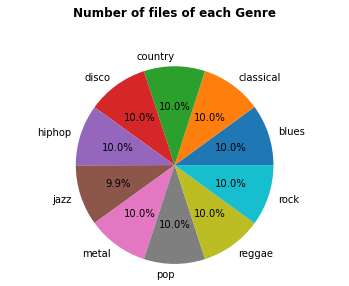

In [5]:
# Generates the Class distribution for the data

parent_dir_path =r"D:\data\genres_original"
labels = []
sizes = []

# Walk through all sub-directories
for dirpath, dirnames, filenames in os.walk(parent_dir_path):
    # Check if there are any files in the directory
    if len(filenames) > 0:
        # Get number of files in the directory
        num_files = len(filenames)

        # Add directory label and number of files to lists
        final = os.path.basename(dirpath)
        labels.append(f"{final}")
        sizes.append(num_files)

# Plot pie chart
plt.pie(sizes, labels=labels, autopct='%1.1f%%')
plt.axis('equal')

plt.title('Number of files of each Genre', pad = 40, fontweight='bold')
plt.show()



## Data Visualization

Next, we move on to visualize our data. As we are working with audio data, the best way to visualize our samples is in the form of a waveform. An example of what this looks like is provided below. 

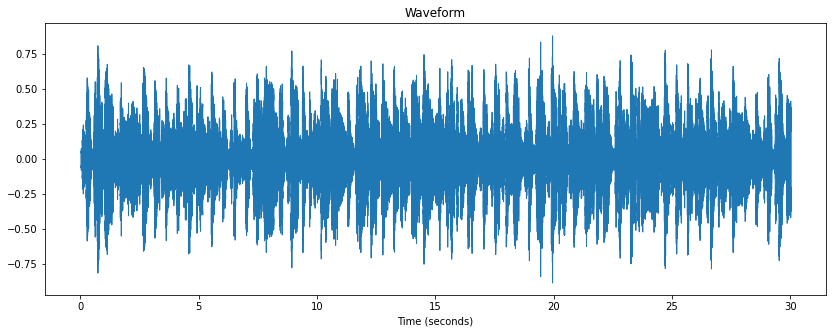

In [6]:
#Single File

filename = r"D:\data\genres_original\blues\blues.00000.wav"

y, sr = librosa.load(filename)


# Plot waveform
plt.figure(figsize=(14, 5))
librosa.display.waveshow(y, sr=sr)
plt.title('Waveform')
plt.xlabel('Time (seconds)')
plt.show()
ipd.Audio(y, rate=sr)

Finally, we try to see what the waveform of a sample from each of the genres looks like, allowing us to see any visual differences. After looking at the waveforms it is evident that the data is not easily distinguishable, meaning further pre-processing steps are required to extract features that would make each genre differentiable. 

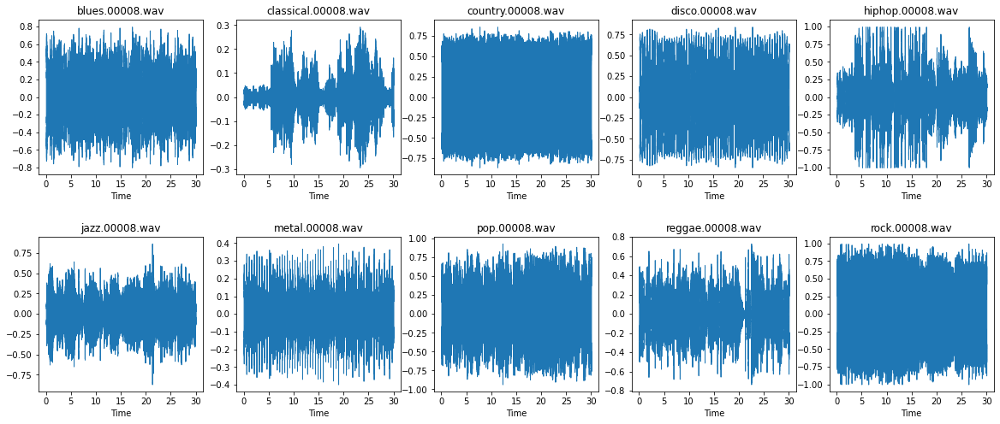

In [8]:
#Multiple Files

fig, axs = plt.subplots(nrows=2, ncols=5, figsize=(20, 8))

# Loop through each directory in the parent directory
subplot_index = 0
for dirpath, dirnames, filenames in os.walk(parent_dir_path):
    # Check if there are any files in the directory
    if len(filenames) > 0:
        # Choose the first file in the directory
        first_file = os.path.join(dirpath, filenames[8])
        y, sr = librosa.load(first_file)

        # Get the filename from the full path
        file_name = os.path.basename(first_file)

        # Plot waveform in a subplot
        row_index = subplot_index // 5
        col_index = subplot_index % 5
        axs[row_index, col_index].set_title(file_name)
        axs[row_index, col_index].set_xlabel('Time (seconds)')
        librosa.display.waveshow(y, sr=sr, ax=axs[row_index, col_index])

        # Increment the subplot index
        subplot_index += 1

# Adjust the spacing between subplots
plt.subplots_adjust(hspace=0.4)

# Show the figure
plt.show()

## Fourier Transform

The Fourier transform is a technique used to transform a signal from the time domain to the frequency domain. Meaning that it allows us to represent a signal as a sum of sinusoidal waves of different frequencies. This allows us to decompose the complex sounds of the sample and showcase how different frequencies are contributing to that. Furthermore, it allows for the compression of the sample as we are able to identify the most important frequency components, so we can compress the signal and save computation time while minimizing the loss of important information.


The formula for the Fourier Transform is given below:

$$F(\omega) = \int_{-\infty}^{\infty} f(t) e^{-i\omega t} dt$$

- $F(\omega)$ = It is the Fourier Transform of $f(t)$
<br>
- $i$ = Imaginary number
<br>
- $\omega$ = Angular frequency

The formula expresses the signal $f(t)$ as a sum of complex exponential functions of different frequencies. The exponential functions $e^{(-iωt)}$ represent sinusoidal waves with frequency $\omega$ , and the Fourier transform $F(\omega)$ gives us the amplitude and phase of each frequency component of the signal. Finally, the integral represents the weighted sum of all the frequency components: the wieght is given by the value of $f(t)$ at each point in time. The negative sign in the exponent is important is it ensures that frequency components with positive angular frequency corresponding to waves propogating forward, while those with a negative angular frequency correspond to waves propogating backwards.

Below we can see how the waveform is represented in a Spectrogram after we apply the Fourier Transform to the waveform. We can see that the signal has shifted from a time domain to a frequency domain.. This is a problem as now we are unable to see how the data changes through time because, ofcourse music data doesnt remain stationary, and we want to know how data changes through time. To solve this problem we can use the <b> Short Time Fourier Transform </b>.

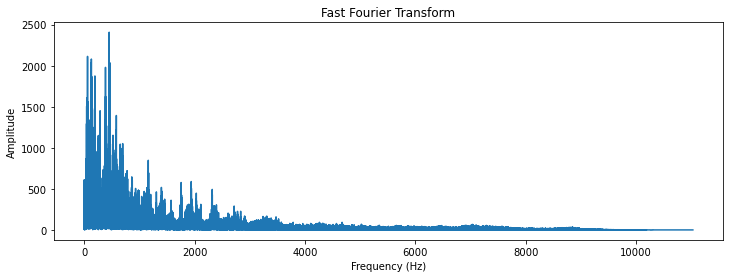

In [9]:
#Converting to a Fast Fourier Graph

y, sr = librosa.load(filename)

# Calculate the FFT
fft = np.fft.fft(y)

# calculate the magnitute
magnitude = np.abs(fft)

#calculate the frequency
frequency = np.linspace(0,sr,len(magnitude))

left_magnitude =magnitude[:int(len(frequency)/2)]
left_frequency = frequency[:int(len(frequency)/2)]
# Calculate the frequency bins
#freq_bins = np.fft.fftfreq(len(y), 1/sr)

# Plot the FFT
plt.figure(figsize=(12, 4))
plt.plot(left_frequency,left_magnitude)
#plt.plot(freq_bins[:len(freq_bins)//2], np.abs(fft)[:len(freq_bins)//2])
plt.xlabel('Frequency (Hz)')
plt.ylabel('Amplitude')
plt.title('Fast Fourier Transform')
plt.show()

## Spectrogram

The Short Time Fourier Transform is a technique which breaks down an audio sample into smaller sections, and applies the Fourier Transform on each one, allowing us to capture the time aspect of the sample along with the frequencies. We can imagine this process as placing a small frame over the audio sample and then moving if from one end to the other, and for each frame calculating the Fourier Transform. In the end the result of all the segments is stiched together to form a spectogram. The advantage of using a spectogram is that it provides a quick and easy way of visualizing the changes in frequency content of the signal over time, thus now we have both the time and frequency components. The spectogram has time on the x-axis, frequency on the y-axis, and the magnitude as the color intensity. 


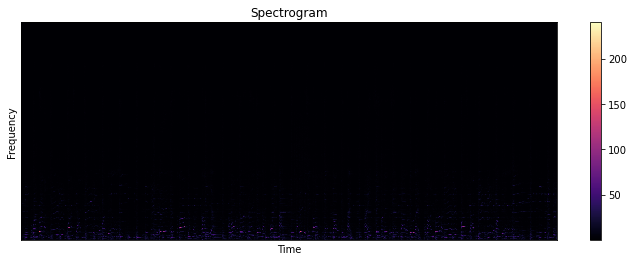

In [10]:
# Spectrogram (STFT)
hop_length = 512 # num. of samples - how much we slide the window to the right after each iteration
n_fft = 2048 # num. of samples for window

# Perform STFT
stft = librosa.stft(y, n_fft=n_fft, hop_length=hop_length)


# Calculate the Magnitude (abs values on complex numbers)
spectrogram = np.abs(stft)


# Plot the Spectrogram
plt.figure(figsize=(12, 4))
librosa.display.specshow(spectrogram, sr=sr, hop_length=hop_length)
plt.xlabel("Time")
plt.ylabel("Frequency")
plt.colorbar()
plt.title("Spectrogram")
plt.show()

The graph above might seem like it is wrong but in reality it is mostly dark because most of the frequency values are focused in the lower part of the spectrem. Thus we have to change the scaling of the spectogram to something that is reflective of how humans hear: humans percieve differences in low-frequency sounds more readily than differences in high-frequency sounds. Therefore, in order to more accurately represent the way that we hear sounds, it isuseful to apply a logarithmic scaling to the spectrogram. 

## Log-Scale

The Log-scale has the effect of compressing the higher-frequency regions of the spectrogram, making it easier to discern differences in the lower-frequency regions where we are more sensitive. By using a logarithmic scale, we can more accurately represent the perceived loudness of different frequencies in a signal. 

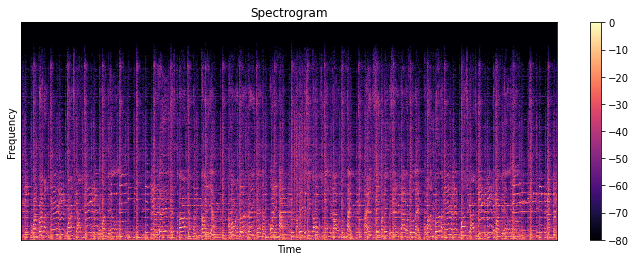

In [16]:
spec = np.abs(librosa.stft(y))
spec = librosa.amplitude_to_db(spec, ref=np.max)
# librosa.display.specshow(spec, sr=sr, x_axis='time', y_axis='log')
plt.figure(figsize=(12, 4))
librosa.display.specshow(spec, sr=sr, hop_length=hop_length)
plt.xlabel("Time")
plt.ylabel("Frequency")
plt.colorbar()
plt.title("Spectrogram")
plt.show()

## Mel-scale Filterbank

The mel-scale filterbanks are a set of filters that allows us to represent frequencies in a way that are more consisten with human perception: lower frequencies are better percieved than the higher ones. The filterbank consists of a series of overlapping triangular filters that are blaced on the mel-frequency doman. Each filter corresponds to a different frequency band and the filter output is scaled by taking the log of each band: lower frequencies get more prominent.

C:\Users\DELL\AppData\Roaming\Python\Python38\site-packages\librosa\display.py:1381: MatplotlibDeprecationWarning: SymmetricalLogScale got an unexpected keyword argument 'linthresh'. In the future this will raise TypeError
  scaler(mode, **kwargs)


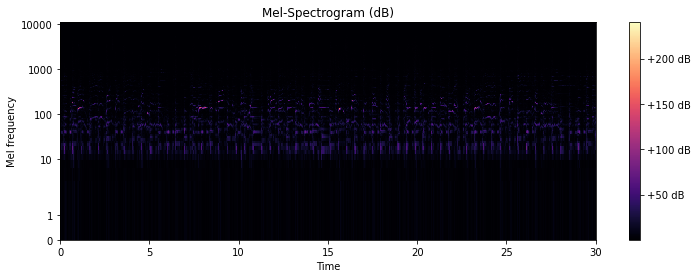

In [11]:

#Mel-Scale filterbank is generated
mel_filterbank = librosa.filters.mel(sr=sr, n_fft=n_fft)

#Mel-Scale filterbank is applied to the Spectrogram using matrix multiplication
mel_spectrogram = mel_filterbank.dot(spectrogram)

# Plot the Mel-Spectrogram in Decibels
plt.figure(figsize=(12, 4))
librosa.display.specshow(spectrogram, sr=sr, hop_length=hop_length, x_axis='time', y_axis='mel')
plt.xlabel("Time")
plt.ylabel("Mel frequency")
plt.colorbar(format="%+2.0f dB")
plt.title("Mel-Spectrogram (dB)")
plt.show()

## Mel Frequency Cepstrum Coefficients

After applying the Mel-scale filterbanks and taking the log of the output, we apply a Discrete Cosine transform to the spectrem to obtain a set of cepstral coeffecients. These coeffecients capture te information about the shape of the specctrum of the signal. 

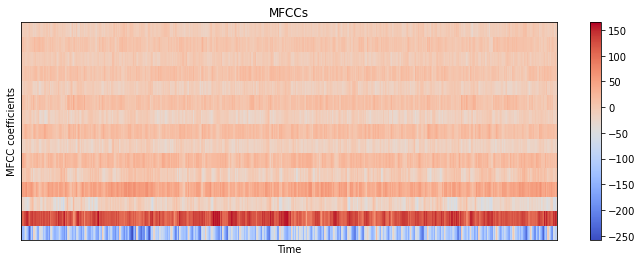

In [9]:
MFCCs = librosa.feature.mfcc(y=y, sr=sr, n_fft=n_fft, hop_length=hop_length, n_mfcc=16)
plt.figure(figsize=(12, 4))
librosa.display.specshow(MFCCs, sr=sr, hop_length=hop_length)
plt.xlabel("Time")
plt.ylabel("MFCC coefficients")
plt.colorbar()
plt.title("MFCCs")
plt.show()

## Splitting Data

This time, instead of extracting features and then splitting data, I decided to do the opposite. I first divided the raw data into training and testing folders, using an 80/20 ratio. This was done so that the training data can be augmented accordingly without it interfearing with the testing data. Another reason for doing so was the simplicity that it offered.
The main reason for splitting data is to ensure that the model in not simply memorizing the training data but rather learning to generalize to new unseen data. Having a testing set allows us to see how well the model is performing on unseen data.

In [10]:

# Set the parent directory, training directory, test directory, and split ratio
parent_dir = r"D:\data\genres_original"
train_dir = r'D:\data\train_directory'
test_dir = r'D:\data\test_directory'
split_ratio = 0.8

#Delete the directories if they exist to prevent duplication
if os.path.exists(train_dir):
    print("Training Directory already exists...deleting")
    shutil.rmtree(train_dir)
if os.path.exists(test_dir):
    print("Testing Directory already exists...deleting")
    shutil.rmtree(test_dir)


# Create the output directories if they don't exist
if not os.path.exists(train_dir):
    print("Training Directory doesnt exist...creating")
    os.makedirs(train_dir)
if not os.path.exists(test_dir):
    print("Testing Directory doesnt exist...creating")
    os.makedirs(test_dir)


# Go over the files in the parent directory
for i, (dirpath, dirnames, filenames) in enumerate(os.walk(parent_dir)):
    # If the directory is not the parent directory
    if dirpath is not parent_dir:
        
        # Get the label
        label = dirpath.split(os.path.sep)[-1]

        # Create the label directory in the training and test directories
        train_label_dir = os.path.join(train_dir, label)
        test_label_dir = os.path.join(test_dir, label)
        if not os.path.exists(train_label_dir):
            os.makedirs(train_label_dir)
        if not os.path.exists(test_label_dir):
            os.makedirs(test_label_dir)

        # Get the number of files in the directory
        num_files = len(filenames)

        # Get the number of files to be used for training
        num_train = int(num_files * split_ratio)

        # Shuffle the files
        random.shuffle(filenames)
        count_training = 0
        count_testing = 0

        #Go through all the files from the source directory and copy them into testing or training directory
        for f in filenames:
            
            
            if random.random() < split_ratio:
                source = os.path.join(dirpath, f)
                destination = os.path.join(train_label_dir, f)
                shutil.copyfile(source, destination)
                print("File added to training directory")
                count_training+=1
            else:
                source = os.path.join(dirpath, f)
                destination = os.path.join(test_label_dir, f)
                shutil.copyfile(source, destination)
                print("File added to testing directory")
                count_testing+=1
                
        print(filename, count_training,count_testing)
            



Training Directory already exists...deleting
Testing Directory already exists...deleting
Training Directory doesnt exist...creating
Testing Directory doesnt exist...creating
File added to testing directory
File added to training directory
File added to testing directory
File added to training directory
File added to training directory
File added to training directory
File added to testing directory
File added to training directory
File added to training directory
File added to training directory
File added to training directory
File added to training directory
File added to training directory
File added to testing directory
File added to training directory
File added to training directory
File added to training directory
File added to training directory
File added to training directory
File added to testing directory
File added to testing directory
File added to training directory
File added to training directory
File added to training directory
File added to training directory
File ad

File added to training directory
File added to training directory
File added to training directory
File added to training directory
File added to training directory
File added to training directory
File added to training directory
File added to training directory
File added to testing directory
File added to training directory
File added to training directory
File added to training directory
File added to testing directory
File added to testing directory
File added to training directory
File added to training directory
File added to training directory
File added to testing directory
File added to training directory
File added to training directory
File added to training directory
File added to training directory
File added to testing directory
File added to training directory
File added to training directory
File added to testing directory
File added to training directory
File added to testing directory
File added to training directory
File added to training directory
File added to tra

File added to testing directory
File added to training directory
File added to training directory
File added to training directory
D:\data\genres_original\blues\blues.00000.wav 81 19
File added to training directory
File added to testing directory
File added to training directory
File added to testing directory
File added to training directory
File added to training directory
File added to training directory
File added to training directory
File added to training directory
File added to testing directory
File added to training directory
File added to training directory
File added to testing directory
File added to training directory
File added to training directory
File added to training directory
File added to training directory
File added to training directory
File added to training directory
File added to training directory
File added to training directory
File added to testing directory
File added to training directory
File added to training directory
File added to training directo

File added to training directory
File added to training directory
File added to training directory
File added to training directory
File added to training directory
File added to training directory
File added to testing directory
File added to training directory
File added to training directory
File added to testing directory
File added to training directory
File added to training directory
File added to training directory
File added to training directory
File added to training directory
File added to training directory
File added to testing directory
File added to testing directory
File added to testing directory
File added to training directory
File added to training directory
File added to testing directory
File added to testing directory
File added to testing directory
File added to training directory
File added to testing directory
File added to testing directory
File added to training directory
File added to testing directory
File added to testing directory
File added to training

File added to training directory
File added to training directory
File added to training directory
File added to training directory
File added to training directory
D:\data\genres_original\blues\blues.00000.wav 80 20


## Data Augmentation

Data augmnetation is a technique that is used to increase the diversity and quantity of training data by creating new, but similar, data samples from the existing ones. This is done by introducing new features to the data, which in this case are the following:

- White Noise
- Time Stretch
- Pitch Scale
- Polarity Inversion
- Random Gain
- High Pass Filter
- Low Pass Filter
- Reverb

Data augmnetation is a necessary step as it helps overcome the poblem of overfitting, a case where the model becomes too accustomed to the training data, leading to poor geenralization on unseen data. By increasing the diversity of the data through uagmentation, the model is able to become robust and learn generalizable features, thus improving performance. Moreover, data augmentation also helps in increasing the size of the training data. One thing to be careful is to not introduce too much disstortion in the training data such as the augmented data is completley different from the original training data: the goal is to have slight variances to reproduce the real-world environmental effects.

#### Original Data

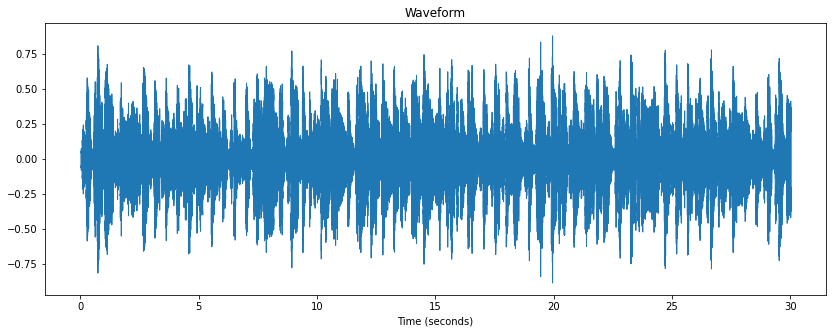

In [21]:

# Plot waveform
plt.figure(figsize=(14, 5))
librosa.display.waveshow(y, sr=sr)
plt.title('Waveform')
plt.xlabel('Time (seconds)')
plt.show()
ipd.Audio(y, rate=sr)

#### Adding White Noise

White noise refers to type of signal that is characterized by random fluctuations of amplitude that are equally distributed across all frequencies. Meaning that is contains all possible frequencies in equal amounts, with no dominant frequency. Mathematically, white noise can be represented as a sequence of independnet and identically distributed random variables, where each one represents a sample of signal at a given time. This ensures that we do not change the signal to a great extent from the original one.

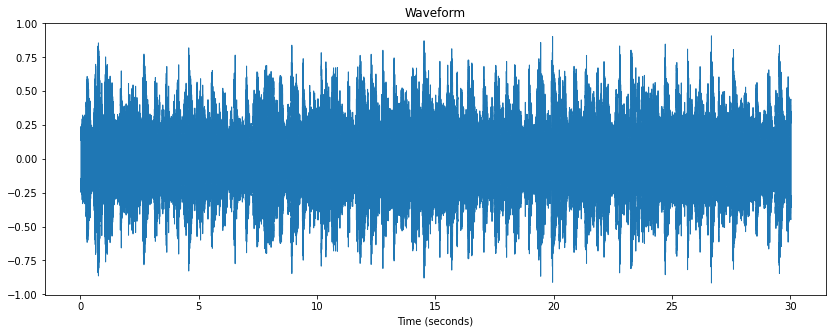

In [22]:
def add_white_noise(signal, noise_percentage_factor):
    noise = np.random.normal(0, signal.std(), signal.size)
    augmented_signal = signal + noise * noise_percentage_factor
    return augmented_signal

augmented_signal = add_white_noise(y, 0.5)
plt.figure(figsize=(14, 5))
librosa.display.waveshow(augmented_signal, sr=sr)
plt.title('Waveform')
plt.xlabel('Time (seconds)')
plt.show()
ipd.Audio(augmented_signal, rate=sr)


#### Adding Time stretch

Time stretching is a technique used to manipulate the speed and duration of an audio signal without changing its pitch and frequency content. This is done by manipulating the time axis of the audio wave, by either streaching it or compressing it, which preserving the spectral content of the signal.

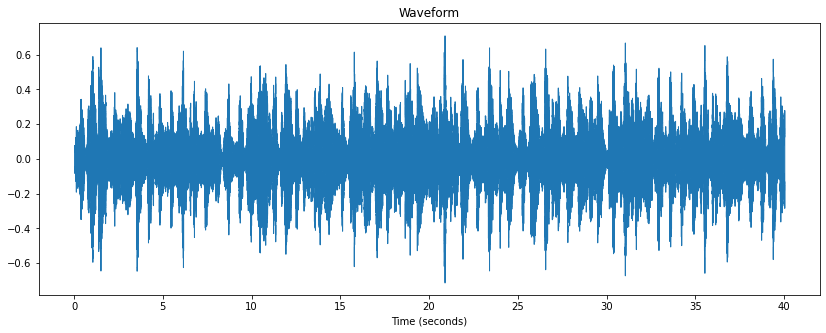

In [23]:
def time_stretch(signal, time_stretch_rate):
    return librosa.effects.time_stretch(signal, rate = time_stretch_rate)

augmented_signal = time_stretch(y, 0.75)
plt.figure(figsize=(14, 5))
librosa.display.waveshow(augmented_signal, sr=sr)
plt.title('Waveform')
plt.xlabel('Time (seconds)')
plt.show()
ipd.Audio(augmented_signal, rate=sr)


#### Pitch Scaling

Pitch scaling is a technique used to change the pitch of an audio signal without changing its duration or frequency content. This can be achieved by resampling the audio signal at a different rate. By chaning the sampling rate we can shift the pitch up and down while preserving its frequency content. 
In the code cell below, the n_steps parameter defines the number of steps per octave that the pitch should be shifter. So a step size of -4 means that we are shifting down by a major third, and a step size of +6 would mean that we are going up by a tritone.

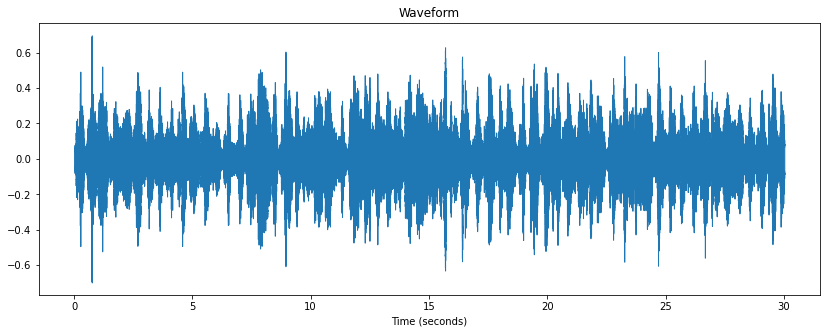

In [24]:
def pitch_scale(signal, sr, steps):
    return librosa.effects.pitch_shift(signal, sr=sr, n_steps = steps)


augmented_signal = pitch_scale(y, sr,-4)
plt.figure(figsize=(14, 5))
librosa.display.waveshow(augmented_signal, sr=sr)
plt.title('Waveform')
plt.xlabel('Time (seconds)')
plt.show()
ipd.Audio(augmented_signal, rate=sr)




#### Polarity Inversion

Polarity inversion is a technique used to invert the polarity of a signal, which reverses the direcction of the waveform. The mathematical principle behind polarity inversion is based on the concept of phase inversion. In an audio signal, the polarity of the waveform is related to the phase of the signal. By inverting the phase of the signal, we can invert the polarity of the waveform. Meaning that if we just multiply the signal by -1 we would invert it, as all the positive values would changed to negatives and all the negatives to positives.

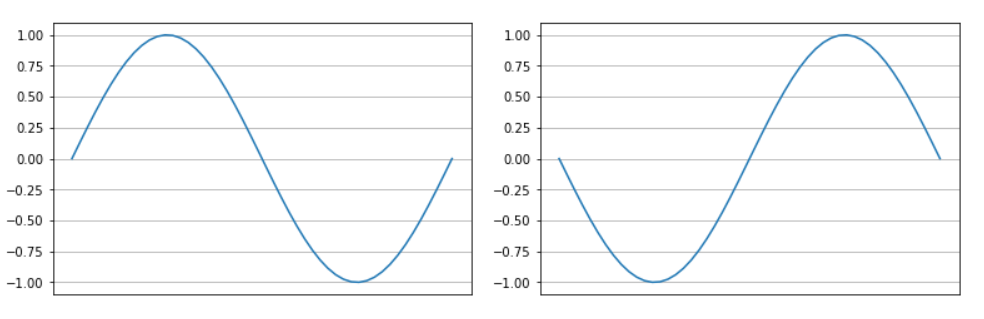

The figure above represents how polar opposite waves look like

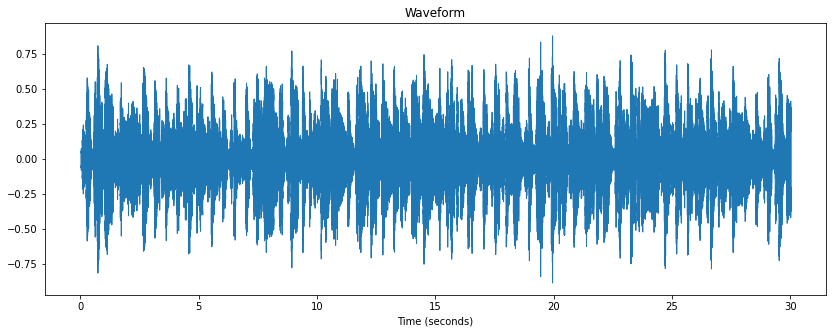

In [25]:
def invert_polarity(signal):
    return signal * -1

augmented_signal =  invert_polarity(y)
plt.figure(figsize=(14, 5))
librosa.display.waveshow(augmented_signal, sr=sr)
plt.title('Waveform')
plt.xlabel('Time (seconds)')
plt.show()
ipd.Audio(augmented_signal, rate=sr)


#### Testing Polarity Inversion

To test if the two waves are the polar opposites of each other, we can just add them together, and they would give us nothing because everything cancels out.

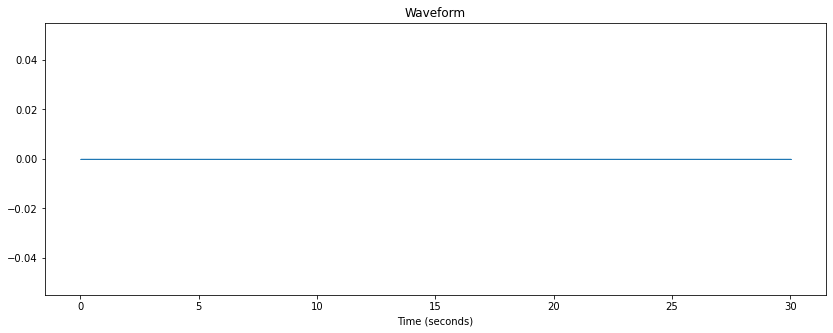

D:\conda\lib\site-packages\IPython\lib\display.py:172: RuntimeWarning: invalid value encountered in divide
  scaled = data / normalization_factor * 32767


In [26]:
augmented_signal =  invert_polarity(y)

Combined_signal = augmented_signal + y

plt.figure(figsize=(14, 5))
librosa.display.waveshow(Combined_signal, sr=sr)
plt.title('Waveform')
plt.xlabel('Time (seconds)')
plt.show()
ipd.Audio(Combined_signal, rate=sr)


#### Random Gain

Random gain is a technique used to add random variations to the gain or volume of an audio signal. the technique is based on the properties of random variables and probability distributions. The gain of the signal is modeled as a random variable with a certain distribution, and random values are drawn from this distribution to add variability to the signal.

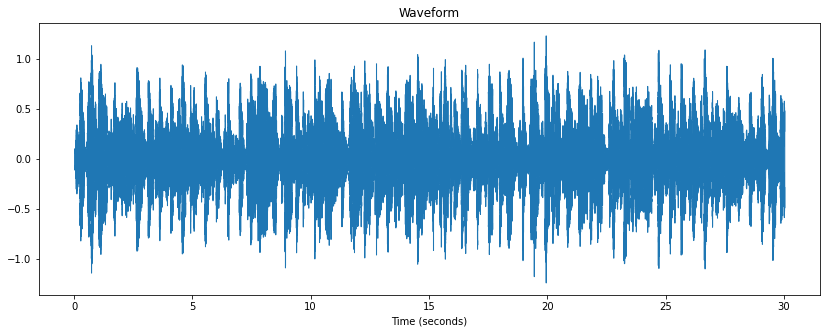

In [27]:
def random_gain(signal, min_factor, max_factor):
    gain_rate = random.uniform(min_factor, max_factor)
    augmented_signal = signal * gain_rate
    return augmented_signal

augmented_signal =  random_gain(y, 0.25, 1.75)
plt.figure(figsize=(14, 5))
librosa.display.waveshow(augmented_signal, sr=sr)
plt.title('Waveform')
plt.xlabel('Time (seconds)')
plt.show()
ipd.Audio(augmented_signal, rate=sr)


#### High Pass Filter

A high pass filter is a type of filter that attenuates or removes low-frequency components from an audio signal. Meaning that is allows high-frequency signals to pass through, while reducing the amplitude of lower-frequency signals. 


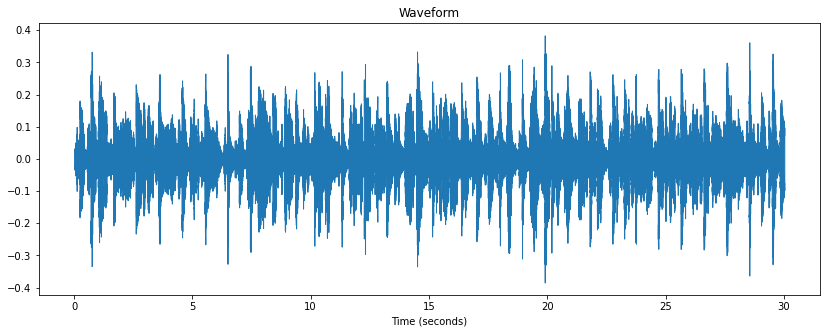

In [28]:
def high_pass_filter(signal,co_ef=0.97):
    return librosa.effects.preemphasis(y= signal, coef = co_ef)

augmented_signal =  high_pass_filter(y, co_ef = 0.9)
plt.figure(figsize=(14, 5))
librosa.display.waveshow(augmented_signal, sr=sr)
plt.title('Waveform')
plt.xlabel('Time (seconds)')
plt.show()
ipd.Audio(augmented_signal, rate=sr)

#### Low Pass Filter

A low pass filter is a type of filter that attenuates or removes high-frequency components from an audio signal. Meaning that is allows low-frequency signals to pass through, while reducing the amplitude of higher-frequency signals. 

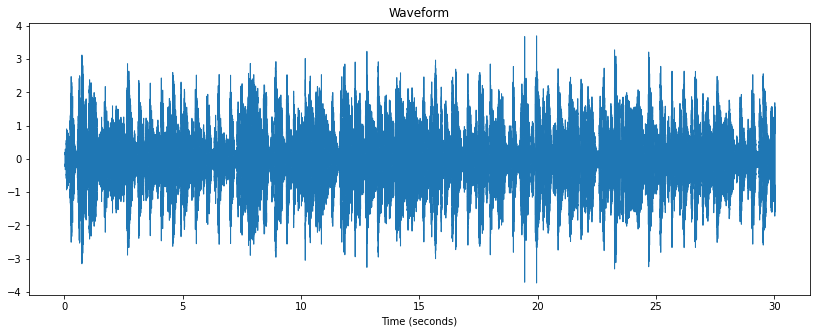

In [29]:
def low_pass_filter(signal,co_ef=0.97):
    return librosa.effects.deemphasis(y= signal, coef = co_ef)


augmented_signal =  low_pass_filter(y, co_ef = 0.8)
plt.figure(figsize=(14, 5))
librosa.display.waveshow(augmented_signal, sr=sr)
plt.title('Waveform')
plt.xlabel('Time (seconds)')
plt.show()
ipd.Audio(augmented_signal, rate=sr)

#### Adding Reverb

Reverb is a technique used to simulate the acoustic properties of a room or large space. It adds a sense of depth and space to the audio signal by creating multiple reflections of the sound within the room. It is based on the properties of sound propagation and acoustic reflections. The signal is convolved with an impulse response that models the acoustic properties of the room, which creates a realistic reverb effect.

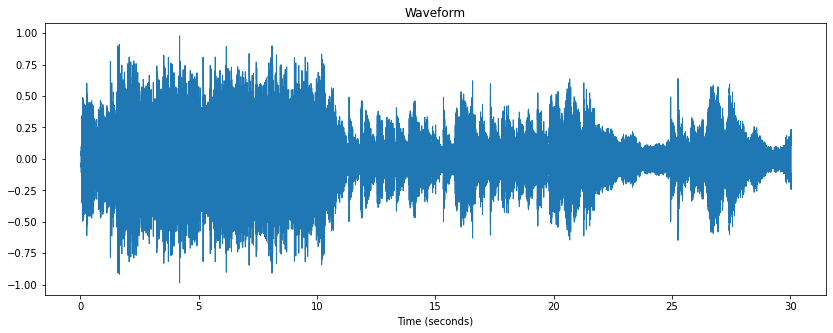

In [30]:
from pedalboard import Reverb
filename = r"D:\data\genres_original\rock\rock.00000.wav"

def reverb(y,sr,room_size):
    reverb = Reverb(room_size)
    return reverb(y,sr)
y, sr = librosa.load(filename)

# reverb = Reverb(room_size = 0.8)
# effected = reverb(y,sr)
effected = reverb(y,sr,0.8)
plt.figure(figsize=(14, 5))
librosa.display.waveshow(effected, sr=sr)
plt.title('Waveform')
plt.xlabel('Time (seconds)')
plt.show()
ipd.Audio(effected , rate=sr)



###  Batch Augmentation

In [31]:
def data_augmnet(audio, sampling_rate):
    
    """
    This function randomly selects the augmentation technique and applies it to the audio file
    parameters: 
        audio: The audio file
        numm_samples: The number of samples to be generated for each file
    returns:
        final: The list of augmented audio files
        
    """

    #Augmentation Techniques
    #Adding white noise to the original audio file
    noise_percentage_factor = random.uniform(0, 0.5)

    #Adding or subtracting 10 seconds from the original audio file
    time_stretch_rate = random.uniform(0.75, 1.5)

    #Adding or subtracting 4 semitones from the original audio file
    n_steps = random.randint(-4, 4)

    #Randomly selecting the gain factor
    min_factor = random.uniform(0.25, 0.75)
    max_factor = random.uniform(1.5, 2.0)
    
    #Randomly select room size
    room_size = random.uniform(0,1)

    augmentation_techniques = [add_white_noise, time_stretch, pitch_scale, invert_polarity, random_gain, low_pass_filter,
                              high_pass_filter,reverb]
    #Randomly select the augmentation technique
    augmentation_technique = random.choice(augmentation_techniques)

    #Apply the augmentation technique to the audio file
    if augmentation_technique == add_white_noise:
        augmented_signal = augmentation_technique(audio, noise_percentage_factor)
        print("White Noise Added")
        
    elif augmentation_technique == time_stretch:
        augmented_signal = augmentation_technique(audio, time_stretch_rate)
        print("Time Stretch Added")
    elif augmentation_technique == pitch_scale:
        augmented_signal = augmentation_technique(audio, sr, n_steps)
        print("Pitch Scale Added")
    elif augmentation_technique == invert_polarity:
        augmented_signal = augmentation_technique(audio)
        print("Polarity Inverted")
    elif augmentation_technique == random_gain:
        augmented_signal = augmentation_technique(audio, min_factor, max_factor)
        print("Random Gain Added")
    elif augmentation_technique == low_pass_filter:
        augmented_signal = augmentation_technique(audio)
        print("Low Pass Filter Applied")
    elif augmentation_technique == high_pass_filter:
        augmented_signal = augmentation_technique(audio)
        print("High Pass Filter Applied")
    elif augmentation_technique == reverb:
        augmented_signal = augmentation_technique(audio,sampling_rate,room_size)
        print("Reverb Applied")
            
    return augmented_signal
        


### Feature Extraction 

In [32]:
train_dir = r'D:\data\train_directory'
test_dir = r'D:\data\test_directory'

training_path = "training_dataset.json"
testing_path = "testing_dataset.json"

SAMPLE_RATE = sr
TRACK_DURATION = 30 # measured in seconds
SAMPLES_PER_TRACK = SAMPLE_RATE * TRACK_DURATION


In [48]:
def save_mfcc(dataset_path, json_path, num_mfcc=16, n_fft=2048, hop_length=512, num_segments=10,augmentation = True):
    """Extracts MFCCs from music dataset and saves them into a json file along with genre labels.
    
    inputs
        dataset_path: Path to where the data is located
        json_path: Path where the json file should be created
        num_mfcc: Number of mfcc values to be extracted
        n_fft: Number of samples in each STFT window
        hop_length: Distance window moves after each iteration
        num_segments: Sub-divisions of each sample
        
    Output:
        json_file: Json file with the following infromation:
            mapping = Genre names
            labels = Hot-encoding of genre names
            mfcc = MFCC values
    
        """

    # dictionary to store mapping, labels, and MFCCs
    data = {
        "mapping": [],
        "labels": [],
        "mfcc": []
    }

    samples_per_segment = int(SAMPLES_PER_TRACK / num_segments)
    num_mfcc_vectors_per_segment = math.ceil(samples_per_segment / hop_length)

    # loop through all genre sub-folder
    for i, (dirpath, dirnames, filenames) in enumerate(os.walk(dataset_path)):

        # ensure we're processing a genre sub-folder level
        if dirpath is not dataset_path:

            # save genre label (i.e., sub-folder name) in the mapping
            semantic_label = dirpath.split("/")[-1]
            data["mapping"].append(semantic_label)
            print("\nProcessing: {}".format(semantic_label))

            # process all audio files in genre sub-dir
            for f in filenames:

                    
                    
                # load audio file
                file_path = os.path.join(dirpath, f)
                signal, sample_rate = librosa.load(file_path, sr=SAMPLE_RATE)

                
                if augmentation == True:
                    aug_signal = data_augmnet(signal, sample_rate)
                    
                    
                # process all segments of audio file
                for d in range(num_segments):
                    

                    # calculate start and finish sample for current segment
                    start = samples_per_segment * d
                    finish = start + samples_per_segment

                    # extract mfcc
                    mfcc = librosa.feature.mfcc(y=signal[start:finish], sr=sample_rate, n_mfcc=num_mfcc, n_fft=n_fft, hop_length=hop_length)
                    mfcc = mfcc.T

                    # store only mfcc feature with expected number of vectors
                    if len(mfcc) == num_mfcc_vectors_per_segment:
                        data["mfcc"].append(mfcc.tolist())
                        data["labels"].append(i-1)
                        print("{}, segment:{}".format(file_path, d+1))
                    
                    # extract augmented mfcc
                    if augmentation == True:
                       
                        aug_mfcc = librosa.feature.mfcc(y=aug_signal[start:finish], sr=sample_rate, n_mfcc=num_mfcc, n_fft=n_fft, hop_length=hop_length)
                        aug_mfcc = aug_mfcc.T

                        # store only mfcc feature with expected number of vectors
                        if len(aug_mfcc) == num_mfcc_vectors_per_segment:
                            data["mfcc"].append(aug_mfcc.tolist())
                            data["labels"].append(i-1)
                            print("{}, segment:{}".format(file_path, d+1))
                        
                        
                        
    # save MFCCs to json file
    with open(json_path, "w") as fp:
        json.dump(data, fp, indent=4)

In [49]:
save_mfcc(train_dir,training_path)
print("Features extracted from Training data")
save_mfcc(test_dir,testing_path, augmentation = False)


Processing: D:\data\train_directory\blues
Reverb Applied
D:\data\train_directory\blues\blues.00000.wav, segment:1
D:\data\train_directory\blues\blues.00000.wav, segment:1
D:\data\train_directory\blues\blues.00000.wav, segment:2
D:\data\train_directory\blues\blues.00000.wav, segment:2
D:\data\train_directory\blues\blues.00000.wav, segment:3
D:\data\train_directory\blues\blues.00000.wav, segment:3
D:\data\train_directory\blues\blues.00000.wav, segment:4
D:\data\train_directory\blues\blues.00000.wav, segment:4
D:\data\train_directory\blues\blues.00000.wav, segment:5
D:\data\train_directory\blues\blues.00000.wav, segment:5
D:\data\train_directory\blues\blues.00000.wav, segment:6
D:\data\train_directory\blues\blues.00000.wav, segment:6
D:\data\train_directory\blues\blues.00000.wav, segment:7
D:\data\train_directory\blues\blues.00000.wav, segment:7
D:\data\train_directory\blues\blues.00000.wav, segment:8
D:\data\train_directory\blues\blues.00000.wav, segment:8
D:\data\train_directory\blues\

White Noise Added
D:\data\train_directory\blues\blues.00010.wav, segment:1
D:\data\train_directory\blues\blues.00010.wav, segment:1
D:\data\train_directory\blues\blues.00010.wav, segment:2
D:\data\train_directory\blues\blues.00010.wav, segment:2
D:\data\train_directory\blues\blues.00010.wav, segment:3
D:\data\train_directory\blues\blues.00010.wav, segment:3
D:\data\train_directory\blues\blues.00010.wav, segment:4
D:\data\train_directory\blues\blues.00010.wav, segment:4
D:\data\train_directory\blues\blues.00010.wav, segment:5
D:\data\train_directory\blues\blues.00010.wav, segment:5
D:\data\train_directory\blues\blues.00010.wav, segment:6
D:\data\train_directory\blues\blues.00010.wav, segment:6
D:\data\train_directory\blues\blues.00010.wav, segment:7
D:\data\train_directory\blues\blues.00010.wav, segment:7
D:\data\train_directory\blues\blues.00010.wav, segment:8
D:\data\train_directory\blues\blues.00010.wav, segment:8
D:\data\train_directory\blues\blues.00010.wav, segment:9
D:\data\train

Low Pass Filter Applied
D:\data\train_directory\blues\blues.00021.wav, segment:1
D:\data\train_directory\blues\blues.00021.wav, segment:1
D:\data\train_directory\blues\blues.00021.wav, segment:2
D:\data\train_directory\blues\blues.00021.wav, segment:2
D:\data\train_directory\blues\blues.00021.wav, segment:3
D:\data\train_directory\blues\blues.00021.wav, segment:3
D:\data\train_directory\blues\blues.00021.wav, segment:4
D:\data\train_directory\blues\blues.00021.wav, segment:4
D:\data\train_directory\blues\blues.00021.wav, segment:5
D:\data\train_directory\blues\blues.00021.wav, segment:5
D:\data\train_directory\blues\blues.00021.wav, segment:6
D:\data\train_directory\blues\blues.00021.wav, segment:6
D:\data\train_directory\blues\blues.00021.wav, segment:7
D:\data\train_directory\blues\blues.00021.wav, segment:7
D:\data\train_directory\blues\blues.00021.wav, segment:8
D:\data\train_directory\blues\blues.00021.wav, segment:8
D:\data\train_directory\blues\blues.00021.wav, segment:9
D:\data

D:\data\train_directory\blues\blues.00031.wav, segment:5
D:\data\train_directory\blues\blues.00031.wav, segment:6
D:\data\train_directory\blues\blues.00031.wav, segment:6
D:\data\train_directory\blues\blues.00031.wav, segment:7
D:\data\train_directory\blues\blues.00031.wav, segment:7
D:\data\train_directory\blues\blues.00031.wav, segment:8
D:\data\train_directory\blues\blues.00031.wav, segment:8
D:\data\train_directory\blues\blues.00031.wav, segment:9
D:\data\train_directory\blues\blues.00031.wav, segment:9
D:\data\train_directory\blues\blues.00031.wav, segment:10
D:\data\train_directory\blues\blues.00031.wav, segment:10
Reverb Applied
D:\data\train_directory\blues\blues.00033.wav, segment:1
D:\data\train_directory\blues\blues.00033.wav, segment:1
D:\data\train_directory\blues\blues.00033.wav, segment:2
D:\data\train_directory\blues\blues.00033.wav, segment:2
D:\data\train_directory\blues\blues.00033.wav, segment:3
D:\data\train_directory\blues\blues.00033.wav, segment:3
D:\data\train_

D:\data\train_directory\blues\blues.00047.wav, segment:1
D:\data\train_directory\blues\blues.00047.wav, segment:2
D:\data\train_directory\blues\blues.00047.wav, segment:2
D:\data\train_directory\blues\blues.00047.wav, segment:3
D:\data\train_directory\blues\blues.00047.wav, segment:3
D:\data\train_directory\blues\blues.00047.wav, segment:4
D:\data\train_directory\blues\blues.00047.wav, segment:4
D:\data\train_directory\blues\blues.00047.wav, segment:5
D:\data\train_directory\blues\blues.00047.wav, segment:5
D:\data\train_directory\blues\blues.00047.wav, segment:6
D:\data\train_directory\blues\blues.00047.wav, segment:6
D:\data\train_directory\blues\blues.00047.wav, segment:7
D:\data\train_directory\blues\blues.00047.wav, segment:7
D:\data\train_directory\blues\blues.00047.wav, segment:8
D:\data\train_directory\blues\blues.00047.wav, segment:8
D:\data\train_directory\blues\blues.00047.wav, segment:9
D:\data\train_directory\blues\blues.00047.wav, segment:9
D:\data\train_directory\blues\b

Low Pass Filter Applied
D:\data\train_directory\blues\blues.00057.wav, segment:1
D:\data\train_directory\blues\blues.00057.wav, segment:1
D:\data\train_directory\blues\blues.00057.wav, segment:2
D:\data\train_directory\blues\blues.00057.wav, segment:2
D:\data\train_directory\blues\blues.00057.wav, segment:3
D:\data\train_directory\blues\blues.00057.wav, segment:3
D:\data\train_directory\blues\blues.00057.wav, segment:4
D:\data\train_directory\blues\blues.00057.wav, segment:4
D:\data\train_directory\blues\blues.00057.wav, segment:5
D:\data\train_directory\blues\blues.00057.wav, segment:5
D:\data\train_directory\blues\blues.00057.wav, segment:6
D:\data\train_directory\blues\blues.00057.wav, segment:6
D:\data\train_directory\blues\blues.00057.wav, segment:7
D:\data\train_directory\blues\blues.00057.wav, segment:7
D:\data\train_directory\blues\blues.00057.wav, segment:8
D:\data\train_directory\blues\blues.00057.wav, segment:8
D:\data\train_directory\blues\blues.00057.wav, segment:9
D:\data

D:\data\train_directory\blues\blues.00065.wav, segment:2
D:\data\train_directory\blues\blues.00065.wav, segment:3
D:\data\train_directory\blues\blues.00065.wav, segment:3
D:\data\train_directory\blues\blues.00065.wav, segment:4
D:\data\train_directory\blues\blues.00065.wav, segment:4
D:\data\train_directory\blues\blues.00065.wav, segment:5
D:\data\train_directory\blues\blues.00065.wav, segment:5
D:\data\train_directory\blues\blues.00065.wav, segment:6
D:\data\train_directory\blues\blues.00065.wav, segment:6
D:\data\train_directory\blues\blues.00065.wav, segment:7
D:\data\train_directory\blues\blues.00065.wav, segment:7
D:\data\train_directory\blues\blues.00065.wav, segment:8
D:\data\train_directory\blues\blues.00065.wav, segment:8
D:\data\train_directory\blues\blues.00065.wav, segment:9
D:\data\train_directory\blues\blues.00065.wav, segment:9
D:\data\train_directory\blues\blues.00065.wav, segment:10
D:\data\train_directory\blues\blues.00065.wav, segment:10
White Noise Added
D:\data\tra

D:\data\train_directory\blues\blues.00073.wav, segment:1
D:\data\train_directory\blues\blues.00073.wav, segment:1
D:\data\train_directory\blues\blues.00073.wav, segment:2
D:\data\train_directory\blues\blues.00073.wav, segment:2
D:\data\train_directory\blues\blues.00073.wav, segment:3
D:\data\train_directory\blues\blues.00073.wav, segment:3
D:\data\train_directory\blues\blues.00073.wav, segment:4
D:\data\train_directory\blues\blues.00073.wav, segment:4
D:\data\train_directory\blues\blues.00073.wav, segment:5
D:\data\train_directory\blues\blues.00073.wav, segment:5
D:\data\train_directory\blues\blues.00073.wav, segment:6
D:\data\train_directory\blues\blues.00073.wav, segment:6
D:\data\train_directory\blues\blues.00073.wav, segment:7
D:\data\train_directory\blues\blues.00073.wav, segment:7
D:\data\train_directory\blues\blues.00073.wav, segment:8
D:\data\train_directory\blues\blues.00073.wav, segment:8
D:\data\train_directory\blues\blues.00073.wav, segment:9
D:\data\train_directory\blues\b

Time Stretch Added
D:\data\train_directory\blues\blues.00082.wav, segment:1
D:\data\train_directory\blues\blues.00082.wav, segment:1
D:\data\train_directory\blues\blues.00082.wav, segment:2
D:\data\train_directory\blues\blues.00082.wav, segment:2
D:\data\train_directory\blues\blues.00082.wav, segment:3
D:\data\train_directory\blues\blues.00082.wav, segment:3
D:\data\train_directory\blues\blues.00082.wav, segment:4
D:\data\train_directory\blues\blues.00082.wav, segment:4
D:\data\train_directory\blues\blues.00082.wav, segment:5
D:\data\train_directory\blues\blues.00082.wav, segment:5
D:\data\train_directory\blues\blues.00082.wav, segment:6
D:\data\train_directory\blues\blues.00082.wav, segment:6
D:\data\train_directory\blues\blues.00082.wav, segment:7
D:\data\train_directory\blues\blues.00082.wav, segment:8
D:\data\train_directory\blues\blues.00082.wav, segment:9
D:\data\train_directory\blues\blues.00082.wav, segment:10
White Noise Added
D:\data\train_directory\blues\blues.00083.wav, seg

D:\data\train_directory\blues\blues.00094.wav, segment:2
D:\data\train_directory\blues\blues.00094.wav, segment:2
D:\data\train_directory\blues\blues.00094.wav, segment:3
D:\data\train_directory\blues\blues.00094.wav, segment:3
D:\data\train_directory\blues\blues.00094.wav, segment:4
D:\data\train_directory\blues\blues.00094.wav, segment:4
D:\data\train_directory\blues\blues.00094.wav, segment:5
D:\data\train_directory\blues\blues.00094.wav, segment:5
D:\data\train_directory\blues\blues.00094.wav, segment:6
D:\data\train_directory\blues\blues.00094.wav, segment:6
D:\data\train_directory\blues\blues.00094.wav, segment:7
D:\data\train_directory\blues\blues.00094.wav, segment:7
D:\data\train_directory\blues\blues.00094.wav, segment:8
D:\data\train_directory\blues\blues.00094.wav, segment:8
D:\data\train_directory\blues\blues.00094.wav, segment:9
D:\data\train_directory\blues\blues.00094.wav, segment:9
D:\data\train_directory\blues\blues.00094.wav, segment:10
D:\data\train_directory\blues\

D:\data\train_directory\classical\classical.00003.wav, segment:2
D:\data\train_directory\classical\classical.00003.wav, segment:3
D:\data\train_directory\classical\classical.00003.wav, segment:3
D:\data\train_directory\classical\classical.00003.wav, segment:4
D:\data\train_directory\classical\classical.00003.wav, segment:4
D:\data\train_directory\classical\classical.00003.wav, segment:5
D:\data\train_directory\classical\classical.00003.wav, segment:5
D:\data\train_directory\classical\classical.00003.wav, segment:6
D:\data\train_directory\classical\classical.00003.wav, segment:6
D:\data\train_directory\classical\classical.00003.wav, segment:7
D:\data\train_directory\classical\classical.00003.wav, segment:7
D:\data\train_directory\classical\classical.00003.wav, segment:8
D:\data\train_directory\classical\classical.00003.wav, segment:8
D:\data\train_directory\classical\classical.00003.wav, segment:9
D:\data\train_directory\classical\classical.00003.wav, segment:9
D:\data\train_directory\c

D:\data\train_directory\classical\classical.00010.wav, segment:2
D:\data\train_directory\classical\classical.00010.wav, segment:3
D:\data\train_directory\classical\classical.00010.wav, segment:3
D:\data\train_directory\classical\classical.00010.wav, segment:4
D:\data\train_directory\classical\classical.00010.wav, segment:4
D:\data\train_directory\classical\classical.00010.wav, segment:5
D:\data\train_directory\classical\classical.00010.wav, segment:5
D:\data\train_directory\classical\classical.00010.wav, segment:6
D:\data\train_directory\classical\classical.00010.wav, segment:6
D:\data\train_directory\classical\classical.00010.wav, segment:7
D:\data\train_directory\classical\classical.00010.wav, segment:7
D:\data\train_directory\classical\classical.00010.wav, segment:8
D:\data\train_directory\classical\classical.00010.wav, segment:8
D:\data\train_directory\classical\classical.00010.wav, segment:9
D:\data\train_directory\classical\classical.00010.wav, segment:9
D:\data\train_directory\c

White Noise Added
D:\data\train_directory\classical\classical.00018.wav, segment:1
D:\data\train_directory\classical\classical.00018.wav, segment:1
D:\data\train_directory\classical\classical.00018.wav, segment:2
D:\data\train_directory\classical\classical.00018.wav, segment:2
D:\data\train_directory\classical\classical.00018.wav, segment:3
D:\data\train_directory\classical\classical.00018.wav, segment:3
D:\data\train_directory\classical\classical.00018.wav, segment:4
D:\data\train_directory\classical\classical.00018.wav, segment:4
D:\data\train_directory\classical\classical.00018.wav, segment:5
D:\data\train_directory\classical\classical.00018.wav, segment:5
D:\data\train_directory\classical\classical.00018.wav, segment:6
D:\data\train_directory\classical\classical.00018.wav, segment:6
D:\data\train_directory\classical\classical.00018.wav, segment:7
D:\data\train_directory\classical\classical.00018.wav, segment:7
D:\data\train_directory\classical\classical.00018.wav, segment:8
D:\data

D:\data\train_directory\classical\classical.00030.wav, segment:1
D:\data\train_directory\classical\classical.00030.wav, segment:2
D:\data\train_directory\classical\classical.00030.wav, segment:2
D:\data\train_directory\classical\classical.00030.wav, segment:3
D:\data\train_directory\classical\classical.00030.wav, segment:3
D:\data\train_directory\classical\classical.00030.wav, segment:4
D:\data\train_directory\classical\classical.00030.wav, segment:4
D:\data\train_directory\classical\classical.00030.wav, segment:5
D:\data\train_directory\classical\classical.00030.wav, segment:5
D:\data\train_directory\classical\classical.00030.wav, segment:6
D:\data\train_directory\classical\classical.00030.wav, segment:6
D:\data\train_directory\classical\classical.00030.wav, segment:7
D:\data\train_directory\classical\classical.00030.wav, segment:7
D:\data\train_directory\classical\classical.00030.wav, segment:8
D:\data\train_directory\classical\classical.00030.wav, segment:8
D:\data\train_directory\c

D:\data\train_directory\classical\classical.00037.wav, segment:2
D:\data\train_directory\classical\classical.00037.wav, segment:2
D:\data\train_directory\classical\classical.00037.wav, segment:3
D:\data\train_directory\classical\classical.00037.wav, segment:3
D:\data\train_directory\classical\classical.00037.wav, segment:4
D:\data\train_directory\classical\classical.00037.wav, segment:4
D:\data\train_directory\classical\classical.00037.wav, segment:5
D:\data\train_directory\classical\classical.00037.wav, segment:5
D:\data\train_directory\classical\classical.00037.wav, segment:6
D:\data\train_directory\classical\classical.00037.wav, segment:6
D:\data\train_directory\classical\classical.00037.wav, segment:7
D:\data\train_directory\classical\classical.00037.wav, segment:7
D:\data\train_directory\classical\classical.00037.wav, segment:8
D:\data\train_directory\classical\classical.00037.wav, segment:8
D:\data\train_directory\classical\classical.00037.wav, segment:9
D:\data\train_directory\c

Time Stretch Added
D:\data\train_directory\classical\classical.00045.wav, segment:1
D:\data\train_directory\classical\classical.00045.wav, segment:1
D:\data\train_directory\classical\classical.00045.wav, segment:2
D:\data\train_directory\classical\classical.00045.wav, segment:2
D:\data\train_directory\classical\classical.00045.wav, segment:3
D:\data\train_directory\classical\classical.00045.wav, segment:3
D:\data\train_directory\classical\classical.00045.wav, segment:4
D:\data\train_directory\classical\classical.00045.wav, segment:4
D:\data\train_directory\classical\classical.00045.wav, segment:5
D:\data\train_directory\classical\classical.00045.wav, segment:5
D:\data\train_directory\classical\classical.00045.wav, segment:6
D:\data\train_directory\classical\classical.00045.wav, segment:6
D:\data\train_directory\classical\classical.00045.wav, segment:7
D:\data\train_directory\classical\classical.00045.wav, segment:7
D:\data\train_directory\classical\classical.00045.wav, segment:8
D:\dat

Time Stretch Added
D:\data\train_directory\classical\classical.00054.wav, segment:1
D:\data\train_directory\classical\classical.00054.wav, segment:1
D:\data\train_directory\classical\classical.00054.wav, segment:2
D:\data\train_directory\classical\classical.00054.wav, segment:2
D:\data\train_directory\classical\classical.00054.wav, segment:3
D:\data\train_directory\classical\classical.00054.wav, segment:3
D:\data\train_directory\classical\classical.00054.wav, segment:4
D:\data\train_directory\classical\classical.00054.wav, segment:4
D:\data\train_directory\classical\classical.00054.wav, segment:5
D:\data\train_directory\classical\classical.00054.wav, segment:5
D:\data\train_directory\classical\classical.00054.wav, segment:6
D:\data\train_directory\classical\classical.00054.wav, segment:6
D:\data\train_directory\classical\classical.00054.wav, segment:7
D:\data\train_directory\classical\classical.00054.wav, segment:7
D:\data\train_directory\classical\classical.00054.wav, segment:8
D:\dat

D:\data\train_directory\classical\classical.00061.wav, segment:2
D:\data\train_directory\classical\classical.00061.wav, segment:2
D:\data\train_directory\classical\classical.00061.wav, segment:3
D:\data\train_directory\classical\classical.00061.wav, segment:3
D:\data\train_directory\classical\classical.00061.wav, segment:4
D:\data\train_directory\classical\classical.00061.wav, segment:4
D:\data\train_directory\classical\classical.00061.wav, segment:5
D:\data\train_directory\classical\classical.00061.wav, segment:5
D:\data\train_directory\classical\classical.00061.wav, segment:6
D:\data\train_directory\classical\classical.00061.wav, segment:6
D:\data\train_directory\classical\classical.00061.wav, segment:7
D:\data\train_directory\classical\classical.00061.wav, segment:7
D:\data\train_directory\classical\classical.00061.wav, segment:8
D:\data\train_directory\classical\classical.00061.wav, segment:8
D:\data\train_directory\classical\classical.00061.wav, segment:9
D:\data\train_directory\c

D:\data\train_directory\classical\classical.00068.wav, segment:1
D:\data\train_directory\classical\classical.00068.wav, segment:1
D:\data\train_directory\classical\classical.00068.wav, segment:2
D:\data\train_directory\classical\classical.00068.wav, segment:2
D:\data\train_directory\classical\classical.00068.wav, segment:3
D:\data\train_directory\classical\classical.00068.wav, segment:3
D:\data\train_directory\classical\classical.00068.wav, segment:4
D:\data\train_directory\classical\classical.00068.wav, segment:4
D:\data\train_directory\classical\classical.00068.wav, segment:5
D:\data\train_directory\classical\classical.00068.wav, segment:5
D:\data\train_directory\classical\classical.00068.wav, segment:6
D:\data\train_directory\classical\classical.00068.wav, segment:6
D:\data\train_directory\classical\classical.00068.wav, segment:7
D:\data\train_directory\classical\classical.00068.wav, segment:7
D:\data\train_directory\classical\classical.00068.wav, segment:8
D:\data\train_directory\c

Pitch Scale Added
D:\data\train_directory\classical\classical.00077.wav, segment:1
D:\data\train_directory\classical\classical.00077.wav, segment:1
D:\data\train_directory\classical\classical.00077.wav, segment:2
D:\data\train_directory\classical\classical.00077.wav, segment:2
D:\data\train_directory\classical\classical.00077.wav, segment:3
D:\data\train_directory\classical\classical.00077.wav, segment:3
D:\data\train_directory\classical\classical.00077.wav, segment:4
D:\data\train_directory\classical\classical.00077.wav, segment:4
D:\data\train_directory\classical\classical.00077.wav, segment:5
D:\data\train_directory\classical\classical.00077.wav, segment:5
D:\data\train_directory\classical\classical.00077.wav, segment:6
D:\data\train_directory\classical\classical.00077.wav, segment:6
D:\data\train_directory\classical\classical.00077.wav, segment:7
D:\data\train_directory\classical\classical.00077.wav, segment:7
D:\data\train_directory\classical\classical.00077.wav, segment:8
D:\data

D:\data\train_directory\classical\classical.00085.wav, segment:1
D:\data\train_directory\classical\classical.00085.wav, segment:1
D:\data\train_directory\classical\classical.00085.wav, segment:2
D:\data\train_directory\classical\classical.00085.wav, segment:2
D:\data\train_directory\classical\classical.00085.wav, segment:3
D:\data\train_directory\classical\classical.00085.wav, segment:3
D:\data\train_directory\classical\classical.00085.wav, segment:4
D:\data\train_directory\classical\classical.00085.wav, segment:4
D:\data\train_directory\classical\classical.00085.wav, segment:5
D:\data\train_directory\classical\classical.00085.wav, segment:5
D:\data\train_directory\classical\classical.00085.wav, segment:6
D:\data\train_directory\classical\classical.00085.wav, segment:6
D:\data\train_directory\classical\classical.00085.wav, segment:7
D:\data\train_directory\classical\classical.00085.wav, segment:7
D:\data\train_directory\classical\classical.00085.wav, segment:8
D:\data\train_directory\c

D:\data\train_directory\classical\classical.00093.wav, segment:1
D:\data\train_directory\classical\classical.00093.wav, segment:1
D:\data\train_directory\classical\classical.00093.wav, segment:2
D:\data\train_directory\classical\classical.00093.wav, segment:2
D:\data\train_directory\classical\classical.00093.wav, segment:3
D:\data\train_directory\classical\classical.00093.wav, segment:3
D:\data\train_directory\classical\classical.00093.wav, segment:4
D:\data\train_directory\classical\classical.00093.wav, segment:4
D:\data\train_directory\classical\classical.00093.wav, segment:5
D:\data\train_directory\classical\classical.00093.wav, segment:5
D:\data\train_directory\classical\classical.00093.wav, segment:6
D:\data\train_directory\classical\classical.00093.wav, segment:6
D:\data\train_directory\classical\classical.00093.wav, segment:7
D:\data\train_directory\classical\classical.00093.wav, segment:7
D:\data\train_directory\classical\classical.00093.wav, segment:8
D:\data\train_directory\c

Low Pass Filter Applied
D:\data\train_directory\country\country.00000.wav, segment:1
D:\data\train_directory\country\country.00000.wav, segment:1
D:\data\train_directory\country\country.00000.wav, segment:2
D:\data\train_directory\country\country.00000.wav, segment:2
D:\data\train_directory\country\country.00000.wav, segment:3
D:\data\train_directory\country\country.00000.wav, segment:3
D:\data\train_directory\country\country.00000.wav, segment:4
D:\data\train_directory\country\country.00000.wav, segment:4
D:\data\train_directory\country\country.00000.wav, segment:5
D:\data\train_directory\country\country.00000.wav, segment:5
D:\data\train_directory\country\country.00000.wav, segment:6
D:\data\train_directory\country\country.00000.wav, segment:6
D:\data\train_directory\country\country.00000.wav, segment:7
D:\data\train_directory\country\country.00000.wav, segment:7
D:\data\train_directory\country\country.00000.wav, segment:8
D:\data\train_directory\country\country.00000.wav, segment:8


C:\Users\DELL\AppData\Roaming\Python\Python38\site-packages\librosa\core\spectrum.py:256: UserWarning: n_fft=2048 is too large for input signal of length=133
  warnings.warn(


D:\data\train_directory\country\country.00003.wav, segment:1
D:\data\train_directory\country\country.00003.wav, segment:1
D:\data\train_directory\country\country.00003.wav, segment:2
D:\data\train_directory\country\country.00003.wav, segment:2
D:\data\train_directory\country\country.00003.wav, segment:3
D:\data\train_directory\country\country.00003.wav, segment:3
D:\data\train_directory\country\country.00003.wav, segment:4
D:\data\train_directory\country\country.00003.wav, segment:4
D:\data\train_directory\country\country.00003.wav, segment:5
D:\data\train_directory\country\country.00003.wav, segment:5
D:\data\train_directory\country\country.00003.wav, segment:6
D:\data\train_directory\country\country.00003.wav, segment:6
D:\data\train_directory\country\country.00003.wav, segment:7
D:\data\train_directory\country\country.00003.wav, segment:7
D:\data\train_directory\country\country.00003.wav, segment:8
D:\data\train_directory\country\country.00003.wav, segment:8
D:\data\train_directory\

Low Pass Filter Applied
D:\data\train_directory\country\country.00013.wav, segment:1
D:\data\train_directory\country\country.00013.wav, segment:1
D:\data\train_directory\country\country.00013.wav, segment:2
D:\data\train_directory\country\country.00013.wav, segment:2
D:\data\train_directory\country\country.00013.wav, segment:3
D:\data\train_directory\country\country.00013.wav, segment:3
D:\data\train_directory\country\country.00013.wav, segment:4
D:\data\train_directory\country\country.00013.wav, segment:4
D:\data\train_directory\country\country.00013.wav, segment:5
D:\data\train_directory\country\country.00013.wav, segment:5
D:\data\train_directory\country\country.00013.wav, segment:6
D:\data\train_directory\country\country.00013.wav, segment:6
D:\data\train_directory\country\country.00013.wav, segment:7
D:\data\train_directory\country\country.00013.wav, segment:7
D:\data\train_directory\country\country.00013.wav, segment:8
D:\data\train_directory\country\country.00013.wav, segment:8


Random Gain Added
D:\data\train_directory\country\country.00021.wav, segment:1
D:\data\train_directory\country\country.00021.wav, segment:1
D:\data\train_directory\country\country.00021.wav, segment:2
D:\data\train_directory\country\country.00021.wav, segment:2
D:\data\train_directory\country\country.00021.wav, segment:3
D:\data\train_directory\country\country.00021.wav, segment:3
D:\data\train_directory\country\country.00021.wav, segment:4
D:\data\train_directory\country\country.00021.wav, segment:4
D:\data\train_directory\country\country.00021.wav, segment:5
D:\data\train_directory\country\country.00021.wav, segment:5
D:\data\train_directory\country\country.00021.wav, segment:6
D:\data\train_directory\country\country.00021.wav, segment:6
D:\data\train_directory\country\country.00021.wav, segment:7
D:\data\train_directory\country\country.00021.wav, segment:7
D:\data\train_directory\country\country.00021.wav, segment:8
D:\data\train_directory\country\country.00021.wav, segment:8
D:\dat

Reverb Applied
D:\data\train_directory\country\country.00030.wav, segment:1
D:\data\train_directory\country\country.00030.wav, segment:1
D:\data\train_directory\country\country.00030.wav, segment:2
D:\data\train_directory\country\country.00030.wav, segment:2
D:\data\train_directory\country\country.00030.wav, segment:3
D:\data\train_directory\country\country.00030.wav, segment:3
D:\data\train_directory\country\country.00030.wav, segment:4
D:\data\train_directory\country\country.00030.wav, segment:4
D:\data\train_directory\country\country.00030.wav, segment:5
D:\data\train_directory\country\country.00030.wav, segment:5
D:\data\train_directory\country\country.00030.wav, segment:6
D:\data\train_directory\country\country.00030.wav, segment:6
D:\data\train_directory\country\country.00030.wav, segment:7
D:\data\train_directory\country\country.00030.wav, segment:7
D:\data\train_directory\country\country.00030.wav, segment:8
D:\data\train_directory\country\country.00030.wav, segment:8
D:\data\t

Time Stretch Added
D:\data\train_directory\country\country.00038.wav, segment:1
D:\data\train_directory\country\country.00038.wav, segment:1
D:\data\train_directory\country\country.00038.wav, segment:2
D:\data\train_directory\country\country.00038.wav, segment:2
D:\data\train_directory\country\country.00038.wav, segment:3
D:\data\train_directory\country\country.00038.wav, segment:3
D:\data\train_directory\country\country.00038.wav, segment:4
D:\data\train_directory\country\country.00038.wav, segment:4
D:\data\train_directory\country\country.00038.wav, segment:5
D:\data\train_directory\country\country.00038.wav, segment:5
D:\data\train_directory\country\country.00038.wav, segment:6
D:\data\train_directory\country\country.00038.wav, segment:6
D:\data\train_directory\country\country.00038.wav, segment:7
D:\data\train_directory\country\country.00038.wav, segment:7
D:\data\train_directory\country\country.00038.wav, segment:8
D:\data\train_directory\country\country.00038.wav, segment:9
D:\da

D:\data\train_directory\country\country.00046.wav, segment:2
D:\data\train_directory\country\country.00046.wav, segment:3
D:\data\train_directory\country\country.00046.wav, segment:3
D:\data\train_directory\country\country.00046.wav, segment:4
D:\data\train_directory\country\country.00046.wav, segment:4
D:\data\train_directory\country\country.00046.wav, segment:5
D:\data\train_directory\country\country.00046.wav, segment:5
D:\data\train_directory\country\country.00046.wav, segment:6
D:\data\train_directory\country\country.00046.wav, segment:6
D:\data\train_directory\country\country.00046.wav, segment:7
D:\data\train_directory\country\country.00046.wav, segment:7
D:\data\train_directory\country\country.00046.wav, segment:8
D:\data\train_directory\country\country.00046.wav, segment:8
D:\data\train_directory\country\country.00046.wav, segment:9
D:\data\train_directory\country\country.00046.wav, segment:9
D:\data\train_directory\country\country.00046.wav, segment:10
D:\data\train_directory

Time Stretch Added
D:\data\train_directory\country\country.00055.wav, segment:1
D:\data\train_directory\country\country.00055.wav, segment:1
D:\data\train_directory\country\country.00055.wav, segment:2
D:\data\train_directory\country\country.00055.wav, segment:2
D:\data\train_directory\country\country.00055.wav, segment:3
D:\data\train_directory\country\country.00055.wav, segment:3
D:\data\train_directory\country\country.00055.wav, segment:4
D:\data\train_directory\country\country.00055.wav, segment:4
D:\data\train_directory\country\country.00055.wav, segment:5
D:\data\train_directory\country\country.00055.wav, segment:5
D:\data\train_directory\country\country.00055.wav, segment:6
D:\data\train_directory\country\country.00055.wav, segment:6
D:\data\train_directory\country\country.00055.wav, segment:7
D:\data\train_directory\country\country.00055.wav, segment:7
D:\data\train_directory\country\country.00055.wav, segment:8
D:\data\train_directory\country\country.00055.wav, segment:8
D:\da

High Pass Filter Applied
D:\data\train_directory\country\country.00062.wav, segment:1
D:\data\train_directory\country\country.00062.wav, segment:1
D:\data\train_directory\country\country.00062.wav, segment:2
D:\data\train_directory\country\country.00062.wav, segment:2
D:\data\train_directory\country\country.00062.wav, segment:3
D:\data\train_directory\country\country.00062.wav, segment:3
D:\data\train_directory\country\country.00062.wav, segment:4
D:\data\train_directory\country\country.00062.wav, segment:4
D:\data\train_directory\country\country.00062.wav, segment:5
D:\data\train_directory\country\country.00062.wav, segment:5
D:\data\train_directory\country\country.00062.wav, segment:6
D:\data\train_directory\country\country.00062.wav, segment:6
D:\data\train_directory\country\country.00062.wav, segment:7
D:\data\train_directory\country\country.00062.wav, segment:7
D:\data\train_directory\country\country.00062.wav, segment:8
D:\data\train_directory\country\country.00062.wav, segment:8

D:\data\train_directory\country\country.00071.wav, segment:1
D:\data\train_directory\country\country.00071.wav, segment:1
D:\data\train_directory\country\country.00071.wav, segment:2
D:\data\train_directory\country\country.00071.wav, segment:2
D:\data\train_directory\country\country.00071.wav, segment:3
D:\data\train_directory\country\country.00071.wav, segment:3
D:\data\train_directory\country\country.00071.wav, segment:4
D:\data\train_directory\country\country.00071.wav, segment:4
D:\data\train_directory\country\country.00071.wav, segment:5
D:\data\train_directory\country\country.00071.wav, segment:5
D:\data\train_directory\country\country.00071.wav, segment:6
D:\data\train_directory\country\country.00071.wav, segment:6
D:\data\train_directory\country\country.00071.wav, segment:7
D:\data\train_directory\country\country.00071.wav, segment:7
D:\data\train_directory\country\country.00071.wav, segment:8
D:\data\train_directory\country\country.00071.wav, segment:8
D:\data\train_directory\

D:\data\train_directory\country\country.00079.wav, segment:1
D:\data\train_directory\country\country.00079.wav, segment:2
D:\data\train_directory\country\country.00079.wav, segment:2
D:\data\train_directory\country\country.00079.wav, segment:3
D:\data\train_directory\country\country.00079.wav, segment:3
D:\data\train_directory\country\country.00079.wav, segment:4
D:\data\train_directory\country\country.00079.wav, segment:4
D:\data\train_directory\country\country.00079.wav, segment:5
D:\data\train_directory\country\country.00079.wav, segment:5
D:\data\train_directory\country\country.00079.wav, segment:6
D:\data\train_directory\country\country.00079.wav, segment:6
D:\data\train_directory\country\country.00079.wav, segment:7
D:\data\train_directory\country\country.00079.wav, segment:7
D:\data\train_directory\country\country.00079.wav, segment:8
D:\data\train_directory\country\country.00079.wav, segment:8
D:\data\train_directory\country\country.00079.wav, segment:9
D:\data\train_directory\

D:\data\train_directory\country\country.00087.wav, segment:1
D:\data\train_directory\country\country.00087.wav, segment:2
D:\data\train_directory\country\country.00087.wav, segment:2
D:\data\train_directory\country\country.00087.wav, segment:3
D:\data\train_directory\country\country.00087.wav, segment:3
D:\data\train_directory\country\country.00087.wav, segment:4
D:\data\train_directory\country\country.00087.wav, segment:4
D:\data\train_directory\country\country.00087.wav, segment:5
D:\data\train_directory\country\country.00087.wav, segment:5
D:\data\train_directory\country\country.00087.wav, segment:6
D:\data\train_directory\country\country.00087.wav, segment:6
D:\data\train_directory\country\country.00087.wav, segment:7
D:\data\train_directory\country\country.00087.wav, segment:7
D:\data\train_directory\country\country.00087.wav, segment:8
D:\data\train_directory\country\country.00087.wav, segment:8
D:\data\train_directory\country\country.00087.wav, segment:9
D:\data\train_directory\

D:\data\train_directory\country\country.00095.wav, segment:10
Pitch Scale Added
D:\data\train_directory\country\country.00097.wav, segment:1
D:\data\train_directory\country\country.00097.wav, segment:1
D:\data\train_directory\country\country.00097.wav, segment:2
D:\data\train_directory\country\country.00097.wav, segment:2
D:\data\train_directory\country\country.00097.wav, segment:3
D:\data\train_directory\country\country.00097.wav, segment:3
D:\data\train_directory\country\country.00097.wav, segment:4
D:\data\train_directory\country\country.00097.wav, segment:4
D:\data\train_directory\country\country.00097.wav, segment:5
D:\data\train_directory\country\country.00097.wav, segment:5
D:\data\train_directory\country\country.00097.wav, segment:6
D:\data\train_directory\country\country.00097.wav, segment:6
D:\data\train_directory\country\country.00097.wav, segment:7
D:\data\train_directory\country\country.00097.wav, segment:7
D:\data\train_directory\country\country.00097.wav, segment:8
D:\da

Low Pass Filter Applied
D:\data\train_directory\disco\disco.00008.wav, segment:1
D:\data\train_directory\disco\disco.00008.wav, segment:1
D:\data\train_directory\disco\disco.00008.wav, segment:2
D:\data\train_directory\disco\disco.00008.wav, segment:2
D:\data\train_directory\disco\disco.00008.wav, segment:3
D:\data\train_directory\disco\disco.00008.wav, segment:3
D:\data\train_directory\disco\disco.00008.wav, segment:4
D:\data\train_directory\disco\disco.00008.wav, segment:4
D:\data\train_directory\disco\disco.00008.wav, segment:5
D:\data\train_directory\disco\disco.00008.wav, segment:5
D:\data\train_directory\disco\disco.00008.wav, segment:6
D:\data\train_directory\disco\disco.00008.wav, segment:6
D:\data\train_directory\disco\disco.00008.wav, segment:7
D:\data\train_directory\disco\disco.00008.wav, segment:7
D:\data\train_directory\disco\disco.00008.wav, segment:8
D:\data\train_directory\disco\disco.00008.wav, segment:8
D:\data\train_directory\disco\disco.00008.wav, segment:9
D:\data

D:\data\train_directory\disco\disco.00017.wav, segment:1
D:\data\train_directory\disco\disco.00017.wav, segment:2
D:\data\train_directory\disco\disco.00017.wav, segment:2
D:\data\train_directory\disco\disco.00017.wav, segment:3
D:\data\train_directory\disco\disco.00017.wav, segment:3
D:\data\train_directory\disco\disco.00017.wav, segment:4
D:\data\train_directory\disco\disco.00017.wav, segment:4
D:\data\train_directory\disco\disco.00017.wav, segment:5
D:\data\train_directory\disco\disco.00017.wav, segment:5
D:\data\train_directory\disco\disco.00017.wav, segment:6
D:\data\train_directory\disco\disco.00017.wav, segment:6
D:\data\train_directory\disco\disco.00017.wav, segment:7
D:\data\train_directory\disco\disco.00017.wav, segment:7
D:\data\train_directory\disco\disco.00017.wav, segment:8
D:\data\train_directory\disco\disco.00017.wav, segment:8
D:\data\train_directory\disco\disco.00017.wav, segment:9
D:\data\train_directory\disco\disco.00017.wav, segment:9
D:\data\train_directory\disco\d

D:\data\train_directory\disco\disco.00029.wav, segment:1
D:\data\train_directory\disco\disco.00029.wav, segment:2
D:\data\train_directory\disco\disco.00029.wav, segment:2
D:\data\train_directory\disco\disco.00029.wav, segment:3
D:\data\train_directory\disco\disco.00029.wav, segment:3
D:\data\train_directory\disco\disco.00029.wav, segment:4
D:\data\train_directory\disco\disco.00029.wav, segment:4
D:\data\train_directory\disco\disco.00029.wav, segment:5
D:\data\train_directory\disco\disco.00029.wav, segment:5
D:\data\train_directory\disco\disco.00029.wav, segment:6
D:\data\train_directory\disco\disco.00029.wav, segment:6
D:\data\train_directory\disco\disco.00029.wav, segment:7
D:\data\train_directory\disco\disco.00029.wav, segment:7
D:\data\train_directory\disco\disco.00029.wav, segment:8
D:\data\train_directory\disco\disco.00029.wav, segment:8
D:\data\train_directory\disco\disco.00029.wav, segment:9
D:\data\train_directory\disco\disco.00029.wav, segment:9
D:\data\train_directory\disco\d

D:\data\train_directory\disco\disco.00037.wav, segment:3
D:\data\train_directory\disco\disco.00037.wav, segment:3
D:\data\train_directory\disco\disco.00037.wav, segment:4
D:\data\train_directory\disco\disco.00037.wav, segment:4
D:\data\train_directory\disco\disco.00037.wav, segment:5
D:\data\train_directory\disco\disco.00037.wav, segment:5
D:\data\train_directory\disco\disco.00037.wav, segment:6
D:\data\train_directory\disco\disco.00037.wav, segment:6
D:\data\train_directory\disco\disco.00037.wav, segment:7
D:\data\train_directory\disco\disco.00037.wav, segment:7
D:\data\train_directory\disco\disco.00037.wav, segment:8
D:\data\train_directory\disco\disco.00037.wav, segment:8
D:\data\train_directory\disco\disco.00037.wav, segment:9
D:\data\train_directory\disco\disco.00037.wav, segment:9
D:\data\train_directory\disco\disco.00037.wav, segment:10
D:\data\train_directory\disco\disco.00037.wav, segment:10
Time Stretch Added
D:\data\train_directory\disco\disco.00040.wav, segment:1
D:\data\tr

D:\data\train_directory\disco\disco.00048.wav, segment:1
D:\data\train_directory\disco\disco.00048.wav, segment:1
D:\data\train_directory\disco\disco.00048.wav, segment:2
D:\data\train_directory\disco\disco.00048.wav, segment:2
D:\data\train_directory\disco\disco.00048.wav, segment:3
D:\data\train_directory\disco\disco.00048.wav, segment:3
D:\data\train_directory\disco\disco.00048.wav, segment:4
D:\data\train_directory\disco\disco.00048.wav, segment:4
D:\data\train_directory\disco\disco.00048.wav, segment:5
D:\data\train_directory\disco\disco.00048.wav, segment:5
D:\data\train_directory\disco\disco.00048.wav, segment:6
D:\data\train_directory\disco\disco.00048.wav, segment:6
D:\data\train_directory\disco\disco.00048.wav, segment:7
D:\data\train_directory\disco\disco.00048.wav, segment:7
D:\data\train_directory\disco\disco.00048.wav, segment:8
D:\data\train_directory\disco\disco.00048.wav, segment:8
D:\data\train_directory\disco\disco.00048.wav, segment:9
D:\data\train_directory\disco\d

Reverb Applied
D:\data\train_directory\disco\disco.00056.wav, segment:1
D:\data\train_directory\disco\disco.00056.wav, segment:1
D:\data\train_directory\disco\disco.00056.wav, segment:2
D:\data\train_directory\disco\disco.00056.wav, segment:2
D:\data\train_directory\disco\disco.00056.wav, segment:3
D:\data\train_directory\disco\disco.00056.wav, segment:3
D:\data\train_directory\disco\disco.00056.wav, segment:4
D:\data\train_directory\disco\disco.00056.wav, segment:4
D:\data\train_directory\disco\disco.00056.wav, segment:5
D:\data\train_directory\disco\disco.00056.wav, segment:5
D:\data\train_directory\disco\disco.00056.wav, segment:6
D:\data\train_directory\disco\disco.00056.wav, segment:6
D:\data\train_directory\disco\disco.00056.wav, segment:7
D:\data\train_directory\disco\disco.00056.wav, segment:7
D:\data\train_directory\disco\disco.00056.wav, segment:8
D:\data\train_directory\disco\disco.00056.wav, segment:8
D:\data\train_directory\disco\disco.00056.wav, segment:9
D:\data\train_di

Low Pass Filter Applied
D:\data\train_directory\disco\disco.00066.wav, segment:1
D:\data\train_directory\disco\disco.00066.wav, segment:1
D:\data\train_directory\disco\disco.00066.wav, segment:2
D:\data\train_directory\disco\disco.00066.wav, segment:2
D:\data\train_directory\disco\disco.00066.wav, segment:3
D:\data\train_directory\disco\disco.00066.wav, segment:3
D:\data\train_directory\disco\disco.00066.wav, segment:4
D:\data\train_directory\disco\disco.00066.wav, segment:4
D:\data\train_directory\disco\disco.00066.wav, segment:5
D:\data\train_directory\disco\disco.00066.wav, segment:5
D:\data\train_directory\disco\disco.00066.wav, segment:6
D:\data\train_directory\disco\disco.00066.wav, segment:6
D:\data\train_directory\disco\disco.00066.wav, segment:7
D:\data\train_directory\disco\disco.00066.wav, segment:7
D:\data\train_directory\disco\disco.00066.wav, segment:8
D:\data\train_directory\disco\disco.00066.wav, segment:8
D:\data\train_directory\disco\disco.00066.wav, segment:9
D:\data

D:\data\train_directory\disco\disco.00076.wav, segment:10
Random Gain Added
D:\data\train_directory\disco\disco.00077.wav, segment:1
D:\data\train_directory\disco\disco.00077.wav, segment:1
D:\data\train_directory\disco\disco.00077.wav, segment:2
D:\data\train_directory\disco\disco.00077.wav, segment:2
D:\data\train_directory\disco\disco.00077.wav, segment:3
D:\data\train_directory\disco\disco.00077.wav, segment:3
D:\data\train_directory\disco\disco.00077.wav, segment:4
D:\data\train_directory\disco\disco.00077.wav, segment:4
D:\data\train_directory\disco\disco.00077.wav, segment:5
D:\data\train_directory\disco\disco.00077.wav, segment:5
D:\data\train_directory\disco\disco.00077.wav, segment:6
D:\data\train_directory\disco\disco.00077.wav, segment:6
D:\data\train_directory\disco\disco.00077.wav, segment:7
D:\data\train_directory\disco\disco.00077.wav, segment:7
D:\data\train_directory\disco\disco.00077.wav, segment:8
D:\data\train_directory\disco\disco.00077.wav, segment:8
D:\data\trai

Time Stretch Added
D:\data\train_directory\disco\disco.00088.wav, segment:1
D:\data\train_directory\disco\disco.00088.wav, segment:1
D:\data\train_directory\disco\disco.00088.wav, segment:2
D:\data\train_directory\disco\disco.00088.wav, segment:2
D:\data\train_directory\disco\disco.00088.wav, segment:3
D:\data\train_directory\disco\disco.00088.wav, segment:3
D:\data\train_directory\disco\disco.00088.wav, segment:4
D:\data\train_directory\disco\disco.00088.wav, segment:4
D:\data\train_directory\disco\disco.00088.wav, segment:5
D:\data\train_directory\disco\disco.00088.wav, segment:5
D:\data\train_directory\disco\disco.00088.wav, segment:6
D:\data\train_directory\disco\disco.00088.wav, segment:6
D:\data\train_directory\disco\disco.00088.wav, segment:7
D:\data\train_directory\disco\disco.00088.wav, segment:7
D:\data\train_directory\disco\disco.00088.wav, segment:8
D:\data\train_directory\disco\disco.00088.wav, segment:8
D:\data\train_directory\disco\disco.00088.wav, segment:9
D:\data\trai

Reverb Applied
D:\data\train_directory\disco\disco.00098.wav, segment:1
D:\data\train_directory\disco\disco.00098.wav, segment:1
D:\data\train_directory\disco\disco.00098.wav, segment:2
D:\data\train_directory\disco\disco.00098.wav, segment:2
D:\data\train_directory\disco\disco.00098.wav, segment:3
D:\data\train_directory\disco\disco.00098.wav, segment:3
D:\data\train_directory\disco\disco.00098.wav, segment:4
D:\data\train_directory\disco\disco.00098.wav, segment:4
D:\data\train_directory\disco\disco.00098.wav, segment:5
D:\data\train_directory\disco\disco.00098.wav, segment:5
D:\data\train_directory\disco\disco.00098.wav, segment:6
D:\data\train_directory\disco\disco.00098.wav, segment:6
D:\data\train_directory\disco\disco.00098.wav, segment:7
D:\data\train_directory\disco\disco.00098.wav, segment:7
D:\data\train_directory\disco\disco.00098.wav, segment:8
D:\data\train_directory\disco\disco.00098.wav, segment:8
D:\data\train_directory\disco\disco.00098.wav, segment:9
D:\data\train_di

Low Pass Filter Applied
D:\data\train_directory\hiphop\hiphop.00006.wav, segment:1
D:\data\train_directory\hiphop\hiphop.00006.wav, segment:1
D:\data\train_directory\hiphop\hiphop.00006.wav, segment:2
D:\data\train_directory\hiphop\hiphop.00006.wav, segment:2
D:\data\train_directory\hiphop\hiphop.00006.wav, segment:3
D:\data\train_directory\hiphop\hiphop.00006.wav, segment:3
D:\data\train_directory\hiphop\hiphop.00006.wav, segment:4
D:\data\train_directory\hiphop\hiphop.00006.wav, segment:4
D:\data\train_directory\hiphop\hiphop.00006.wav, segment:5
D:\data\train_directory\hiphop\hiphop.00006.wav, segment:5
D:\data\train_directory\hiphop\hiphop.00006.wav, segment:6
D:\data\train_directory\hiphop\hiphop.00006.wav, segment:6
D:\data\train_directory\hiphop\hiphop.00006.wav, segment:7
D:\data\train_directory\hiphop\hiphop.00006.wav, segment:7
D:\data\train_directory\hiphop\hiphop.00006.wav, segment:8
D:\data\train_directory\hiphop\hiphop.00006.wav, segment:8
D:\data\train_directory\hiphop\h

D:\data\train_directory\hiphop\hiphop.00017.wav, segment:2
D:\data\train_directory\hiphop\hiphop.00017.wav, segment:2
D:\data\train_directory\hiphop\hiphop.00017.wav, segment:3
D:\data\train_directory\hiphop\hiphop.00017.wav, segment:3
D:\data\train_directory\hiphop\hiphop.00017.wav, segment:4
D:\data\train_directory\hiphop\hiphop.00017.wav, segment:4
D:\data\train_directory\hiphop\hiphop.00017.wav, segment:5
D:\data\train_directory\hiphop\hiphop.00017.wav, segment:5
D:\data\train_directory\hiphop\hiphop.00017.wav, segment:6
D:\data\train_directory\hiphop\hiphop.00017.wav, segment:6
D:\data\train_directory\hiphop\hiphop.00017.wav, segment:7
D:\data\train_directory\hiphop\hiphop.00017.wav, segment:7
D:\data\train_directory\hiphop\hiphop.00017.wav, segment:8
D:\data\train_directory\hiphop\hiphop.00017.wav, segment:8
D:\data\train_directory\hiphop\hiphop.00017.wav, segment:9
D:\data\train_directory\hiphop\hiphop.00017.wav, segment:9
D:\data\train_directory\hiphop\hiphop.00017.wav, segment

High Pass Filter Applied
D:\data\train_directory\hiphop\hiphop.00025.wav, segment:1
D:\data\train_directory\hiphop\hiphop.00025.wav, segment:1
D:\data\train_directory\hiphop\hiphop.00025.wav, segment:2
D:\data\train_directory\hiphop\hiphop.00025.wav, segment:2
D:\data\train_directory\hiphop\hiphop.00025.wav, segment:3
D:\data\train_directory\hiphop\hiphop.00025.wav, segment:3
D:\data\train_directory\hiphop\hiphop.00025.wav, segment:4
D:\data\train_directory\hiphop\hiphop.00025.wav, segment:4
D:\data\train_directory\hiphop\hiphop.00025.wav, segment:5
D:\data\train_directory\hiphop\hiphop.00025.wav, segment:5
D:\data\train_directory\hiphop\hiphop.00025.wav, segment:6
D:\data\train_directory\hiphop\hiphop.00025.wav, segment:6
D:\data\train_directory\hiphop\hiphop.00025.wav, segment:7
D:\data\train_directory\hiphop\hiphop.00025.wav, segment:7
D:\data\train_directory\hiphop\hiphop.00025.wav, segment:8
D:\data\train_directory\hiphop\hiphop.00025.wav, segment:8
D:\data\train_directory\hiphop\

Pitch Scale Added
D:\data\train_directory\hiphop\hiphop.00033.wav, segment:1
D:\data\train_directory\hiphop\hiphop.00033.wav, segment:1
D:\data\train_directory\hiphop\hiphop.00033.wav, segment:2
D:\data\train_directory\hiphop\hiphop.00033.wav, segment:2
D:\data\train_directory\hiphop\hiphop.00033.wav, segment:3
D:\data\train_directory\hiphop\hiphop.00033.wav, segment:3
D:\data\train_directory\hiphop\hiphop.00033.wav, segment:4
D:\data\train_directory\hiphop\hiphop.00033.wav, segment:4
D:\data\train_directory\hiphop\hiphop.00033.wav, segment:5
D:\data\train_directory\hiphop\hiphop.00033.wav, segment:5
D:\data\train_directory\hiphop\hiphop.00033.wav, segment:6
D:\data\train_directory\hiphop\hiphop.00033.wav, segment:6
D:\data\train_directory\hiphop\hiphop.00033.wav, segment:7
D:\data\train_directory\hiphop\hiphop.00033.wav, segment:7
D:\data\train_directory\hiphop\hiphop.00033.wav, segment:8
D:\data\train_directory\hiphop\hiphop.00033.wav, segment:8
D:\data\train_directory\hiphop\hiphop.

D:\data\train_directory\hiphop\hiphop.00041.wav, segment:1
D:\data\train_directory\hiphop\hiphop.00041.wav, segment:1
D:\data\train_directory\hiphop\hiphop.00041.wav, segment:2
D:\data\train_directory\hiphop\hiphop.00041.wav, segment:2
D:\data\train_directory\hiphop\hiphop.00041.wav, segment:3
D:\data\train_directory\hiphop\hiphop.00041.wav, segment:3
D:\data\train_directory\hiphop\hiphop.00041.wav, segment:4
D:\data\train_directory\hiphop\hiphop.00041.wav, segment:4
D:\data\train_directory\hiphop\hiphop.00041.wav, segment:5
D:\data\train_directory\hiphop\hiphop.00041.wav, segment:5
D:\data\train_directory\hiphop\hiphop.00041.wav, segment:6
D:\data\train_directory\hiphop\hiphop.00041.wav, segment:6
D:\data\train_directory\hiphop\hiphop.00041.wav, segment:7
D:\data\train_directory\hiphop\hiphop.00041.wav, segment:7
D:\data\train_directory\hiphop\hiphop.00041.wav, segment:8
D:\data\train_directory\hiphop\hiphop.00041.wav, segment:8
D:\data\train_directory\hiphop\hiphop.00041.wav, segment

D:\data\train_directory\hiphop\hiphop.00049.wav, segment:1
D:\data\train_directory\hiphop\hiphop.00049.wav, segment:1
D:\data\train_directory\hiphop\hiphop.00049.wav, segment:2
D:\data\train_directory\hiphop\hiphop.00049.wav, segment:2
D:\data\train_directory\hiphop\hiphop.00049.wav, segment:3
D:\data\train_directory\hiphop\hiphop.00049.wav, segment:3
D:\data\train_directory\hiphop\hiphop.00049.wav, segment:4
D:\data\train_directory\hiphop\hiphop.00049.wav, segment:4
D:\data\train_directory\hiphop\hiphop.00049.wav, segment:5
D:\data\train_directory\hiphop\hiphop.00049.wav, segment:5
D:\data\train_directory\hiphop\hiphop.00049.wav, segment:6
D:\data\train_directory\hiphop\hiphop.00049.wav, segment:6
D:\data\train_directory\hiphop\hiphop.00049.wav, segment:7
D:\data\train_directory\hiphop\hiphop.00049.wav, segment:7
D:\data\train_directory\hiphop\hiphop.00049.wav, segment:8
D:\data\train_directory\hiphop\hiphop.00049.wav, segment:8
D:\data\train_directory\hiphop\hiphop.00049.wav, segment

Reverb Applied
D:\data\train_directory\hiphop\hiphop.00059.wav, segment:1
D:\data\train_directory\hiphop\hiphop.00059.wav, segment:1
D:\data\train_directory\hiphop\hiphop.00059.wav, segment:2
D:\data\train_directory\hiphop\hiphop.00059.wav, segment:2
D:\data\train_directory\hiphop\hiphop.00059.wav, segment:3
D:\data\train_directory\hiphop\hiphop.00059.wav, segment:3
D:\data\train_directory\hiphop\hiphop.00059.wav, segment:4
D:\data\train_directory\hiphop\hiphop.00059.wav, segment:4
D:\data\train_directory\hiphop\hiphop.00059.wav, segment:5
D:\data\train_directory\hiphop\hiphop.00059.wav, segment:5
D:\data\train_directory\hiphop\hiphop.00059.wav, segment:6
D:\data\train_directory\hiphop\hiphop.00059.wav, segment:6
D:\data\train_directory\hiphop\hiphop.00059.wav, segment:7
D:\data\train_directory\hiphop\hiphop.00059.wav, segment:7
D:\data\train_directory\hiphop\hiphop.00059.wav, segment:8
D:\data\train_directory\hiphop\hiphop.00059.wav, segment:8
D:\data\train_directory\hiphop\hiphop.000

Pitch Scale Added
D:\data\train_directory\hiphop\hiphop.00069.wav, segment:1
D:\data\train_directory\hiphop\hiphop.00069.wav, segment:1
D:\data\train_directory\hiphop\hiphop.00069.wav, segment:2
D:\data\train_directory\hiphop\hiphop.00069.wav, segment:2
D:\data\train_directory\hiphop\hiphop.00069.wav, segment:3
D:\data\train_directory\hiphop\hiphop.00069.wav, segment:3
D:\data\train_directory\hiphop\hiphop.00069.wav, segment:4
D:\data\train_directory\hiphop\hiphop.00069.wav, segment:4
D:\data\train_directory\hiphop\hiphop.00069.wav, segment:5
D:\data\train_directory\hiphop\hiphop.00069.wav, segment:5
D:\data\train_directory\hiphop\hiphop.00069.wav, segment:6
D:\data\train_directory\hiphop\hiphop.00069.wav, segment:6
D:\data\train_directory\hiphop\hiphop.00069.wav, segment:7
D:\data\train_directory\hiphop\hiphop.00069.wav, segment:7
D:\data\train_directory\hiphop\hiphop.00069.wav, segment:8
D:\data\train_directory\hiphop\hiphop.00069.wav, segment:8
D:\data\train_directory\hiphop\hiphop.

D:\data\train_directory\hiphop\hiphop.00077.wav, segment:1
D:\data\train_directory\hiphop\hiphop.00077.wav, segment:1
D:\data\train_directory\hiphop\hiphop.00077.wav, segment:2
D:\data\train_directory\hiphop\hiphop.00077.wav, segment:2
D:\data\train_directory\hiphop\hiphop.00077.wav, segment:3
D:\data\train_directory\hiphop\hiphop.00077.wav, segment:3
D:\data\train_directory\hiphop\hiphop.00077.wav, segment:4
D:\data\train_directory\hiphop\hiphop.00077.wav, segment:4
D:\data\train_directory\hiphop\hiphop.00077.wav, segment:5
D:\data\train_directory\hiphop\hiphop.00077.wav, segment:5
D:\data\train_directory\hiphop\hiphop.00077.wav, segment:6
D:\data\train_directory\hiphop\hiphop.00077.wav, segment:6
D:\data\train_directory\hiphop\hiphop.00077.wav, segment:7
D:\data\train_directory\hiphop\hiphop.00077.wav, segment:7
D:\data\train_directory\hiphop\hiphop.00077.wav, segment:8
D:\data\train_directory\hiphop\hiphop.00077.wav, segment:8
D:\data\train_directory\hiphop\hiphop.00077.wav, segment

Time Stretch Added
D:\data\train_directory\hiphop\hiphop.00084.wav, segment:1
D:\data\train_directory\hiphop\hiphop.00084.wav, segment:1
D:\data\train_directory\hiphop\hiphop.00084.wav, segment:2
D:\data\train_directory\hiphop\hiphop.00084.wav, segment:2
D:\data\train_directory\hiphop\hiphop.00084.wav, segment:3
D:\data\train_directory\hiphop\hiphop.00084.wav, segment:3
D:\data\train_directory\hiphop\hiphop.00084.wav, segment:4
D:\data\train_directory\hiphop\hiphop.00084.wav, segment:4
D:\data\train_directory\hiphop\hiphop.00084.wav, segment:5
D:\data\train_directory\hiphop\hiphop.00084.wav, segment:5
D:\data\train_directory\hiphop\hiphop.00084.wav, segment:6
D:\data\train_directory\hiphop\hiphop.00084.wav, segment:6
D:\data\train_directory\hiphop\hiphop.00084.wav, segment:7
D:\data\train_directory\hiphop\hiphop.00084.wav, segment:7
D:\data\train_directory\hiphop\hiphop.00084.wav, segment:8
D:\data\train_directory\hiphop\hiphop.00084.wav, segment:8
D:\data\train_directory\hiphop\hiphop

D:\data\train_directory\hiphop\hiphop.00094.wav, segment:6
D:\data\train_directory\hiphop\hiphop.00094.wav, segment:7
D:\data\train_directory\hiphop\hiphop.00094.wav, segment:7
D:\data\train_directory\hiphop\hiphop.00094.wav, segment:8
D:\data\train_directory\hiphop\hiphop.00094.wav, segment:8
D:\data\train_directory\hiphop\hiphop.00094.wav, segment:9
D:\data\train_directory\hiphop\hiphop.00094.wav, segment:9
D:\data\train_directory\hiphop\hiphop.00094.wav, segment:10
D:\data\train_directory\hiphop\hiphop.00094.wav, segment:10
Time Stretch Added
D:\data\train_directory\hiphop\hiphop.00095.wav, segment:1
D:\data\train_directory\hiphop\hiphop.00095.wav, segment:1
D:\data\train_directory\hiphop\hiphop.00095.wav, segment:2
D:\data\train_directory\hiphop\hiphop.00095.wav, segment:2
D:\data\train_directory\hiphop\hiphop.00095.wav, segment:3
D:\data\train_directory\hiphop\hiphop.00095.wav, segment:3
D:\data\train_directory\hiphop\hiphop.00095.wav, segment:4
D:\data\train_directory\hiphop\hiph

Time Stretch Added
D:\data\train_directory\jazz\jazz.00005.wav, segment:1
D:\data\train_directory\jazz\jazz.00005.wav, segment:1
D:\data\train_directory\jazz\jazz.00005.wav, segment:2
D:\data\train_directory\jazz\jazz.00005.wav, segment:2
D:\data\train_directory\jazz\jazz.00005.wav, segment:3
D:\data\train_directory\jazz\jazz.00005.wav, segment:3
D:\data\train_directory\jazz\jazz.00005.wav, segment:4
D:\data\train_directory\jazz\jazz.00005.wav, segment:4
D:\data\train_directory\jazz\jazz.00005.wav, segment:5
D:\data\train_directory\jazz\jazz.00005.wav, segment:5
D:\data\train_directory\jazz\jazz.00005.wav, segment:6
D:\data\train_directory\jazz\jazz.00005.wav, segment:6
D:\data\train_directory\jazz\jazz.00005.wav, segment:7
D:\data\train_directory\jazz\jazz.00005.wav, segment:7
D:\data\train_directory\jazz\jazz.00005.wav, segment:8
D:\data\train_directory\jazz\jazz.00005.wav, segment:9
D:\data\train_directory\jazz\jazz.00005.wav, segment:10
White Noise Added
D:\data\train_directory\jaz

Pitch Scale Added
D:\data\train_directory\jazz\jazz.00013.wav, segment:1
D:\data\train_directory\jazz\jazz.00013.wav, segment:1
D:\data\train_directory\jazz\jazz.00013.wav, segment:2
D:\data\train_directory\jazz\jazz.00013.wav, segment:2
D:\data\train_directory\jazz\jazz.00013.wav, segment:3
D:\data\train_directory\jazz\jazz.00013.wav, segment:3
D:\data\train_directory\jazz\jazz.00013.wav, segment:4
D:\data\train_directory\jazz\jazz.00013.wav, segment:4
D:\data\train_directory\jazz\jazz.00013.wav, segment:5
D:\data\train_directory\jazz\jazz.00013.wav, segment:5
D:\data\train_directory\jazz\jazz.00013.wav, segment:6
D:\data\train_directory\jazz\jazz.00013.wav, segment:6
D:\data\train_directory\jazz\jazz.00013.wav, segment:7
D:\data\train_directory\jazz\jazz.00013.wav, segment:7
D:\data\train_directory\jazz\jazz.00013.wav, segment:8
D:\data\train_directory\jazz\jazz.00013.wav, segment:8
D:\data\train_directory\jazz\jazz.00013.wav, segment:9
D:\data\train_directory\jazz\jazz.00013.wav, se

D:\data\train_directory\jazz\jazz.00022.wav, segment:1
D:\data\train_directory\jazz\jazz.00022.wav, segment:1
D:\data\train_directory\jazz\jazz.00022.wav, segment:2
D:\data\train_directory\jazz\jazz.00022.wav, segment:2
D:\data\train_directory\jazz\jazz.00022.wav, segment:3
D:\data\train_directory\jazz\jazz.00022.wav, segment:3
D:\data\train_directory\jazz\jazz.00022.wav, segment:4
D:\data\train_directory\jazz\jazz.00022.wav, segment:4
D:\data\train_directory\jazz\jazz.00022.wav, segment:5
D:\data\train_directory\jazz\jazz.00022.wav, segment:5
D:\data\train_directory\jazz\jazz.00022.wav, segment:6
D:\data\train_directory\jazz\jazz.00022.wav, segment:6
D:\data\train_directory\jazz\jazz.00022.wav, segment:7
D:\data\train_directory\jazz\jazz.00022.wav, segment:7
D:\data\train_directory\jazz\jazz.00022.wav, segment:8
D:\data\train_directory\jazz\jazz.00022.wav, segment:8
D:\data\train_directory\jazz\jazz.00022.wav, segment:9
D:\data\train_directory\jazz\jazz.00022.wav, segment:9
D:\data\tr

Polarity Inverted
D:\data\train_directory\jazz\jazz.00030.wav, segment:1
D:\data\train_directory\jazz\jazz.00030.wav, segment:1
D:\data\train_directory\jazz\jazz.00030.wav, segment:2
D:\data\train_directory\jazz\jazz.00030.wav, segment:2
D:\data\train_directory\jazz\jazz.00030.wav, segment:3
D:\data\train_directory\jazz\jazz.00030.wav, segment:3
D:\data\train_directory\jazz\jazz.00030.wav, segment:4
D:\data\train_directory\jazz\jazz.00030.wav, segment:4
D:\data\train_directory\jazz\jazz.00030.wav, segment:5
D:\data\train_directory\jazz\jazz.00030.wav, segment:5
D:\data\train_directory\jazz\jazz.00030.wav, segment:6
D:\data\train_directory\jazz\jazz.00030.wav, segment:6
D:\data\train_directory\jazz\jazz.00030.wav, segment:7
D:\data\train_directory\jazz\jazz.00030.wav, segment:7
D:\data\train_directory\jazz\jazz.00030.wav, segment:8
D:\data\train_directory\jazz\jazz.00030.wav, segment:8
D:\data\train_directory\jazz\jazz.00030.wav, segment:9
D:\data\train_directory\jazz\jazz.00030.wav, se

D:\data\train_directory\jazz\jazz.00038.wav, segment:1
D:\data\train_directory\jazz\jazz.00038.wav, segment:1
D:\data\train_directory\jazz\jazz.00038.wav, segment:2
D:\data\train_directory\jazz\jazz.00038.wav, segment:2
D:\data\train_directory\jazz\jazz.00038.wav, segment:3
D:\data\train_directory\jazz\jazz.00038.wav, segment:3
D:\data\train_directory\jazz\jazz.00038.wav, segment:4
D:\data\train_directory\jazz\jazz.00038.wav, segment:4
D:\data\train_directory\jazz\jazz.00038.wav, segment:5
D:\data\train_directory\jazz\jazz.00038.wav, segment:5
D:\data\train_directory\jazz\jazz.00038.wav, segment:6
D:\data\train_directory\jazz\jazz.00038.wav, segment:6
D:\data\train_directory\jazz\jazz.00038.wav, segment:7
D:\data\train_directory\jazz\jazz.00038.wav, segment:7
D:\data\train_directory\jazz\jazz.00038.wav, segment:8
D:\data\train_directory\jazz\jazz.00038.wav, segment:8
D:\data\train_directory\jazz\jazz.00038.wav, segment:9
D:\data\train_directory\jazz\jazz.00038.wav, segment:9
D:\data\tr

Pitch Scale Added
D:\data\train_directory\jazz\jazz.00048.wav, segment:1
D:\data\train_directory\jazz\jazz.00048.wav, segment:1
D:\data\train_directory\jazz\jazz.00048.wav, segment:2
D:\data\train_directory\jazz\jazz.00048.wav, segment:2
D:\data\train_directory\jazz\jazz.00048.wav, segment:3
D:\data\train_directory\jazz\jazz.00048.wav, segment:3
D:\data\train_directory\jazz\jazz.00048.wav, segment:4
D:\data\train_directory\jazz\jazz.00048.wav, segment:4
D:\data\train_directory\jazz\jazz.00048.wav, segment:5
D:\data\train_directory\jazz\jazz.00048.wav, segment:5
D:\data\train_directory\jazz\jazz.00048.wav, segment:6
D:\data\train_directory\jazz\jazz.00048.wav, segment:6
D:\data\train_directory\jazz\jazz.00048.wav, segment:7
D:\data\train_directory\jazz\jazz.00048.wav, segment:7
D:\data\train_directory\jazz\jazz.00048.wav, segment:8
D:\data\train_directory\jazz\jazz.00048.wav, segment:8
D:\data\train_directory\jazz\jazz.00048.wav, segment:9
D:\data\train_directory\jazz\jazz.00048.wav, se

Reverb Applied
D:\data\train_directory\jazz\jazz.00059.wav, segment:1
D:\data\train_directory\jazz\jazz.00059.wav, segment:1
D:\data\train_directory\jazz\jazz.00059.wav, segment:2
D:\data\train_directory\jazz\jazz.00059.wav, segment:2
D:\data\train_directory\jazz\jazz.00059.wav, segment:3
D:\data\train_directory\jazz\jazz.00059.wav, segment:3
D:\data\train_directory\jazz\jazz.00059.wav, segment:4
D:\data\train_directory\jazz\jazz.00059.wav, segment:4
D:\data\train_directory\jazz\jazz.00059.wav, segment:5
D:\data\train_directory\jazz\jazz.00059.wav, segment:5
D:\data\train_directory\jazz\jazz.00059.wav, segment:6
D:\data\train_directory\jazz\jazz.00059.wav, segment:6
D:\data\train_directory\jazz\jazz.00059.wav, segment:7
D:\data\train_directory\jazz\jazz.00059.wav, segment:7
D:\data\train_directory\jazz\jazz.00059.wav, segment:8
D:\data\train_directory\jazz\jazz.00059.wav, segment:8
D:\data\train_directory\jazz\jazz.00059.wav, segment:9
D:\data\train_directory\jazz\jazz.00059.wav, segme

D:\data\train_directory\jazz\jazz.00068.wav, segment:1
D:\data\train_directory\jazz\jazz.00068.wav, segment:1
D:\data\train_directory\jazz\jazz.00068.wav, segment:2
D:\data\train_directory\jazz\jazz.00068.wav, segment:2
D:\data\train_directory\jazz\jazz.00068.wav, segment:3
D:\data\train_directory\jazz\jazz.00068.wav, segment:3
D:\data\train_directory\jazz\jazz.00068.wav, segment:4
D:\data\train_directory\jazz\jazz.00068.wav, segment:4
D:\data\train_directory\jazz\jazz.00068.wav, segment:5
D:\data\train_directory\jazz\jazz.00068.wav, segment:5
D:\data\train_directory\jazz\jazz.00068.wav, segment:6
D:\data\train_directory\jazz\jazz.00068.wav, segment:6
D:\data\train_directory\jazz\jazz.00068.wav, segment:7
D:\data\train_directory\jazz\jazz.00068.wav, segment:7
D:\data\train_directory\jazz\jazz.00068.wav, segment:8
D:\data\train_directory\jazz\jazz.00068.wav, segment:8
D:\data\train_directory\jazz\jazz.00068.wav, segment:9
D:\data\train_directory\jazz\jazz.00068.wav, segment:9
D:\data\tr

Low Pass Filter Applied
D:\data\train_directory\jazz\jazz.00078.wav, segment:1
D:\data\train_directory\jazz\jazz.00078.wav, segment:1
D:\data\train_directory\jazz\jazz.00078.wav, segment:2
D:\data\train_directory\jazz\jazz.00078.wav, segment:2
D:\data\train_directory\jazz\jazz.00078.wav, segment:3
D:\data\train_directory\jazz\jazz.00078.wav, segment:3
D:\data\train_directory\jazz\jazz.00078.wav, segment:4
D:\data\train_directory\jazz\jazz.00078.wav, segment:4
D:\data\train_directory\jazz\jazz.00078.wav, segment:5
D:\data\train_directory\jazz\jazz.00078.wav, segment:5
D:\data\train_directory\jazz\jazz.00078.wav, segment:6
D:\data\train_directory\jazz\jazz.00078.wav, segment:6
D:\data\train_directory\jazz\jazz.00078.wav, segment:7
D:\data\train_directory\jazz\jazz.00078.wav, segment:7
D:\data\train_directory\jazz\jazz.00078.wav, segment:8
D:\data\train_directory\jazz\jazz.00078.wav, segment:8
D:\data\train_directory\jazz\jazz.00078.wav, segment:9
D:\data\train_directory\jazz\jazz.00078.w

D:\data\train_directory\jazz\jazz.00087.wav, segment:2
D:\data\train_directory\jazz\jazz.00087.wav, segment:2
D:\data\train_directory\jazz\jazz.00087.wav, segment:3
D:\data\train_directory\jazz\jazz.00087.wav, segment:3
D:\data\train_directory\jazz\jazz.00087.wav, segment:4
D:\data\train_directory\jazz\jazz.00087.wav, segment:4
D:\data\train_directory\jazz\jazz.00087.wav, segment:5
D:\data\train_directory\jazz\jazz.00087.wav, segment:5
D:\data\train_directory\jazz\jazz.00087.wav, segment:6
D:\data\train_directory\jazz\jazz.00087.wav, segment:6
D:\data\train_directory\jazz\jazz.00087.wav, segment:7
D:\data\train_directory\jazz\jazz.00087.wav, segment:7
D:\data\train_directory\jazz\jazz.00087.wav, segment:8
D:\data\train_directory\jazz\jazz.00087.wav, segment:8
D:\data\train_directory\jazz\jazz.00087.wav, segment:9
D:\data\train_directory\jazz\jazz.00087.wav, segment:9
D:\data\train_directory\jazz\jazz.00087.wav, segment:10
D:\data\train_directory\jazz\jazz.00087.wav, segment:10
Pitch Sc

Pitch Scale Added
D:\data\train_directory\jazz\jazz.00096.wav, segment:1
D:\data\train_directory\jazz\jazz.00096.wav, segment:1
D:\data\train_directory\jazz\jazz.00096.wav, segment:2
D:\data\train_directory\jazz\jazz.00096.wav, segment:2
D:\data\train_directory\jazz\jazz.00096.wav, segment:3
D:\data\train_directory\jazz\jazz.00096.wav, segment:3
D:\data\train_directory\jazz\jazz.00096.wav, segment:4
D:\data\train_directory\jazz\jazz.00096.wav, segment:4
D:\data\train_directory\jazz\jazz.00096.wav, segment:5
D:\data\train_directory\jazz\jazz.00096.wav, segment:5
D:\data\train_directory\jazz\jazz.00096.wav, segment:6
D:\data\train_directory\jazz\jazz.00096.wav, segment:6
D:\data\train_directory\jazz\jazz.00096.wav, segment:7
D:\data\train_directory\jazz\jazz.00096.wav, segment:7
D:\data\train_directory\jazz\jazz.00096.wav, segment:8
D:\data\train_directory\jazz\jazz.00096.wav, segment:8
D:\data\train_directory\jazz\jazz.00096.wav, segment:9
D:\data\train_directory\jazz\jazz.00096.wav, se

D:\data\train_directory\metal\metal.00010.wav, segment:4
D:\data\train_directory\metal\metal.00010.wav, segment:4
D:\data\train_directory\metal\metal.00010.wav, segment:5
D:\data\train_directory\metal\metal.00010.wav, segment:5
D:\data\train_directory\metal\metal.00010.wav, segment:6
D:\data\train_directory\metal\metal.00010.wav, segment:6
D:\data\train_directory\metal\metal.00010.wav, segment:7
D:\data\train_directory\metal\metal.00010.wav, segment:7
D:\data\train_directory\metal\metal.00010.wav, segment:8
D:\data\train_directory\metal\metal.00010.wav, segment:8
D:\data\train_directory\metal\metal.00010.wav, segment:9
D:\data\train_directory\metal\metal.00010.wav, segment:9
D:\data\train_directory\metal\metal.00010.wav, segment:10
D:\data\train_directory\metal\metal.00010.wav, segment:10
Low Pass Filter Applied
D:\data\train_directory\metal\metal.00011.wav, segment:1
D:\data\train_directory\metal\metal.00011.wav, segment:1
D:\data\train_directory\metal\metal.00011.wav, segment:2
D:\da

D:\data\train_directory\metal\metal.00019.wav, segment:1
D:\data\train_directory\metal\metal.00019.wav, segment:1
D:\data\train_directory\metal\metal.00019.wav, segment:2
D:\data\train_directory\metal\metal.00019.wav, segment:2
D:\data\train_directory\metal\metal.00019.wav, segment:3
D:\data\train_directory\metal\metal.00019.wav, segment:3
D:\data\train_directory\metal\metal.00019.wav, segment:4
D:\data\train_directory\metal\metal.00019.wav, segment:4
D:\data\train_directory\metal\metal.00019.wav, segment:5
D:\data\train_directory\metal\metal.00019.wav, segment:5
D:\data\train_directory\metal\metal.00019.wav, segment:6
D:\data\train_directory\metal\metal.00019.wav, segment:6
D:\data\train_directory\metal\metal.00019.wav, segment:7
D:\data\train_directory\metal\metal.00019.wav, segment:7
D:\data\train_directory\metal\metal.00019.wav, segment:8
D:\data\train_directory\metal\metal.00019.wav, segment:8
D:\data\train_directory\metal\metal.00019.wav, segment:9
D:\data\train_directory\metal\m

Pitch Scale Added
D:\data\train_directory\metal\metal.00030.wav, segment:1
D:\data\train_directory\metal\metal.00030.wav, segment:1
D:\data\train_directory\metal\metal.00030.wav, segment:2
D:\data\train_directory\metal\metal.00030.wav, segment:2
D:\data\train_directory\metal\metal.00030.wav, segment:3
D:\data\train_directory\metal\metal.00030.wav, segment:3
D:\data\train_directory\metal\metal.00030.wav, segment:4
D:\data\train_directory\metal\metal.00030.wav, segment:4
D:\data\train_directory\metal\metal.00030.wav, segment:5
D:\data\train_directory\metal\metal.00030.wav, segment:5
D:\data\train_directory\metal\metal.00030.wav, segment:6
D:\data\train_directory\metal\metal.00030.wav, segment:6
D:\data\train_directory\metal\metal.00030.wav, segment:7
D:\data\train_directory\metal\metal.00030.wav, segment:7
D:\data\train_directory\metal\metal.00030.wav, segment:8
D:\data\train_directory\metal\metal.00030.wav, segment:8
D:\data\train_directory\metal\metal.00030.wav, segment:9
D:\data\train

Reverb Applied
D:\data\train_directory\metal\metal.00041.wav, segment:1
D:\data\train_directory\metal\metal.00041.wav, segment:1
D:\data\train_directory\metal\metal.00041.wav, segment:2
D:\data\train_directory\metal\metal.00041.wav, segment:2
D:\data\train_directory\metal\metal.00041.wav, segment:3
D:\data\train_directory\metal\metal.00041.wav, segment:3
D:\data\train_directory\metal\metal.00041.wav, segment:4
D:\data\train_directory\metal\metal.00041.wav, segment:4
D:\data\train_directory\metal\metal.00041.wav, segment:5
D:\data\train_directory\metal\metal.00041.wav, segment:5
D:\data\train_directory\metal\metal.00041.wav, segment:6
D:\data\train_directory\metal\metal.00041.wav, segment:6
D:\data\train_directory\metal\metal.00041.wav, segment:7
D:\data\train_directory\metal\metal.00041.wav, segment:7
D:\data\train_directory\metal\metal.00041.wav, segment:8
D:\data\train_directory\metal\metal.00041.wav, segment:8
D:\data\train_directory\metal\metal.00041.wav, segment:9
D:\data\train_di

D:\data\train_directory\metal\metal.00050.wav, segment:10
Time Stretch Added
D:\data\train_directory\metal\metal.00051.wav, segment:1
D:\data\train_directory\metal\metal.00051.wav, segment:1
D:\data\train_directory\metal\metal.00051.wav, segment:2
D:\data\train_directory\metal\metal.00051.wav, segment:2
D:\data\train_directory\metal\metal.00051.wav, segment:3
D:\data\train_directory\metal\metal.00051.wav, segment:3
D:\data\train_directory\metal\metal.00051.wav, segment:4
D:\data\train_directory\metal\metal.00051.wav, segment:4
D:\data\train_directory\metal\metal.00051.wav, segment:5
D:\data\train_directory\metal\metal.00051.wav, segment:5
D:\data\train_directory\metal\metal.00051.wav, segment:6
D:\data\train_directory\metal\metal.00051.wav, segment:6
D:\data\train_directory\metal\metal.00051.wav, segment:7
D:\data\train_directory\metal\metal.00051.wav, segment:7
D:\data\train_directory\metal\metal.00051.wav, segment:8
D:\data\train_directory\metal\metal.00051.wav, segment:8
D:\data\tra

Reverb Applied
D:\data\train_directory\metal\metal.00061.wav, segment:1
D:\data\train_directory\metal\metal.00061.wav, segment:1
D:\data\train_directory\metal\metal.00061.wav, segment:2
D:\data\train_directory\metal\metal.00061.wav, segment:2
D:\data\train_directory\metal\metal.00061.wav, segment:3
D:\data\train_directory\metal\metal.00061.wav, segment:3
D:\data\train_directory\metal\metal.00061.wav, segment:4
D:\data\train_directory\metal\metal.00061.wav, segment:4
D:\data\train_directory\metal\metal.00061.wav, segment:5
D:\data\train_directory\metal\metal.00061.wav, segment:5
D:\data\train_directory\metal\metal.00061.wav, segment:6
D:\data\train_directory\metal\metal.00061.wav, segment:6
D:\data\train_directory\metal\metal.00061.wav, segment:7
D:\data\train_directory\metal\metal.00061.wav, segment:7
D:\data\train_directory\metal\metal.00061.wav, segment:8
D:\data\train_directory\metal\metal.00061.wav, segment:8
D:\data\train_directory\metal\metal.00061.wav, segment:9
D:\data\train_di

D:\data\train_directory\metal\metal.00069.wav, segment:2
D:\data\train_directory\metal\metal.00069.wav, segment:2
D:\data\train_directory\metal\metal.00069.wav, segment:3
D:\data\train_directory\metal\metal.00069.wav, segment:3
D:\data\train_directory\metal\metal.00069.wav, segment:4
D:\data\train_directory\metal\metal.00069.wav, segment:4
D:\data\train_directory\metal\metal.00069.wav, segment:5
D:\data\train_directory\metal\metal.00069.wav, segment:5
D:\data\train_directory\metal\metal.00069.wav, segment:6
D:\data\train_directory\metal\metal.00069.wav, segment:6
D:\data\train_directory\metal\metal.00069.wav, segment:7
D:\data\train_directory\metal\metal.00069.wav, segment:7
D:\data\train_directory\metal\metal.00069.wav, segment:8
D:\data\train_directory\metal\metal.00069.wav, segment:8
D:\data\train_directory\metal\metal.00069.wav, segment:9
D:\data\train_directory\metal\metal.00069.wav, segment:9
D:\data\train_directory\metal\metal.00069.wav, segment:10
D:\data\train_directory\metal\

D:\data\train_directory\metal\metal.00078.wav, segment:4
D:\data\train_directory\metal\metal.00078.wav, segment:5
D:\data\train_directory\metal\metal.00078.wav, segment:5
D:\data\train_directory\metal\metal.00078.wav, segment:6
D:\data\train_directory\metal\metal.00078.wav, segment:6
D:\data\train_directory\metal\metal.00078.wav, segment:7
D:\data\train_directory\metal\metal.00078.wav, segment:7
D:\data\train_directory\metal\metal.00078.wav, segment:8
D:\data\train_directory\metal\metal.00078.wav, segment:8
D:\data\train_directory\metal\metal.00078.wav, segment:9
D:\data\train_directory\metal\metal.00078.wav, segment:9
D:\data\train_directory\metal\metal.00078.wav, segment:10
D:\data\train_directory\metal\metal.00078.wav, segment:10
High Pass Filter Applied
D:\data\train_directory\metal\metal.00079.wav, segment:1
D:\data\train_directory\metal\metal.00079.wav, segment:1
D:\data\train_directory\metal\metal.00079.wav, segment:2
D:\data\train_directory\metal\metal.00079.wav, segment:2
D:\d

D:\data\train_directory\metal\metal.00088.wav, segment:1
D:\data\train_directory\metal\metal.00088.wav, segment:1
D:\data\train_directory\metal\metal.00088.wav, segment:2
D:\data\train_directory\metal\metal.00088.wav, segment:2
D:\data\train_directory\metal\metal.00088.wav, segment:3
D:\data\train_directory\metal\metal.00088.wav, segment:3
D:\data\train_directory\metal\metal.00088.wav, segment:4
D:\data\train_directory\metal\metal.00088.wav, segment:4
D:\data\train_directory\metal\metal.00088.wav, segment:5
D:\data\train_directory\metal\metal.00088.wav, segment:5
D:\data\train_directory\metal\metal.00088.wav, segment:6
D:\data\train_directory\metal\metal.00088.wav, segment:6
D:\data\train_directory\metal\metal.00088.wav, segment:7
D:\data\train_directory\metal\metal.00088.wav, segment:7
D:\data\train_directory\metal\metal.00088.wav, segment:8
D:\data\train_directory\metal\metal.00088.wav, segment:8
D:\data\train_directory\metal\metal.00088.wav, segment:9
D:\data\train_directory\metal\m

White Noise Added
D:\data\train_directory\metal\metal.00097.wav, segment:1
D:\data\train_directory\metal\metal.00097.wav, segment:1
D:\data\train_directory\metal\metal.00097.wav, segment:2
D:\data\train_directory\metal\metal.00097.wav, segment:2
D:\data\train_directory\metal\metal.00097.wav, segment:3
D:\data\train_directory\metal\metal.00097.wav, segment:3
D:\data\train_directory\metal\metal.00097.wav, segment:4
D:\data\train_directory\metal\metal.00097.wav, segment:4
D:\data\train_directory\metal\metal.00097.wav, segment:5
D:\data\train_directory\metal\metal.00097.wav, segment:5
D:\data\train_directory\metal\metal.00097.wav, segment:6
D:\data\train_directory\metal\metal.00097.wav, segment:6
D:\data\train_directory\metal\metal.00097.wav, segment:7
D:\data\train_directory\metal\metal.00097.wav, segment:7
D:\data\train_directory\metal\metal.00097.wav, segment:8
D:\data\train_directory\metal\metal.00097.wav, segment:8
D:\data\train_directory\metal\metal.00097.wav, segment:9
D:\data\train

D:\data\train_directory\pop\pop.00010.wav, segment:2
D:\data\train_directory\pop\pop.00010.wav, segment:2
D:\data\train_directory\pop\pop.00010.wav, segment:3
D:\data\train_directory\pop\pop.00010.wav, segment:3
D:\data\train_directory\pop\pop.00010.wav, segment:4
D:\data\train_directory\pop\pop.00010.wav, segment:4
D:\data\train_directory\pop\pop.00010.wav, segment:5
D:\data\train_directory\pop\pop.00010.wav, segment:5
D:\data\train_directory\pop\pop.00010.wav, segment:6
D:\data\train_directory\pop\pop.00010.wav, segment:6
D:\data\train_directory\pop\pop.00010.wav, segment:7
D:\data\train_directory\pop\pop.00010.wav, segment:7
D:\data\train_directory\pop\pop.00010.wav, segment:8
D:\data\train_directory\pop\pop.00010.wav, segment:8
D:\data\train_directory\pop\pop.00010.wav, segment:9
D:\data\train_directory\pop\pop.00010.wav, segment:9
D:\data\train_directory\pop\pop.00010.wav, segment:10
D:\data\train_directory\pop\pop.00010.wav, segment:10
Pitch Scale Added
D:\data\train_directory\po

D:\data\train_directory\pop\pop.00020.wav, segment:1
D:\data\train_directory\pop\pop.00020.wav, segment:2
D:\data\train_directory\pop\pop.00020.wav, segment:2
D:\data\train_directory\pop\pop.00020.wav, segment:3
D:\data\train_directory\pop\pop.00020.wav, segment:3
D:\data\train_directory\pop\pop.00020.wav, segment:4
D:\data\train_directory\pop\pop.00020.wav, segment:4
D:\data\train_directory\pop\pop.00020.wav, segment:5
D:\data\train_directory\pop\pop.00020.wav, segment:5
D:\data\train_directory\pop\pop.00020.wav, segment:6
D:\data\train_directory\pop\pop.00020.wav, segment:6
D:\data\train_directory\pop\pop.00020.wav, segment:7
D:\data\train_directory\pop\pop.00020.wav, segment:7
D:\data\train_directory\pop\pop.00020.wav, segment:8
D:\data\train_directory\pop\pop.00020.wav, segment:8
D:\data\train_directory\pop\pop.00020.wav, segment:9
D:\data\train_directory\pop\pop.00020.wav, segment:9
D:\data\train_directory\pop\pop.00020.wav, segment:10
D:\data\train_directory\pop\pop.00020.wav, se

D:\data\train_directory\pop\pop.00028.wav, segment:1
D:\data\train_directory\pop\pop.00028.wav, segment:1
D:\data\train_directory\pop\pop.00028.wav, segment:2
D:\data\train_directory\pop\pop.00028.wav, segment:2
D:\data\train_directory\pop\pop.00028.wav, segment:3
D:\data\train_directory\pop\pop.00028.wav, segment:3
D:\data\train_directory\pop\pop.00028.wav, segment:4
D:\data\train_directory\pop\pop.00028.wav, segment:4
D:\data\train_directory\pop\pop.00028.wav, segment:5
D:\data\train_directory\pop\pop.00028.wav, segment:5
D:\data\train_directory\pop\pop.00028.wav, segment:6
D:\data\train_directory\pop\pop.00028.wav, segment:6
D:\data\train_directory\pop\pop.00028.wav, segment:7
D:\data\train_directory\pop\pop.00028.wav, segment:7
D:\data\train_directory\pop\pop.00028.wav, segment:8
D:\data\train_directory\pop\pop.00028.wav, segment:8
D:\data\train_directory\pop\pop.00028.wav, segment:9
D:\data\train_directory\pop\pop.00028.wav, segment:9
D:\data\train_directory\pop\pop.00028.wav, seg

D:\data\train_directory\pop\pop.00036.wav, segment:9
D:\data\train_directory\pop\pop.00036.wav, segment:9
D:\data\train_directory\pop\pop.00036.wav, segment:10
D:\data\train_directory\pop\pop.00036.wav, segment:10
Pitch Scale Added
D:\data\train_directory\pop\pop.00038.wav, segment:1
D:\data\train_directory\pop\pop.00038.wav, segment:1
D:\data\train_directory\pop\pop.00038.wav, segment:2
D:\data\train_directory\pop\pop.00038.wav, segment:2
D:\data\train_directory\pop\pop.00038.wav, segment:3
D:\data\train_directory\pop\pop.00038.wav, segment:3
D:\data\train_directory\pop\pop.00038.wav, segment:4
D:\data\train_directory\pop\pop.00038.wav, segment:4
D:\data\train_directory\pop\pop.00038.wav, segment:5
D:\data\train_directory\pop\pop.00038.wav, segment:5
D:\data\train_directory\pop\pop.00038.wav, segment:6
D:\data\train_directory\pop\pop.00038.wav, segment:6
D:\data\train_directory\pop\pop.00038.wav, segment:7
D:\data\train_directory\pop\pop.00038.wav, segment:7
D:\data\train_directory\po

D:\data\train_directory\pop\pop.00049.wav, segment:1
D:\data\train_directory\pop\pop.00049.wav, segment:1
D:\data\train_directory\pop\pop.00049.wav, segment:2
D:\data\train_directory\pop\pop.00049.wav, segment:2
D:\data\train_directory\pop\pop.00049.wav, segment:3
D:\data\train_directory\pop\pop.00049.wav, segment:3
D:\data\train_directory\pop\pop.00049.wav, segment:4
D:\data\train_directory\pop\pop.00049.wav, segment:4
D:\data\train_directory\pop\pop.00049.wav, segment:5
D:\data\train_directory\pop\pop.00049.wav, segment:5
D:\data\train_directory\pop\pop.00049.wav, segment:6
D:\data\train_directory\pop\pop.00049.wav, segment:6
D:\data\train_directory\pop\pop.00049.wav, segment:7
D:\data\train_directory\pop\pop.00049.wav, segment:7
D:\data\train_directory\pop\pop.00049.wav, segment:8
D:\data\train_directory\pop\pop.00049.wav, segment:8
D:\data\train_directory\pop\pop.00049.wav, segment:9
D:\data\train_directory\pop\pop.00049.wav, segment:9
D:\data\train_directory\pop\pop.00049.wav, seg

Time Stretch Added
D:\data\train_directory\pop\pop.00060.wav, segment:1
D:\data\train_directory\pop\pop.00060.wav, segment:1
D:\data\train_directory\pop\pop.00060.wav, segment:2
D:\data\train_directory\pop\pop.00060.wav, segment:2
D:\data\train_directory\pop\pop.00060.wav, segment:3
D:\data\train_directory\pop\pop.00060.wav, segment:3
D:\data\train_directory\pop\pop.00060.wav, segment:4
D:\data\train_directory\pop\pop.00060.wav, segment:4
D:\data\train_directory\pop\pop.00060.wav, segment:5
D:\data\train_directory\pop\pop.00060.wav, segment:5
D:\data\train_directory\pop\pop.00060.wav, segment:6
D:\data\train_directory\pop\pop.00060.wav, segment:6
D:\data\train_directory\pop\pop.00060.wav, segment:7
D:\data\train_directory\pop\pop.00060.wav, segment:7
D:\data\train_directory\pop\pop.00060.wav, segment:8
D:\data\train_directory\pop\pop.00060.wav, segment:8
D:\data\train_directory\pop\pop.00060.wav, segment:9
D:\data\train_directory\pop\pop.00060.wav, segment:9
D:\data\train_directory\pop

Time Stretch Added
D:\data\train_directory\pop\pop.00072.wav, segment:1
D:\data\train_directory\pop\pop.00072.wav, segment:1
D:\data\train_directory\pop\pop.00072.wav, segment:2
D:\data\train_directory\pop\pop.00072.wav, segment:2
D:\data\train_directory\pop\pop.00072.wav, segment:3
D:\data\train_directory\pop\pop.00072.wav, segment:3
D:\data\train_directory\pop\pop.00072.wav, segment:4
D:\data\train_directory\pop\pop.00072.wav, segment:4
D:\data\train_directory\pop\pop.00072.wav, segment:5
D:\data\train_directory\pop\pop.00072.wav, segment:5
D:\data\train_directory\pop\pop.00072.wav, segment:6
D:\data\train_directory\pop\pop.00072.wav, segment:6
D:\data\train_directory\pop\pop.00072.wav, segment:7
D:\data\train_directory\pop\pop.00072.wav, segment:7
D:\data\train_directory\pop\pop.00072.wav, segment:8
D:\data\train_directory\pop\pop.00072.wav, segment:8
D:\data\train_directory\pop\pop.00072.wav, segment:9
D:\data\train_directory\pop\pop.00072.wav, segment:10
White Noise Added
D:\data\

Low Pass Filter Applied
D:\data\train_directory\pop\pop.00082.wav, segment:1
D:\data\train_directory\pop\pop.00082.wav, segment:1
D:\data\train_directory\pop\pop.00082.wav, segment:2
D:\data\train_directory\pop\pop.00082.wav, segment:2
D:\data\train_directory\pop\pop.00082.wav, segment:3
D:\data\train_directory\pop\pop.00082.wav, segment:3
D:\data\train_directory\pop\pop.00082.wav, segment:4
D:\data\train_directory\pop\pop.00082.wav, segment:4
D:\data\train_directory\pop\pop.00082.wav, segment:5
D:\data\train_directory\pop\pop.00082.wav, segment:5
D:\data\train_directory\pop\pop.00082.wav, segment:6
D:\data\train_directory\pop\pop.00082.wav, segment:6
D:\data\train_directory\pop\pop.00082.wav, segment:7
D:\data\train_directory\pop\pop.00082.wav, segment:7
D:\data\train_directory\pop\pop.00082.wav, segment:8
D:\data\train_directory\pop\pop.00082.wav, segment:8
D:\data\train_directory\pop\pop.00082.wav, segment:9
D:\data\train_directory\pop\pop.00082.wav, segment:9
D:\data\train_director

D:\data\train_directory\pop\pop.00093.wav, segment:1
D:\data\train_directory\pop\pop.00093.wav, segment:2
D:\data\train_directory\pop\pop.00093.wav, segment:2
D:\data\train_directory\pop\pop.00093.wav, segment:3
D:\data\train_directory\pop\pop.00093.wav, segment:3
D:\data\train_directory\pop\pop.00093.wav, segment:4
D:\data\train_directory\pop\pop.00093.wav, segment:4
D:\data\train_directory\pop\pop.00093.wav, segment:5
D:\data\train_directory\pop\pop.00093.wav, segment:5
D:\data\train_directory\pop\pop.00093.wav, segment:6
D:\data\train_directory\pop\pop.00093.wav, segment:6
D:\data\train_directory\pop\pop.00093.wav, segment:7
D:\data\train_directory\pop\pop.00093.wav, segment:7
D:\data\train_directory\pop\pop.00093.wav, segment:8
D:\data\train_directory\pop\pop.00093.wav, segment:8
D:\data\train_directory\pop\pop.00093.wav, segment:9
D:\data\train_directory\pop\pop.00093.wav, segment:9
D:\data\train_directory\pop\pop.00093.wav, segment:10
D:\data\train_directory\pop\pop.00093.wav, se

Pitch Scale Added
D:\data\train_directory\reggae\reggae.00003.wav, segment:1
D:\data\train_directory\reggae\reggae.00003.wav, segment:1
D:\data\train_directory\reggae\reggae.00003.wav, segment:2
D:\data\train_directory\reggae\reggae.00003.wav, segment:2
D:\data\train_directory\reggae\reggae.00003.wav, segment:3
D:\data\train_directory\reggae\reggae.00003.wav, segment:3
D:\data\train_directory\reggae\reggae.00003.wav, segment:4
D:\data\train_directory\reggae\reggae.00003.wav, segment:4
D:\data\train_directory\reggae\reggae.00003.wav, segment:5
D:\data\train_directory\reggae\reggae.00003.wav, segment:5
D:\data\train_directory\reggae\reggae.00003.wav, segment:6
D:\data\train_directory\reggae\reggae.00003.wav, segment:6
D:\data\train_directory\reggae\reggae.00003.wav, segment:7
D:\data\train_directory\reggae\reggae.00003.wav, segment:7
D:\data\train_directory\reggae\reggae.00003.wav, segment:8
D:\data\train_directory\reggae\reggae.00003.wav, segment:8
D:\data\train_directory\reggae\reggae.

D:\data\train_directory\reggae\reggae.00013.wav, segment:2
D:\data\train_directory\reggae\reggae.00013.wav, segment:2
D:\data\train_directory\reggae\reggae.00013.wav, segment:3
D:\data\train_directory\reggae\reggae.00013.wav, segment:3
D:\data\train_directory\reggae\reggae.00013.wav, segment:4
D:\data\train_directory\reggae\reggae.00013.wav, segment:4
D:\data\train_directory\reggae\reggae.00013.wav, segment:5
D:\data\train_directory\reggae\reggae.00013.wav, segment:5
D:\data\train_directory\reggae\reggae.00013.wav, segment:6
D:\data\train_directory\reggae\reggae.00013.wav, segment:6
D:\data\train_directory\reggae\reggae.00013.wav, segment:7
D:\data\train_directory\reggae\reggae.00013.wav, segment:7
D:\data\train_directory\reggae\reggae.00013.wav, segment:8
D:\data\train_directory\reggae\reggae.00013.wav, segment:8
D:\data\train_directory\reggae\reggae.00013.wav, segment:9
D:\data\train_directory\reggae\reggae.00013.wav, segment:9
D:\data\train_directory\reggae\reggae.00013.wav, segment

White Noise Added
D:\data\train_directory\reggae\reggae.00021.wav, segment:1
D:\data\train_directory\reggae\reggae.00021.wav, segment:1
D:\data\train_directory\reggae\reggae.00021.wav, segment:2
D:\data\train_directory\reggae\reggae.00021.wav, segment:2
D:\data\train_directory\reggae\reggae.00021.wav, segment:3
D:\data\train_directory\reggae\reggae.00021.wav, segment:3
D:\data\train_directory\reggae\reggae.00021.wav, segment:4
D:\data\train_directory\reggae\reggae.00021.wav, segment:4
D:\data\train_directory\reggae\reggae.00021.wav, segment:5
D:\data\train_directory\reggae\reggae.00021.wav, segment:5
D:\data\train_directory\reggae\reggae.00021.wav, segment:6
D:\data\train_directory\reggae\reggae.00021.wav, segment:6
D:\data\train_directory\reggae\reggae.00021.wav, segment:7
D:\data\train_directory\reggae\reggae.00021.wav, segment:7
D:\data\train_directory\reggae\reggae.00021.wav, segment:8
D:\data\train_directory\reggae\reggae.00021.wav, segment:8
D:\data\train_directory\reggae\reggae.

D:\data\train_directory\reggae\reggae.00028.wav, segment:1
D:\data\train_directory\reggae\reggae.00028.wav, segment:2
D:\data\train_directory\reggae\reggae.00028.wav, segment:2
D:\data\train_directory\reggae\reggae.00028.wav, segment:3
D:\data\train_directory\reggae\reggae.00028.wav, segment:3
D:\data\train_directory\reggae\reggae.00028.wav, segment:4
D:\data\train_directory\reggae\reggae.00028.wav, segment:4
D:\data\train_directory\reggae\reggae.00028.wav, segment:5
D:\data\train_directory\reggae\reggae.00028.wav, segment:5
D:\data\train_directory\reggae\reggae.00028.wav, segment:6
D:\data\train_directory\reggae\reggae.00028.wav, segment:6
D:\data\train_directory\reggae\reggae.00028.wav, segment:7
D:\data\train_directory\reggae\reggae.00028.wav, segment:7
D:\data\train_directory\reggae\reggae.00028.wav, segment:8
D:\data\train_directory\reggae\reggae.00028.wav, segment:8
D:\data\train_directory\reggae\reggae.00028.wav, segment:9
D:\data\train_directory\reggae\reggae.00028.wav, segment

White Noise Added
D:\data\train_directory\reggae\reggae.00036.wav, segment:1
D:\data\train_directory\reggae\reggae.00036.wav, segment:1
D:\data\train_directory\reggae\reggae.00036.wav, segment:2
D:\data\train_directory\reggae\reggae.00036.wav, segment:2
D:\data\train_directory\reggae\reggae.00036.wav, segment:3
D:\data\train_directory\reggae\reggae.00036.wav, segment:3
D:\data\train_directory\reggae\reggae.00036.wav, segment:4
D:\data\train_directory\reggae\reggae.00036.wav, segment:4
D:\data\train_directory\reggae\reggae.00036.wav, segment:5
D:\data\train_directory\reggae\reggae.00036.wav, segment:5
D:\data\train_directory\reggae\reggae.00036.wav, segment:6
D:\data\train_directory\reggae\reggae.00036.wav, segment:6
D:\data\train_directory\reggae\reggae.00036.wav, segment:7
D:\data\train_directory\reggae\reggae.00036.wav, segment:7
D:\data\train_directory\reggae\reggae.00036.wav, segment:8
D:\data\train_directory\reggae\reggae.00036.wav, segment:8
D:\data\train_directory\reggae\reggae.

D:\data\train_directory\reggae\reggae.00044.wav, segment:5
D:\data\train_directory\reggae\reggae.00044.wav, segment:6
D:\data\train_directory\reggae\reggae.00044.wav, segment:6
D:\data\train_directory\reggae\reggae.00044.wav, segment:7
D:\data\train_directory\reggae\reggae.00044.wav, segment:7
D:\data\train_directory\reggae\reggae.00044.wav, segment:8
D:\data\train_directory\reggae\reggae.00044.wav, segment:8
D:\data\train_directory\reggae\reggae.00044.wav, segment:9
D:\data\train_directory\reggae\reggae.00044.wav, segment:9
D:\data\train_directory\reggae\reggae.00044.wav, segment:10
D:\data\train_directory\reggae\reggae.00044.wav, segment:10
Polarity Inverted
D:\data\train_directory\reggae\reggae.00045.wav, segment:1
D:\data\train_directory\reggae\reggae.00045.wav, segment:1
D:\data\train_directory\reggae\reggae.00045.wav, segment:2
D:\data\train_directory\reggae\reggae.00045.wav, segment:2
D:\data\train_directory\reggae\reggae.00045.wav, segment:3
D:\data\train_directory\reggae\regga

Pitch Scale Added
D:\data\train_directory\reggae\reggae.00053.wav, segment:1
D:\data\train_directory\reggae\reggae.00053.wav, segment:1
D:\data\train_directory\reggae\reggae.00053.wav, segment:2
D:\data\train_directory\reggae\reggae.00053.wav, segment:2
D:\data\train_directory\reggae\reggae.00053.wav, segment:3
D:\data\train_directory\reggae\reggae.00053.wav, segment:3
D:\data\train_directory\reggae\reggae.00053.wav, segment:4
D:\data\train_directory\reggae\reggae.00053.wav, segment:4
D:\data\train_directory\reggae\reggae.00053.wav, segment:5
D:\data\train_directory\reggae\reggae.00053.wav, segment:5
D:\data\train_directory\reggae\reggae.00053.wav, segment:6
D:\data\train_directory\reggae\reggae.00053.wav, segment:6
D:\data\train_directory\reggae\reggae.00053.wav, segment:7
D:\data\train_directory\reggae\reggae.00053.wav, segment:7
D:\data\train_directory\reggae\reggae.00053.wav, segment:8
D:\data\train_directory\reggae\reggae.00053.wav, segment:8
D:\data\train_directory\reggae\reggae.

Time Stretch Added
D:\data\train_directory\reggae\reggae.00066.wav, segment:1
D:\data\train_directory\reggae\reggae.00066.wav, segment:1
D:\data\train_directory\reggae\reggae.00066.wav, segment:2
D:\data\train_directory\reggae\reggae.00066.wav, segment:2
D:\data\train_directory\reggae\reggae.00066.wav, segment:3
D:\data\train_directory\reggae\reggae.00066.wav, segment:3
D:\data\train_directory\reggae\reggae.00066.wav, segment:4
D:\data\train_directory\reggae\reggae.00066.wav, segment:4
D:\data\train_directory\reggae\reggae.00066.wav, segment:5
D:\data\train_directory\reggae\reggae.00066.wav, segment:5
D:\data\train_directory\reggae\reggae.00066.wav, segment:6
D:\data\train_directory\reggae\reggae.00066.wav, segment:6
D:\data\train_directory\reggae\reggae.00066.wav, segment:7
D:\data\train_directory\reggae\reggae.00066.wav, segment:7
D:\data\train_directory\reggae\reggae.00066.wav, segment:8
D:\data\train_directory\reggae\reggae.00066.wav, segment:8
D:\data\train_directory\reggae\reggae

D:\data\train_directory\reggae\reggae.00073.wav, segment:1
D:\data\train_directory\reggae\reggae.00073.wav, segment:1
D:\data\train_directory\reggae\reggae.00073.wav, segment:2
D:\data\train_directory\reggae\reggae.00073.wav, segment:2
D:\data\train_directory\reggae\reggae.00073.wav, segment:3
D:\data\train_directory\reggae\reggae.00073.wav, segment:3
D:\data\train_directory\reggae\reggae.00073.wav, segment:4
D:\data\train_directory\reggae\reggae.00073.wav, segment:4
D:\data\train_directory\reggae\reggae.00073.wav, segment:5
D:\data\train_directory\reggae\reggae.00073.wav, segment:5
D:\data\train_directory\reggae\reggae.00073.wav, segment:6
D:\data\train_directory\reggae\reggae.00073.wav, segment:6
D:\data\train_directory\reggae\reggae.00073.wav, segment:7
D:\data\train_directory\reggae\reggae.00073.wav, segment:7
D:\data\train_directory\reggae\reggae.00073.wav, segment:8
D:\data\train_directory\reggae\reggae.00073.wav, segment:8
D:\data\train_directory\reggae\reggae.00073.wav, segment

Low Pass Filter Applied
D:\data\train_directory\reggae\reggae.00081.wav, segment:1
D:\data\train_directory\reggae\reggae.00081.wav, segment:1
D:\data\train_directory\reggae\reggae.00081.wav, segment:2
D:\data\train_directory\reggae\reggae.00081.wav, segment:2
D:\data\train_directory\reggae\reggae.00081.wav, segment:3
D:\data\train_directory\reggae\reggae.00081.wav, segment:3
D:\data\train_directory\reggae\reggae.00081.wav, segment:4
D:\data\train_directory\reggae\reggae.00081.wav, segment:4
D:\data\train_directory\reggae\reggae.00081.wav, segment:5
D:\data\train_directory\reggae\reggae.00081.wav, segment:5
D:\data\train_directory\reggae\reggae.00081.wav, segment:6
D:\data\train_directory\reggae\reggae.00081.wav, segment:6
D:\data\train_directory\reggae\reggae.00081.wav, segment:7
D:\data\train_directory\reggae\reggae.00081.wav, segment:7
D:\data\train_directory\reggae\reggae.00081.wav, segment:8
D:\data\train_directory\reggae\reggae.00081.wav, segment:8
D:\data\train_directory\reggae\r

Pitch Scale Added
D:\data\train_directory\reggae\reggae.00092.wav, segment:1
D:\data\train_directory\reggae\reggae.00092.wav, segment:1
D:\data\train_directory\reggae\reggae.00092.wav, segment:2
D:\data\train_directory\reggae\reggae.00092.wav, segment:2
D:\data\train_directory\reggae\reggae.00092.wav, segment:3
D:\data\train_directory\reggae\reggae.00092.wav, segment:3
D:\data\train_directory\reggae\reggae.00092.wav, segment:4
D:\data\train_directory\reggae\reggae.00092.wav, segment:4
D:\data\train_directory\reggae\reggae.00092.wav, segment:5
D:\data\train_directory\reggae\reggae.00092.wav, segment:5
D:\data\train_directory\reggae\reggae.00092.wav, segment:6
D:\data\train_directory\reggae\reggae.00092.wav, segment:6
D:\data\train_directory\reggae\reggae.00092.wav, segment:7
D:\data\train_directory\reggae\reggae.00092.wav, segment:7
D:\data\train_directory\reggae\reggae.00092.wav, segment:8
D:\data\train_directory\reggae\reggae.00092.wav, segment:8
D:\data\train_directory\reggae\reggae.

Low Pass Filter Applied
D:\data\train_directory\rock\rock.00002.wav, segment:1
D:\data\train_directory\rock\rock.00002.wav, segment:1
D:\data\train_directory\rock\rock.00002.wav, segment:2
D:\data\train_directory\rock\rock.00002.wav, segment:2
D:\data\train_directory\rock\rock.00002.wav, segment:3
D:\data\train_directory\rock\rock.00002.wav, segment:3
D:\data\train_directory\rock\rock.00002.wav, segment:4
D:\data\train_directory\rock\rock.00002.wav, segment:4
D:\data\train_directory\rock\rock.00002.wav, segment:5
D:\data\train_directory\rock\rock.00002.wav, segment:5
D:\data\train_directory\rock\rock.00002.wav, segment:6
D:\data\train_directory\rock\rock.00002.wav, segment:6
D:\data\train_directory\rock\rock.00002.wav, segment:7
D:\data\train_directory\rock\rock.00002.wav, segment:7
D:\data\train_directory\rock\rock.00002.wav, segment:8
D:\data\train_directory\rock\rock.00002.wav, segment:8
D:\data\train_directory\rock\rock.00002.wav, segment:9
D:\data\train_directory\rock\rock.00002.w

Random Gain Added
D:\data\train_directory\rock\rock.00011.wav, segment:1
D:\data\train_directory\rock\rock.00011.wav, segment:1
D:\data\train_directory\rock\rock.00011.wav, segment:2
D:\data\train_directory\rock\rock.00011.wav, segment:2
D:\data\train_directory\rock\rock.00011.wav, segment:3
D:\data\train_directory\rock\rock.00011.wav, segment:3
D:\data\train_directory\rock\rock.00011.wav, segment:4
D:\data\train_directory\rock\rock.00011.wav, segment:4
D:\data\train_directory\rock\rock.00011.wav, segment:5
D:\data\train_directory\rock\rock.00011.wav, segment:5
D:\data\train_directory\rock\rock.00011.wav, segment:6
D:\data\train_directory\rock\rock.00011.wav, segment:6
D:\data\train_directory\rock\rock.00011.wav, segment:7
D:\data\train_directory\rock\rock.00011.wav, segment:7
D:\data\train_directory\rock\rock.00011.wav, segment:8
D:\data\train_directory\rock\rock.00011.wav, segment:8
D:\data\train_directory\rock\rock.00011.wav, segment:9
D:\data\train_directory\rock\rock.00011.wav, se

White Noise Added
D:\data\train_directory\rock\rock.00022.wav, segment:1
D:\data\train_directory\rock\rock.00022.wav, segment:1
D:\data\train_directory\rock\rock.00022.wav, segment:2
D:\data\train_directory\rock\rock.00022.wav, segment:2
D:\data\train_directory\rock\rock.00022.wav, segment:3
D:\data\train_directory\rock\rock.00022.wav, segment:3
D:\data\train_directory\rock\rock.00022.wav, segment:4
D:\data\train_directory\rock\rock.00022.wav, segment:4
D:\data\train_directory\rock\rock.00022.wav, segment:5
D:\data\train_directory\rock\rock.00022.wav, segment:5
D:\data\train_directory\rock\rock.00022.wav, segment:6
D:\data\train_directory\rock\rock.00022.wav, segment:6
D:\data\train_directory\rock\rock.00022.wav, segment:7
D:\data\train_directory\rock\rock.00022.wav, segment:7
D:\data\train_directory\rock\rock.00022.wav, segment:8
D:\data\train_directory\rock\rock.00022.wav, segment:8
D:\data\train_directory\rock\rock.00022.wav, segment:9
D:\data\train_directory\rock\rock.00022.wav, se

Low Pass Filter Applied
D:\data\train_directory\rock\rock.00030.wav, segment:1
D:\data\train_directory\rock\rock.00030.wav, segment:1
D:\data\train_directory\rock\rock.00030.wav, segment:2
D:\data\train_directory\rock\rock.00030.wav, segment:2
D:\data\train_directory\rock\rock.00030.wav, segment:3
D:\data\train_directory\rock\rock.00030.wav, segment:3
D:\data\train_directory\rock\rock.00030.wav, segment:4
D:\data\train_directory\rock\rock.00030.wav, segment:4
D:\data\train_directory\rock\rock.00030.wav, segment:5
D:\data\train_directory\rock\rock.00030.wav, segment:5
D:\data\train_directory\rock\rock.00030.wav, segment:6
D:\data\train_directory\rock\rock.00030.wav, segment:6
D:\data\train_directory\rock\rock.00030.wav, segment:7
D:\data\train_directory\rock\rock.00030.wav, segment:7
D:\data\train_directory\rock\rock.00030.wav, segment:8
D:\data\train_directory\rock\rock.00030.wav, segment:8
D:\data\train_directory\rock\rock.00030.wav, segment:9
D:\data\train_directory\rock\rock.00030.w

C:\Users\DELL\AppData\Roaming\Python\Python38\site-packages\librosa\core\spectrum.py:256: UserWarning: n_fft=2048 is too large for input signal of length=2025
  warnings.warn(


Pitch Scale Added
D:\data\train_directory\rock\rock.00034.wav, segment:1
D:\data\train_directory\rock\rock.00034.wav, segment:1
D:\data\train_directory\rock\rock.00034.wav, segment:2
D:\data\train_directory\rock\rock.00034.wav, segment:2
D:\data\train_directory\rock\rock.00034.wav, segment:3
D:\data\train_directory\rock\rock.00034.wav, segment:3
D:\data\train_directory\rock\rock.00034.wav, segment:4
D:\data\train_directory\rock\rock.00034.wav, segment:4
D:\data\train_directory\rock\rock.00034.wav, segment:5
D:\data\train_directory\rock\rock.00034.wav, segment:5
D:\data\train_directory\rock\rock.00034.wav, segment:6
D:\data\train_directory\rock\rock.00034.wav, segment:6
D:\data\train_directory\rock\rock.00034.wav, segment:7
D:\data\train_directory\rock\rock.00034.wav, segment:7
D:\data\train_directory\rock\rock.00034.wav, segment:8
D:\data\train_directory\rock\rock.00034.wav, segment:8
D:\data\train_directory\rock\rock.00034.wav, segment:9
D:\data\train_directory\rock\rock.00034.wav, se

High Pass Filter Applied
D:\data\train_directory\rock\rock.00043.wav, segment:1
D:\data\train_directory\rock\rock.00043.wav, segment:1
D:\data\train_directory\rock\rock.00043.wav, segment:2
D:\data\train_directory\rock\rock.00043.wav, segment:2
D:\data\train_directory\rock\rock.00043.wav, segment:3
D:\data\train_directory\rock\rock.00043.wav, segment:3
D:\data\train_directory\rock\rock.00043.wav, segment:4
D:\data\train_directory\rock\rock.00043.wav, segment:4
D:\data\train_directory\rock\rock.00043.wav, segment:5
D:\data\train_directory\rock\rock.00043.wav, segment:5
D:\data\train_directory\rock\rock.00043.wav, segment:6
D:\data\train_directory\rock\rock.00043.wav, segment:6
D:\data\train_directory\rock\rock.00043.wav, segment:7
D:\data\train_directory\rock\rock.00043.wav, segment:7
D:\data\train_directory\rock\rock.00043.wav, segment:8
D:\data\train_directory\rock\rock.00043.wav, segment:8
D:\data\train_directory\rock\rock.00043.wav, segment:9
D:\data\train_directory\rock\rock.00043.

C:\Users\DELL\AppData\Roaming\Python\Python38\site-packages\librosa\core\spectrum.py:256: UserWarning: n_fft=2048 is too large for input signal of length=465
  warnings.warn(


Reverb Applied
D:\data\train_directory\rock\rock.00047.wav, segment:1
D:\data\train_directory\rock\rock.00047.wav, segment:1
D:\data\train_directory\rock\rock.00047.wav, segment:2
D:\data\train_directory\rock\rock.00047.wav, segment:2
D:\data\train_directory\rock\rock.00047.wav, segment:3
D:\data\train_directory\rock\rock.00047.wav, segment:3
D:\data\train_directory\rock\rock.00047.wav, segment:4
D:\data\train_directory\rock\rock.00047.wav, segment:4
D:\data\train_directory\rock\rock.00047.wav, segment:5
D:\data\train_directory\rock\rock.00047.wav, segment:5
D:\data\train_directory\rock\rock.00047.wav, segment:6
D:\data\train_directory\rock\rock.00047.wav, segment:6
D:\data\train_directory\rock\rock.00047.wav, segment:7
D:\data\train_directory\rock\rock.00047.wav, segment:7
D:\data\train_directory\rock\rock.00047.wav, segment:8
D:\data\train_directory\rock\rock.00047.wav, segment:8
D:\data\train_directory\rock\rock.00047.wav, segment:9
D:\data\train_directory\rock\rock.00047.wav, segme

Low Pass Filter Applied
D:\data\train_directory\rock\rock.00059.wav, segment:1
D:\data\train_directory\rock\rock.00059.wav, segment:1
D:\data\train_directory\rock\rock.00059.wav, segment:2
D:\data\train_directory\rock\rock.00059.wav, segment:2
D:\data\train_directory\rock\rock.00059.wav, segment:3
D:\data\train_directory\rock\rock.00059.wav, segment:3
D:\data\train_directory\rock\rock.00059.wav, segment:4
D:\data\train_directory\rock\rock.00059.wav, segment:4
D:\data\train_directory\rock\rock.00059.wav, segment:5
D:\data\train_directory\rock\rock.00059.wav, segment:5
D:\data\train_directory\rock\rock.00059.wav, segment:6
D:\data\train_directory\rock\rock.00059.wav, segment:6
D:\data\train_directory\rock\rock.00059.wav, segment:7
D:\data\train_directory\rock\rock.00059.wav, segment:7
D:\data\train_directory\rock\rock.00059.wav, segment:8
D:\data\train_directory\rock\rock.00059.wav, segment:8
D:\data\train_directory\rock\rock.00059.wav, segment:9
D:\data\train_directory\rock\rock.00059.w

Pitch Scale Added
D:\data\train_directory\rock\rock.00071.wav, segment:1
D:\data\train_directory\rock\rock.00071.wav, segment:1
D:\data\train_directory\rock\rock.00071.wav, segment:2
D:\data\train_directory\rock\rock.00071.wav, segment:2
D:\data\train_directory\rock\rock.00071.wav, segment:3
D:\data\train_directory\rock\rock.00071.wav, segment:3
D:\data\train_directory\rock\rock.00071.wav, segment:4
D:\data\train_directory\rock\rock.00071.wav, segment:4
D:\data\train_directory\rock\rock.00071.wav, segment:5
D:\data\train_directory\rock\rock.00071.wav, segment:5
D:\data\train_directory\rock\rock.00071.wav, segment:6
D:\data\train_directory\rock\rock.00071.wav, segment:6
D:\data\train_directory\rock\rock.00071.wav, segment:7
D:\data\train_directory\rock\rock.00071.wav, segment:7
D:\data\train_directory\rock\rock.00071.wav, segment:8
D:\data\train_directory\rock\rock.00071.wav, segment:8
D:\data\train_directory\rock\rock.00071.wav, segment:9
D:\data\train_directory\rock\rock.00071.wav, se

Pitch Scale Added
D:\data\train_directory\rock\rock.00082.wav, segment:1
D:\data\train_directory\rock\rock.00082.wav, segment:1
D:\data\train_directory\rock\rock.00082.wav, segment:2
D:\data\train_directory\rock\rock.00082.wav, segment:2
D:\data\train_directory\rock\rock.00082.wav, segment:3
D:\data\train_directory\rock\rock.00082.wav, segment:3
D:\data\train_directory\rock\rock.00082.wav, segment:4
D:\data\train_directory\rock\rock.00082.wav, segment:4
D:\data\train_directory\rock\rock.00082.wav, segment:5
D:\data\train_directory\rock\rock.00082.wav, segment:5
D:\data\train_directory\rock\rock.00082.wav, segment:6
D:\data\train_directory\rock\rock.00082.wav, segment:6
D:\data\train_directory\rock\rock.00082.wav, segment:7
D:\data\train_directory\rock\rock.00082.wav, segment:7
D:\data\train_directory\rock\rock.00082.wav, segment:8
D:\data\train_directory\rock\rock.00082.wav, segment:8
D:\data\train_directory\rock\rock.00082.wav, segment:9
D:\data\train_directory\rock\rock.00082.wav, se

D:\data\train_directory\rock\rock.00092.wav, segment:5
D:\data\train_directory\rock\rock.00092.wav, segment:6
D:\data\train_directory\rock\rock.00092.wav, segment:6
D:\data\train_directory\rock\rock.00092.wav, segment:7
D:\data\train_directory\rock\rock.00092.wav, segment:7
D:\data\train_directory\rock\rock.00092.wav, segment:8
D:\data\train_directory\rock\rock.00092.wav, segment:8
D:\data\train_directory\rock\rock.00092.wav, segment:9
D:\data\train_directory\rock\rock.00092.wav, segment:9
D:\data\train_directory\rock\rock.00092.wav, segment:10
D:\data\train_directory\rock\rock.00092.wav, segment:10
High Pass Filter Applied
D:\data\train_directory\rock\rock.00093.wav, segment:1
D:\data\train_directory\rock\rock.00093.wav, segment:1
D:\data\train_directory\rock\rock.00093.wav, segment:2
D:\data\train_directory\rock\rock.00093.wav, segment:2
D:\data\train_directory\rock\rock.00093.wav, segment:3
D:\data\train_directory\rock\rock.00093.wav, segment:3
D:\data\train_directory\rock\rock.0009

D:\data\test_directory\blues\blues.00012.wav, segment:4
D:\data\test_directory\blues\blues.00012.wav, segment:5
D:\data\test_directory\blues\blues.00012.wav, segment:6
D:\data\test_directory\blues\blues.00012.wav, segment:7
D:\data\test_directory\blues\blues.00012.wav, segment:8
D:\data\test_directory\blues\blues.00012.wav, segment:9
D:\data\test_directory\blues\blues.00012.wav, segment:10
D:\data\test_directory\blues\blues.00017.wav, segment:1
D:\data\test_directory\blues\blues.00017.wav, segment:2
D:\data\test_directory\blues\blues.00017.wav, segment:3
D:\data\test_directory\blues\blues.00017.wav, segment:4
D:\data\test_directory\blues\blues.00017.wav, segment:5
D:\data\test_directory\blues\blues.00017.wav, segment:6
D:\data\test_directory\blues\blues.00017.wav, segment:7
D:\data\test_directory\blues\blues.00017.wav, segment:8
D:\data\test_directory\blues\blues.00017.wav, segment:9
D:\data\test_directory\blues\blues.00017.wav, segment:10
D:\data\test_directory\blues\blues.00020.wav, 

D:\data\test_directory\blues\blues.00051.wav, segment:10
D:\data\test_directory\blues\blues.00053.wav, segment:1
D:\data\test_directory\blues\blues.00053.wav, segment:2
D:\data\test_directory\blues\blues.00053.wav, segment:3
D:\data\test_directory\blues\blues.00053.wav, segment:4
D:\data\test_directory\blues\blues.00053.wav, segment:5
D:\data\test_directory\blues\blues.00053.wav, segment:6
D:\data\test_directory\blues\blues.00053.wav, segment:7
D:\data\test_directory\blues\blues.00053.wav, segment:8
D:\data\test_directory\blues\blues.00053.wav, segment:9
D:\data\test_directory\blues\blues.00053.wav, segment:10
D:\data\test_directory\blues\blues.00060.wav, segment:1
D:\data\test_directory\blues\blues.00060.wav, segment:2
D:\data\test_directory\blues\blues.00060.wav, segment:3
D:\data\test_directory\blues\blues.00060.wav, segment:4
D:\data\test_directory\blues\blues.00060.wav, segment:5
D:\data\test_directory\blues\blues.00060.wav, segment:6
D:\data\test_directory\blues\blues.00060.wav, 

D:\data\test_directory\classical\classical.00038.wav, segment:8
D:\data\test_directory\classical\classical.00038.wav, segment:9
D:\data\test_directory\classical\classical.00038.wav, segment:10
D:\data\test_directory\classical\classical.00049.wav, segment:1
D:\data\test_directory\classical\classical.00049.wav, segment:2
D:\data\test_directory\classical\classical.00049.wav, segment:3
D:\data\test_directory\classical\classical.00049.wav, segment:4
D:\data\test_directory\classical\classical.00049.wav, segment:5
D:\data\test_directory\classical\classical.00049.wav, segment:6
D:\data\test_directory\classical\classical.00049.wav, segment:7
D:\data\test_directory\classical\classical.00049.wav, segment:8
D:\data\test_directory\classical\classical.00049.wav, segment:9
D:\data\test_directory\classical\classical.00049.wav, segment:10
D:\data\test_directory\classical\classical.00052.wav, segment:1
D:\data\test_directory\classical\classical.00052.wav, segment:2
D:\data\test_directory\classical\class

D:\data\test_directory\country\country.00049.wav, segment:10
D:\data\test_directory\country\country.00054.wav, segment:1
D:\data\test_directory\country\country.00054.wav, segment:2
D:\data\test_directory\country\country.00054.wav, segment:3
D:\data\test_directory\country\country.00054.wav, segment:4
D:\data\test_directory\country\country.00054.wav, segment:5
D:\data\test_directory\country\country.00054.wav, segment:6
D:\data\test_directory\country\country.00054.wav, segment:7
D:\data\test_directory\country\country.00054.wav, segment:8
D:\data\test_directory\country\country.00054.wav, segment:9
D:\data\test_directory\country\country.00054.wav, segment:10
D:\data\test_directory\country\country.00066.wav, segment:1
D:\data\test_directory\country\country.00066.wav, segment:2
D:\data\test_directory\country\country.00066.wav, segment:3
D:\data\test_directory\country\country.00066.wav, segment:4
D:\data\test_directory\country\country.00066.wav, segment:5
D:\data\test_directory\country\country

D:\data\test_directory\disco\disco.00028.wav, segment:1
D:\data\test_directory\disco\disco.00028.wav, segment:2
D:\data\test_directory\disco\disco.00028.wav, segment:3
D:\data\test_directory\disco\disco.00028.wav, segment:4
D:\data\test_directory\disco\disco.00028.wav, segment:5
D:\data\test_directory\disco\disco.00028.wav, segment:6
D:\data\test_directory\disco\disco.00028.wav, segment:7
D:\data\test_directory\disco\disco.00028.wav, segment:8
D:\data\test_directory\disco\disco.00028.wav, segment:9
D:\data\test_directory\disco\disco.00028.wav, segment:10
D:\data\test_directory\disco\disco.00030.wav, segment:1
D:\data\test_directory\disco\disco.00030.wav, segment:2
D:\data\test_directory\disco\disco.00030.wav, segment:3
D:\data\test_directory\disco\disco.00030.wav, segment:4
D:\data\test_directory\disco\disco.00030.wav, segment:5
D:\data\test_directory\disco\disco.00030.wav, segment:6
D:\data\test_directory\disco\disco.00030.wav, segment:7
D:\data\test_directory\disco\disco.00030.wav, s

D:\data\test_directory\hiphop\hiphop.00008.wav, segment:1
D:\data\test_directory\hiphop\hiphop.00008.wav, segment:2
D:\data\test_directory\hiphop\hiphop.00008.wav, segment:3
D:\data\test_directory\hiphop\hiphop.00008.wav, segment:4
D:\data\test_directory\hiphop\hiphop.00008.wav, segment:5
D:\data\test_directory\hiphop\hiphop.00008.wav, segment:6
D:\data\test_directory\hiphop\hiphop.00008.wav, segment:7
D:\data\test_directory\hiphop\hiphop.00008.wav, segment:8
D:\data\test_directory\hiphop\hiphop.00008.wav, segment:9
D:\data\test_directory\hiphop\hiphop.00008.wav, segment:10
D:\data\test_directory\hiphop\hiphop.00011.wav, segment:1
D:\data\test_directory\hiphop\hiphop.00011.wav, segment:2
D:\data\test_directory\hiphop\hiphop.00011.wav, segment:3
D:\data\test_directory\hiphop\hiphop.00011.wav, segment:4
D:\data\test_directory\hiphop\hiphop.00011.wav, segment:5
D:\data\test_directory\hiphop\hiphop.00011.wav, segment:6
D:\data\test_directory\hiphop\hiphop.00011.wav, segment:7
D:\data\test_

D:\data\test_directory\hiphop\hiphop.00093.wav, segment:1
D:\data\test_directory\hiphop\hiphop.00093.wav, segment:2
D:\data\test_directory\hiphop\hiphop.00093.wav, segment:3
D:\data\test_directory\hiphop\hiphop.00093.wav, segment:4
D:\data\test_directory\hiphop\hiphop.00093.wav, segment:5
D:\data\test_directory\hiphop\hiphop.00093.wav, segment:6
D:\data\test_directory\hiphop\hiphop.00093.wav, segment:7
D:\data\test_directory\hiphop\hiphop.00093.wav, segment:8
D:\data\test_directory\hiphop\hiphop.00093.wav, segment:9
D:\data\test_directory\hiphop\hiphop.00093.wav, segment:10
D:\data\test_directory\hiphop\hiphop.00099.wav, segment:1
D:\data\test_directory\hiphop\hiphop.00099.wav, segment:2
D:\data\test_directory\hiphop\hiphop.00099.wav, segment:3
D:\data\test_directory\hiphop\hiphop.00099.wav, segment:4
D:\data\test_directory\hiphop\hiphop.00099.wav, segment:5
D:\data\test_directory\hiphop\hiphop.00099.wav, segment:6
D:\data\test_directory\hiphop\hiphop.00099.wav, segment:7
D:\data\test_

D:\data\test_directory\metal\metal.00001.wav, segment:10
D:\data\test_directory\metal\metal.00002.wav, segment:1
D:\data\test_directory\metal\metal.00002.wav, segment:2
D:\data\test_directory\metal\metal.00002.wav, segment:3
D:\data\test_directory\metal\metal.00002.wav, segment:4
D:\data\test_directory\metal\metal.00002.wav, segment:5
D:\data\test_directory\metal\metal.00002.wav, segment:6
D:\data\test_directory\metal\metal.00002.wav, segment:7
D:\data\test_directory\metal\metal.00002.wav, segment:8
D:\data\test_directory\metal\metal.00002.wav, segment:9
D:\data\test_directory\metal\metal.00002.wav, segment:10
D:\data\test_directory\metal\metal.00003.wav, segment:1
D:\data\test_directory\metal\metal.00003.wav, segment:2
D:\data\test_directory\metal\metal.00003.wav, segment:3
D:\data\test_directory\metal\metal.00003.wav, segment:4
D:\data\test_directory\metal\metal.00003.wav, segment:5
D:\data\test_directory\metal\metal.00003.wav, segment:6
D:\data\test_directory\metal\metal.00003.wav, 

D:\data\test_directory\metal\metal.00054.wav, segment:2
D:\data\test_directory\metal\metal.00054.wav, segment:3
D:\data\test_directory\metal\metal.00054.wav, segment:4
D:\data\test_directory\metal\metal.00054.wav, segment:5
D:\data\test_directory\metal\metal.00054.wav, segment:6
D:\data\test_directory\metal\metal.00054.wav, segment:7
D:\data\test_directory\metal\metal.00054.wav, segment:8
D:\data\test_directory\metal\metal.00054.wav, segment:9
D:\data\test_directory\metal\metal.00054.wav, segment:10
D:\data\test_directory\metal\metal.00070.wav, segment:1
D:\data\test_directory\metal\metal.00070.wav, segment:2
D:\data\test_directory\metal\metal.00070.wav, segment:3
D:\data\test_directory\metal\metal.00070.wav, segment:4
D:\data\test_directory\metal\metal.00070.wav, segment:5
D:\data\test_directory\metal\metal.00070.wav, segment:6
D:\data\test_directory\metal\metal.00070.wav, segment:7
D:\data\test_directory\metal\metal.00070.wav, segment:8
D:\data\test_directory\metal\metal.00070.wav, s

D:\data\test_directory\pop\pop.00044.wav, segment:6
D:\data\test_directory\pop\pop.00044.wav, segment:7
D:\data\test_directory\pop\pop.00044.wav, segment:8
D:\data\test_directory\pop\pop.00044.wav, segment:9
D:\data\test_directory\pop\pop.00044.wav, segment:10
D:\data\test_directory\pop\pop.00048.wav, segment:1
D:\data\test_directory\pop\pop.00048.wav, segment:2
D:\data\test_directory\pop\pop.00048.wav, segment:3
D:\data\test_directory\pop\pop.00048.wav, segment:4
D:\data\test_directory\pop\pop.00048.wav, segment:5
D:\data\test_directory\pop\pop.00048.wav, segment:6
D:\data\test_directory\pop\pop.00048.wav, segment:7
D:\data\test_directory\pop\pop.00048.wav, segment:8
D:\data\test_directory\pop\pop.00048.wav, segment:9
D:\data\test_directory\pop\pop.00048.wav, segment:10
D:\data\test_directory\pop\pop.00050.wav, segment:1
D:\data\test_directory\pop\pop.00050.wav, segment:2
D:\data\test_directory\pop\pop.00050.wav, segment:3
D:\data\test_directory\pop\pop.00050.wav, segment:4
D:\data\te

D:\data\test_directory\reggae\reggae.00011.wav, segment:1
D:\data\test_directory\reggae\reggae.00011.wav, segment:2
D:\data\test_directory\reggae\reggae.00011.wav, segment:3
D:\data\test_directory\reggae\reggae.00011.wav, segment:4
D:\data\test_directory\reggae\reggae.00011.wav, segment:5
D:\data\test_directory\reggae\reggae.00011.wav, segment:6
D:\data\test_directory\reggae\reggae.00011.wav, segment:7
D:\data\test_directory\reggae\reggae.00011.wav, segment:8
D:\data\test_directory\reggae\reggae.00011.wav, segment:9
D:\data\test_directory\reggae\reggae.00011.wav, segment:10
D:\data\test_directory\reggae\reggae.00015.wav, segment:1
D:\data\test_directory\reggae\reggae.00015.wav, segment:2
D:\data\test_directory\reggae\reggae.00015.wav, segment:3
D:\data\test_directory\reggae\reggae.00015.wav, segment:4
D:\data\test_directory\reggae\reggae.00015.wav, segment:5
D:\data\test_directory\reggae\reggae.00015.wav, segment:6
D:\data\test_directory\reggae\reggae.00015.wav, segment:7
D:\data\test_

D:\data\test_directory\reggae\reggae.00089.wav, segment:8
D:\data\test_directory\reggae\reggae.00089.wav, segment:9
D:\data\test_directory\reggae\reggae.00089.wav, segment:10
D:\data\test_directory\reggae\reggae.00094.wav, segment:1
D:\data\test_directory\reggae\reggae.00094.wav, segment:2
D:\data\test_directory\reggae\reggae.00094.wav, segment:3
D:\data\test_directory\reggae\reggae.00094.wav, segment:4
D:\data\test_directory\reggae\reggae.00094.wav, segment:5
D:\data\test_directory\reggae\reggae.00094.wav, segment:6
D:\data\test_directory\reggae\reggae.00094.wav, segment:7
D:\data\test_directory\reggae\reggae.00094.wav, segment:8
D:\data\test_directory\reggae\reggae.00094.wav, segment:9
D:\data\test_directory\reggae\reggae.00094.wav, segment:10
D:\data\test_directory\reggae\reggae.00097.wav, segment:1
D:\data\test_directory\reggae\reggae.00097.wav, segment:2
D:\data\test_directory\reggae\reggae.00097.wav, segment:3
D:\data\test_directory\reggae\reggae.00097.wav, segment:4
D:\data\test

D:\data\test_directory\rock\rock.00069.wav, segment:5
D:\data\test_directory\rock\rock.00069.wav, segment:6
D:\data\test_directory\rock\rock.00069.wav, segment:7
D:\data\test_directory\rock\rock.00069.wav, segment:8
D:\data\test_directory\rock\rock.00069.wav, segment:9
D:\data\test_directory\rock\rock.00069.wav, segment:10
D:\data\test_directory\rock\rock.00073.wav, segment:1
D:\data\test_directory\rock\rock.00073.wav, segment:2
D:\data\test_directory\rock\rock.00073.wav, segment:3
D:\data\test_directory\rock\rock.00073.wav, segment:4
D:\data\test_directory\rock\rock.00073.wav, segment:5
D:\data\test_directory\rock\rock.00073.wav, segment:6
D:\data\test_directory\rock\rock.00073.wav, segment:7
D:\data\test_directory\rock\rock.00073.wav, segment:8
D:\data\test_directory\rock\rock.00073.wav, segment:9
D:\data\test_directory\rock\rock.00073.wav, segment:10
D:\data\test_directory\rock\rock.00075.wav, segment:1
D:\data\test_directory\rock\rock.00075.wav, segment:2
D:\data\test_directory\roc

## Loading Data

In [50]:
training_data = r"training_dataset.json"
testing_data = r"testing_dataset.json"

def load_data(data_path):

    with open(data_path, "r") as f:
        data = json.load(f)

    # convert lists to numpy arrays
    X = np.array(data["mfcc"])
    y = np.array(data["labels"])

    print("Data succesfully loaded!")

    return  X, y

In [51]:
# load data
#X is the data, y is the labels


X_train, y_train = load_data(training_data)

X_test, y_test = load_data(testing_data)


Data succesfully loaded!
Data succesfully loaded!


In [52]:
X_train.shape , X_test.shape

((15871, 130, 16), (1970, 130, 16))

After loading and pre-processing the data, we can see that there are a total of $15871$ training samples and $1970$ testing samples, represented by the matrix $X$. For each sample there are 130 mfcc vectors. Each vector has 16 values that correspond to the mfcc values extracted from the signal. This means that for each song of 30 seconds, we have approximatley $17841$ data points: previously without data augmentation this number was only $20,80$, meaning that we were able to significantly increase the data size. The matrix $Y$ represents the encoding of categorical data to numerical data: each genre is represented by a number. 


In [53]:
X_train, X_validation, y_train, y_validation = train_test_split(X_train, y_train, test_size=0.2)

# add an axis to input sets to convert it into a 4D- tensor
X_train = X_train[..., np.newaxis]
X_validation = X_validation[..., np.newaxis]
X_test = X_test[..., np.newaxis]

# (sample_size, height, width, number_of_channels)

input_shape = (X_train.shape[1], X_train.shape[2], 1)


In [54]:
input_shape

(130, 16, 1)

## CNN

### Model Description

The Convolutional neural network is a type of neural network that is used for finding pattern in image data. The model is composed of a series of layers that learn complex features about the data through a process of convolution.

The CNN consists of a Convolutional layer, a Pooling layer, and a Dense layer. 

#### Convolutional Layer

The convolutional layer is responsible for learning local patterns in the input data, such as edges, curves, and corners etc. It works by performing a mathematical operation called convolution, which is just a dot product of two matrices. The convolution step starts with having a small square shaped filter or kernal which consists of randomized weights, that are updated while training. The filter then glides over the input data at numerous pre-defined internals, where a dot product between the local data patch and the kernal is performed. This produces a feature map that highlights the presence of particular patters at numerous locations. 

In my model the size of the filter is set at 3x3 pixels, and the activation function that is applied to the output of each filter before passing it on to the next layer is ReLu. The activation function enables us to introduce non-linearity into the network in the hopes that the model would pick up on complex patterns in the input data. The stride for the filter is 2x2 pixels, which specifies how the filter is shifted in each direction: it is shifted 2 pixels in both the horizontal and vertical direction. Finally, padding is added to prevent the loss of spatial information during convolution. The concept of padding is to add additional pixels of value, 0, around the input feature map, so that the filter can be applied to the edges of the input feature map. For example, if there was no padding the output feature map will have a smaller spatial dimensionality than the input map: to prevent this padding is added.

To capture different types of patterns in the input data, 3 convolutional layers, each with a different type of filter size, have been introduced. The output of each layer is a stack of feature maps, with each map representing the response of a particular filter to the input data.

#### Pooling Layer


One of the problems with CNN is that the filters from the Convolutional layers are location-dependent, meaning that if the image changes a bit the Convolutional layer would not be able to recognize it correctly. This is because the feature map records the positioning of the specific features and is prone to positional variance. Pooling layer provides Translational Invariance, meaning that it helps make the represenation become approximatley invariant to small translations of the input (Team, 2022). The pooling layer does this by downsamples the feature maps to reduce their size and increase their robustness.
In my model I used the MaxPooling2D, which is a type of pooling technique. Here the filter glides above the feature map and selects the maximum value from each iteration. For example, if we have a matrix with the following input $[2,3],[7,9]$, if we do max pooling on this with a 2x2 filter we would be selecting the highest value of $9$ from this sample. This helps retain the most prominent features of the feature map, and returns a much sharper image. This also reduces the spatial dimensionality of the feature map, because now instead of a 2x2 matrix we would just have a single value. Summarizing local features in the feature map, enables the pooling layer to capture important features that are invariant to small translation in the data.

#### Batch Normalization

Batch Normalization is a normalization technique that is used to standardize the inputs of a layer. The reason to introduce batch normalization is to reduce the internal covariate shift which is the phenomenon of the distribution of the inputs to a layer changing during training. This can reduce the accuracy of the model because it is optimized on the training data which may not generalize to the test data. For example, if the weights of the convolutional layer are changed, the distribution of the input to the next layer will also change. This change can cause the variance and mean of the input data to change learnind to what is called the internal covaraite shift. Batch normalization prevents this by keeping the mean $0$ and the varaince as $1$.

#### Flattening Layer

The Flattening layer is used to convert the output from the previous layers into a one-dimensional array. The purpose of doing this is to transform the data into a format that can be processed by the next layers, which is the fully connected layers.

#### Dense Layers

The Dense Layers are a set of fully connected layers that perform the final classification task. Here each neuron is connected to every neuron in the previous layer and the output of the layer is a linear combination of these inputs. The job of the Dense layer is to use the feauture that the previous layers have extracted for classification. They can be thought of as a function that takes in a high dimensional feature vector and maps it to a lower dimensional output, in this case the genre lables. In the dense layer, each neuron has a weight associated with it, which represents the strength of the connection between that neuron and the one in the previous layer. During training these weights are updated using backpropogation. The weights are updated, using an optimization algorithm, to reduce the error with respect to the pre-defined loss function. 

All the layers, except the last one, use the ReLu activation function. The formula for this is: $f(x) =max(0,x)$. The function simply returns the input value if it is positive, and 0 if it is negative.

The last layer using the softmax activation function which takes a value between 0 and 1. The function converts a vector of numbers into a vector of probabilities, which is useful for classification tasks as it gives us a probability distribution. The formula for the function is: $softmax(x_i) = \frac{e^{x_i}}{\sum e^{x_j}}$. So here, for the output of the $i^{th}$ neuron in the last layer, we first exponentiate the output and then divide it by the sum of the outputs of all the neurons. This ensures that the total sum of all the neurons adds up to 1. This probabilistic output is useful as it can be interpreted as the confidence of the model in its prediction for each class. 



In [55]:
# build the CNN


model_cnn = Sequential()

# 1st conv layer
model_cnn.add(keras.layers.Conv2D(32, (3, 3), activation='relu', input_shape=input_shape))
model_cnn.add(keras.layers.MaxPooling2D((3, 3), strides=(2, 2), padding='same'))
model_cnn.add(keras.layers.BatchNormalization())

# 2nd conv layer
model_cnn.add(keras.layers.Conv2D(32, (3, 3), activation='relu'))
model_cnn.add(keras.layers.MaxPooling2D((3, 3), strides=(2, 2), padding='same'))
model_cnn.add(keras.layers.BatchNormalization())

# 3rd conv layer
model_cnn.add(keras.layers.Conv2D(32, (2, 2), activation='relu'))
model_cnn.add(keras.layers.MaxPooling2D((2, 2), strides=(2, 2), padding='same'))
model_cnn.add(keras.layers.BatchNormalization())

# flatten output and feed it into dense layer
model_cnn.add(keras.layers.Flatten())

#Dense layers
model_cnn.add(keras.layers.Dense(128, activation='relu'))
model_cnn.add(keras.layers.Dropout(0.3))

model_cnn.add(keras.layers.Dense(64, activation='relu'))
model_cnn.add(keras.layers.Dropout(0.3))

model_cnn.add(keras.layers.Dense(32, activation='relu'))
model_cnn.add(keras.layers.Dropout(0.3))

# output layer
model_cnn.add(keras.layers.Dense(10, activation='softmax'))

In [56]:
model_cnn.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_3 (Conv2D)           (None, 128, 14, 32)       320       
                                                                 
 max_pooling2d_3 (MaxPooling  (None, 64, 7, 32)        0         
 2D)                                                             
                                                                 
 batch_normalization_3 (Batc  (None, 64, 7, 32)        128       
 hNormalization)                                                 
                                                                 
 conv2d_4 (Conv2D)           (None, 62, 5, 32)         9248      
                                                                 
 max_pooling2d_4 (MaxPooling  (None, 31, 3, 32)        0         
 2D)                                                             
                                                      

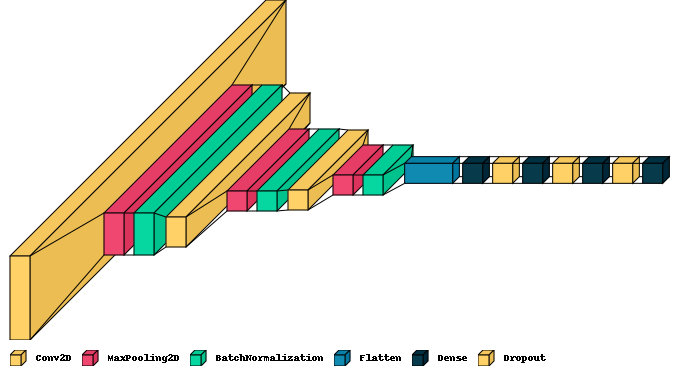

In [57]:
visualkeras.layered_view(model_cnn, legend=True,scale_xy=6)

## Model Training

The loss function for our model is the sparse categorical crossentropy, which is a variant of th categorical cross-entroyp. It is used in cases where the labels are represented as integers instead of one-hot encoded vectors. The predicted output of the model is a probability distribution over the total number of classes, which in this case is 10. The formula for sparse categorical cross-entropy is the following: $H(y, \hat{y}) = -\sum_{i=1}^n y_i \log(\hat{y}_i)$. 

Here $y$ is the true label value of the data and $\hat{y}$ is the predicted probability distribution. $n$ represented the total number of clases and $\hat{y}_i$ is the predicted probability of the $i^{th}$ class. The value of $y_i$ is 1 if $i$ is equal to the true label, meaning the model has correctly identified the song, and 0 otherwise. THe loss is calculated by summing over all the classes and taking the negative log of the predicted probability of the true label. The answer to this shows the differnce beetween the true and predicted probability distribution. The model thus tries to reduce the difference between the predicted value on the actual value of 1.

The optimizer used for the model is Adam, which is an adaptive optimization algorithm for stochastic gradient descent. The optimizer users a moving average of the gradient and the squared gradient to adaptively adjust the learning rate for each parameter. 

The metrics that would be used to test the efficency of the model are the following:
 - Precision: It is the ratio of true positives to the total number of predicted positives. In other words, precision measures the proportion of positive predictions that are actually correct. Mathematically we say, precision = true positives / (true positives + false positives).
 <br>
 
 - Recall: It is the ratio of true positives to the total number of actual positives. In other words, recall measures the proportion of actual positives that are correctly identified by the model. Mathematically we say, recall = true positives / (true positives + false negatives).
 
 
 - F1 value: F1 score is a harmonic mean of precision and recall, and provides a single measure of a model's overall performance. The F1 score is often used in classification tasks where we want to balance the trade-off between precision and recall. Mathematically we can say, F1 = 2 * (precision * recall) / (precision + recall).
 
 
 - Accuracy: It is the ratio of the number of correct predictions to the total number of predictions made by the model. Mathematically we can say, accuracy = (true positives + true negatives) / (true positives + true negatives + false positives + false negatives).


In [58]:
from sklearn.metrics import f1_score

optimiser = keras.optimizers.Adam(learning_rate=0.0001)

def trainmodel(model,epoch,optimizer):
    model.compile(loss='sparse_categorical_crossentropy',optimizer=optimizer,metrics=['accuracy'])
    history = model.fit(X_train, y_train, epochs=epoch, validation_data=(X_test, y_test))
    predictions = model.predict(X_test)
    f1 = f1_score(y_test, np.argmax(predictions, axis=1), average='weighted')
    return history ,f1
    
#This function plots the accuracy and loss of the model

def plotvalidate(history,f1):
    print("Validation accuracy: ",max(history.history['val_accuracy']))
    print("Training accuracy: ",max(history.history['accuracy']))
    plt.plot(history.history['accuracy'])
    plt.plot(history.history['val_accuracy'])
    plt.title('model accuracy')
    plt.ylabel('accuracy')
    plt.xlabel('epoch')
    plt.legend(['train', 'test'], loc='upper left')
    plt.show()

Epoch 1/100
397/397 [==============================] - 15s 35ms/step - loss: 2.2140 - accuracy: 0.2038 - val_loss: 1.9944 - val_accuracy: 0.2995
Epoch 2/100
397/397 [==============================] - 15s 37ms/step - loss: 2.0305 - accuracy: 0.2625 - val_loss: 1.8421 - val_accuracy: 0.3513
Epoch 3/100
397/397 [==============================] - 15s 39ms/step - loss: 1.8915 - accuracy: 0.3139 - val_loss: 1.7341 - val_accuracy: 0.3848
Epoch 4/100
397/397 [==============================] - 17s 43ms/step - loss: 1.8006 - accuracy: 0.3462 - val_loss: 1.6259 - val_accuracy: 0.4147
Epoch 5/100
397/397 [==============================] - 15s 37ms/step - loss: 1.7290 - accuracy: 0.3732 - val_loss: 1.5831 - val_accuracy: 0.4508
Epoch 6/100
397/397 [==============================] - 15s 38ms/step - loss: 1.6650 - accuracy: 0.3971 - val_loss: 1.5395 - val_accuracy: 0.4599
Epoch 7/100
397/397 [==============================] - 15s 37ms/step - loss: 1.6078 - accuracy: 0.4177 - val_loss: 1.4903 - val_ac

397/397 [==============================] - 15s 39ms/step - loss: 0.6627 - accuracy: 0.7858 - val_loss: 1.2240 - val_accuracy: 0.6518
Epoch 58/100
397/397 [==============================] - 16s 39ms/step - loss: 0.6432 - accuracy: 0.7938 - val_loss: 1.1885 - val_accuracy: 0.6579
Epoch 59/100
397/397 [==============================] - 15s 38ms/step - loss: 0.6381 - accuracy: 0.7946 - val_loss: 1.2281 - val_accuracy: 0.6635
Epoch 60/100
397/397 [==============================] - 15s 38ms/step - loss: 0.6350 - accuracy: 0.7939 - val_loss: 1.2156 - val_accuracy: 0.6523
Epoch 61/100
397/397 [==============================] - 15s 38ms/step - loss: 0.6146 - accuracy: 0.7991 - val_loss: 1.1637 - val_accuracy: 0.6726
Epoch 62/100
397/397 [==============================] - 18s 46ms/step - loss: 0.6036 - accuracy: 0.8043 - val_loss: 1.2466 - val_accuracy: 0.6711
Epoch 63/100
397/397 [==============================] - 18s 46ms/step - loss: 0.6010 - accuracy: 0.8054 - val_loss: 1.2450 - val_accuracy

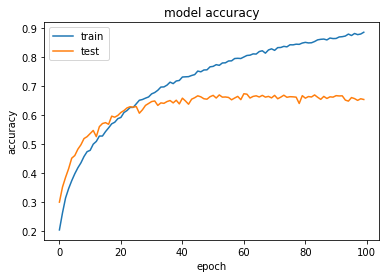

In [60]:
history, f1 = trainmodel(model_cnn,100,optimiser)

test_loss, test_acc = model_cnn.evaluate(X_test, y_test, verbose=2)
y_pred = model_cnn.predict(X_test)
acc = accuracy_score(y_test, np.argmax(y_pred, axis=1))
f1 = f1_score(y_test, np.argmax(y_pred, axis=1), average='weighted')
recall = recall_score(y_test, np.argmax(y_pred, axis=1), average='weighted')
precision = precision_score(y_test, np.argmax(y_pred, axis=1), average='weighted')
print("Precision value", precision)
print("Recall value:", recall)
print("F1 value:", f1)
print("Accuracy value:", acc)

plotvalidate(history , f1)

## Evaluation 

From the model above, we can see that the values of all the metrics are almost 65%. This is not too good and further improvements can be made.

The model accuracy means that 65% of the time the model correctly identified the classes, out of all the instances.

The recall shows that 65% of the time the model correctly predicted positive classes out of all the instances that truly belonged to the positive class. 

Furthermore, the precision, means that out of all the instances the model predicted as positive 64% of them were actually positive. Finally, the F1 value is comparitively a bit low, 64%, meaning that the model wasnt able to find a very good balance between precision and recall.

But the training accuracy of the model is high: 88.4%. This means that our model has definelty overfit to the data and thus regularization should be needed to reduce this overfitting.

## Confusion Matrix

The confusion matrix is a table that is used to evaluate the performance of a classification model. The confusion matrix consists of four different metrics:
   - True positive: The sample was correctly classified positive.
   - False positive: The sample was classified positive but it is negative.
   - True Negative: The sample was correctly classified as negative.
   - False Negative: The sample was classified negative but it is positive.
   
The color intensity of each box represents how effective the model was at making a correct prediction. For example if the box that intersects between the jazz genre is more yellow, it means that the model was correctly able to classify jazz music as jazz. Whereas, the intersection between jazz and metal is dark blue, telling us that there were almost no cases where the model labeled a jazz song as metal. 


Looking at the matrix we can say that in most cases, the model was accuratley able to predict the specific music genre.

In [65]:
import random
y_true_labels = []
y_pred_labels = []


for i in range(1000):
    
    random_number = random.randint(1, X_test.shape[0])
    
    X_to_predict = X_test[random_number]
    X_to_predict = X_to_predict[np.newaxis, ...]
    y_to_predict = y_test[random_number]
    
    
    y_true_labels.append(y_to_predict)
    
    prediction = model_cnn.predict(X_to_predict)
    predicted_index = np.argmax(prediction)
    
    y_pred_labels.append(predicted_index)

1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 26ms/step


1/1 [==============================] - 0s 19ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 28ms/step


1/1 [==============================] - 0s 18ms/step


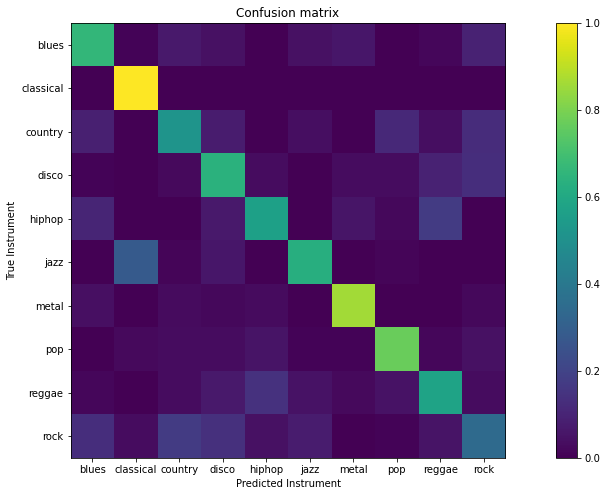

Precision: [0.6327586  0.74031485 0.57728813 0.55504696 0.65306403 0.74370855
 0.82167047 0.75594074 0.59403633 0.43527697]
Recall: [0.6637931  1.         0.51923077 0.63793103 0.56976744 0.62686567
 0.86138614 0.77192982 0.57983193 0.34408602]
F1 Score: [0.64790443 0.85078266 0.54672247 0.59360975 0.60857875 0.68030662
 0.84105971 0.76385162 0.58684819 0.3843465 ]


In [66]:
cm = confusion_matrix(y_true_labels, y_pred_labels,normalize='true')
fig, ax = plt.subplots(figsize=(18, 8))
plt.imshow(cm, interpolation='nearest')
plt.title('Confusion matrix')
plt.colorbar()
plt.xticks(np.arange(10),labels)
plt.yticks(np.arange(10),labels)
plt.xlabel('Predicted Instrument')
plt.ylabel('True Instrument')
plt.show()


precision = np.diag(cm) / np.sum(cm, axis=0)
recall = np.diag(cm) / np.sum(cm, axis=1)
f1_score = 2 * precision * recall / (precision + recall)
print("Precision:", precision)
print("Recall:", recall)
print("F1 Score:", f1_score)

## Discussion

## Adding L2 Regularization

 To prevent such overfitting, I introduced the L2 regularization also known as Ridge regularization. It is a technique that is used to prevent overfitting by adding a penalty term to the loss function of the model, that is propotional to the sum of the squares of the model's weight. The purpose of this penalty is to encourage the model to learn simpler weights that are closer to zero, rather than weights that are larger. The formula for this regularization is: Loss Function + $\lambda$ + $\sum ||w||^2$

Here $\lambda$ is the penalty term for the model: it determines the strength of the regularization. $w$ is the weight vector of the model and $||w||$ is the L2 norm of $w$: this is the square root of the sum of squares of the elements in the weight vector. The L2 regularization tries to shrink the weights of the model towards $0$, while still allowing the model to learn from the data. This solves the problem of overfitting as now some weights are not being dominant and more expressive in the model. The affect of the regularization can be seen by how the training accuracy and testing accuracy have moved closer.

In [69]:
# build the CNN


model_cnn = Sequential()

# 1st conv layer
model_cnn.add(keras.layers.Conv2D(32, (3, 3), activation='relu', input_shape=input_shape, kernel_regularizer=keras.regularizers.l2(0.001)))
model_cnn.add(keras.layers.MaxPooling2D((3, 3), strides=(2, 2), padding='same'))
model_cnn.add(keras.layers.BatchNormalization())

# 2nd conv layer
model_cnn.add(keras.layers.Conv2D(32, (3, 3), activation='relu', kernel_regularizer=keras.regularizers.l2(0.001)))
model_cnn.add(keras.layers.MaxPooling2D((3, 3), strides=(2, 2), padding='same'))
model_cnn.add(keras.layers.BatchNormalization())

# 3rd conv layer
model_cnn.add(keras.layers.Conv2D(32, (2, 2), activation='relu', kernel_regularizer=keras.regularizers.l2(0.001)))
model_cnn.add(keras.layers.MaxPooling2D((2, 2), strides=(2, 2), padding='same'))
model_cnn.add(keras.layers.BatchNormalization())

# flatten output and feed it into dense layer
model_cnn.add(keras.layers.Flatten())

#Dense layers
model_cnn.add(keras.layers.Dense(128, activation='relu', kernel_regularizer=keras.regularizers.l2(0.001)))
model_cnn.add(keras.layers.Dropout(0.3))

model_cnn.add(keras.layers.Dense(64, activation='relu', kernel_regularizer=keras.regularizers.l2(0.001)))
model_cnn.add(keras.layers.Dropout(0.3))

model_cnn.add(keras.layers.Dense(32, activation='relu', kernel_regularizer=keras.regularizers.l2(0.001)))
model_cnn.add(keras.layers.Dropout(0.3))

# output layer
model_cnn.add(keras.layers.Dense(10, activation='softmax'))

62/62 - 0s - loss: 1.8998 - accuracy: 0.6244 - 492ms/epoch - 8ms/step
62/62 [==============================] - 1s 9ms/step
Precision value 0.6229345671055919
Recall value: 0.6243654822335025
F1 value: 0.6473566912566207
Accuracy value: 0.6243654822335025
Validation accuracy:  0.6725888252258301
Training accuracy:  0.8842942714691162


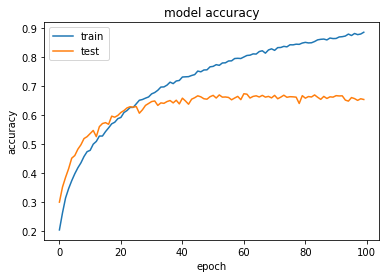

In [73]:
optimiser = keras.optimizers.Adam(learning_rate=0.0001)

# history, f1 = trainmodel(model_cnn,100,optimiser)

test_loss, test_acc = model_cnn.evaluate(X_test, y_test, verbose=2)
y_pred = model_cnn.predict(X_test)
acc = accuracy_score(y_test, np.argmax(y_pred, axis=1))
# f1 = f1_score(y_test, np.argmax(y_pred, axis=1), average='weighted')
recall = recall_score(y_test, np.argmax(y_pred, axis=1), average='weighted')
precision = precision_score(y_test, np.argmax(y_pred, axis=1), average='weighted')
print("Precision value", precision)
print("Recall value:", recall)
print("F1 value:", f1)
print("Accuracy value:", acc)

plotvalidate(history , f1)

## Evaluation

After applying regularization, we can see that the values of all the metrics are still the same, actually they might have decreased a bit to 62%, even though the accuracy is still the same. This made me realize that wheater the model architecture was too simple and thus it was unable to extract meaningful information to generalize on unseen data. For this reason I decided to increase the layers on the model and train it on the same data set.

## Confusion Matrix

In [74]:
y_true_labels = []
y_pred_labels = []


for i in range(1000):
    
    random_number = random.randint(1, X_test.shape[0])
    
    X_to_predict = X_test[random_number]
    X_to_predict = X_to_predict[np.newaxis, ...]
    y_to_predict = y_test[random_number]
    
    
    y_true_labels.append(y_to_predict)
    
    prediction = model_cnn.predict(X_to_predict)
    predicted_index = np.argmax(prediction)
    
    y_pred_labels.append(predicted_index)

1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 18ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 18ms/step


1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 18ms/step


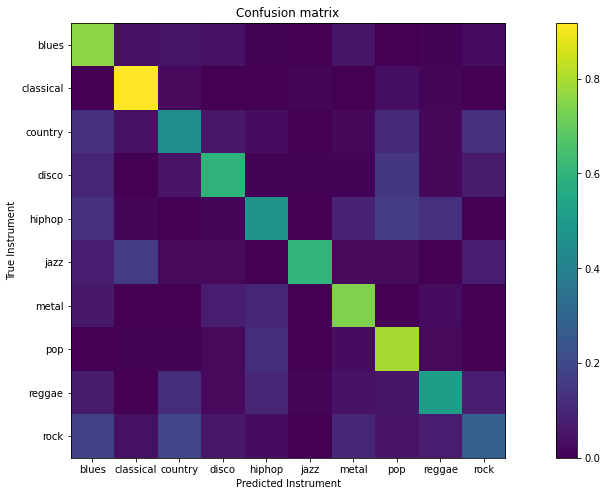

Precision: [0.51003711 0.74529855 0.49438791 0.64806929 0.5499815  0.94936471
 0.66839037 0.57907283 0.62612545 0.42762569]
Recall: [0.75757576 0.91764706 0.45454545 0.59615385 0.47368421 0.60465116
 0.73958333 0.79259259 0.51086957 0.28      ]
F1 Score: [0.60963684 0.82254166 0.47363026 0.62102848 0.50898951 0.73877556
 0.70218695 0.66921397 0.56265583 0.33841392]


In [75]:
cm = confusion_matrix(y_true_labels, y_pred_labels,normalize='true')
fig, ax = plt.subplots(figsize=(18, 8))
plt.imshow(cm, interpolation='nearest')
plt.title('Confusion matrix')
plt.colorbar()
plt.xticks(np.arange(10),labels)
plt.yticks(np.arange(10),labels)
plt.xlabel('Predicted Instrument')
plt.ylabel('True Instrument')
plt.show()


precision = np.diag(cm) / np.sum(cm, axis=0)
recall = np.diag(cm) / np.sum(cm, axis=1)
f1_score = 2 * precision * recall / (precision + recall)
print("Precision:", precision)
print("Recall:", recall)
print("F1 Score:", f1_score)

## Increasing Model Layers

As can be seen, in an effort to increase the robustness of the model, I tried to increase the overall size of the model, while keeping the number of layers the same. This was done by increasing the number of parameters or neurons in each layer. Now instead of having 86,000 the new model has 860,000 trainable paramerters. L2 regularization has already been applied in an effort to minimize overfitting.

The main reason for increasing the size of the model was to see if it would be able to capture new and interesting patterns for future identification processes.

In [81]:
model_cnn = Sequential()

# 1st conv layer
model_cnn.add(keras.layers.Conv2D(64, (3, 3), activation='relu', input_shape=input_shape, kernel_regularizer=keras.regularizers.l2(0.001)))
model_cnn.add(keras.layers.Conv2D(64, (3, 3), activation='relu', input_shape=input_shape, kernel_regularizer=keras.regularizers.l2(0.001)))
model_cnn.add(keras.layers.MaxPooling2D((3, 3), strides=(2, 2), padding='same'))
model_cnn.add(keras.layers.BatchNormalization())


# 2nd conv layer
model_cnn.add(keras.layers.Conv2D(128, (3, 3), activation='relu', kernel_regularizer=keras.regularizers.l2(0.001)))
model_cnn.add(keras.layers.Conv2D(128, (3, 3), activation='relu', kernel_regularizer=keras.regularizers.l2(0.001)))
model_cnn.add(keras.layers.MaxPooling2D((3, 3), strides=(2, 2), padding='same'))
model_cnn.add(keras.layers.BatchNormalization())

# 3rd conv layer
model_cnn.add(keras.layers.Conv2D(256, (1, 1), activation='relu', kernel_regularizer=keras.regularizers.l2(0.001)))
model_cnn.add(keras.layers.Conv2D(256, (1, 1), activation='relu', kernel_regularizer=keras.regularizers.l2(0.001)))
model_cnn.add(keras.layers.MaxPooling2D((3, 3), strides=(2, 2), padding='same'))
model_cnn.add(keras.layers.BatchNormalization())


# flatten output and feed it into dense layer
model_cnn.add(keras.layers.Flatten())

#Dense layers
model_cnn.add(keras.layers.Dense(128, activation='relu', kernel_regularizer=keras.regularizers.l2(0.001)))
model_cnn.add(keras.layers.Dropout(0.3))

model_cnn.add(keras.layers.Dense(64, activation='relu', kernel_regularizer=keras.regularizers.l2(0.001)))
model_cnn.add(keras.layers.Dropout(0.3))


model_cnn.add(keras.layers.Dense(32, activation='relu', kernel_regularizer=keras.regularizers.l2(0.001)))
model_cnn.add(keras.layers.Dropout(0.3))

# output layer
model_cnn.add(keras.layers.Dense(10, activation='softmax'))

In [82]:
model_cnn.summary()

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_18 (Conv2D)          (None, 128, 14, 64)       640       
                                                                 
 conv2d_19 (Conv2D)          (None, 126, 12, 64)       36928     
                                                                 
 max_pooling2d_15 (MaxPoolin  (None, 63, 6, 64)        0         
 g2D)                                                            
                                                                 
 batch_normalization_15 (Bat  (None, 63, 6, 64)        256       
 chNormalization)                                                
                                                                 
 conv2d_20 (Conv2D)          (None, 61, 4, 128)        73856     
                                                                 
 conv2d_21 (Conv2D)          (None, 59, 2, 128)       

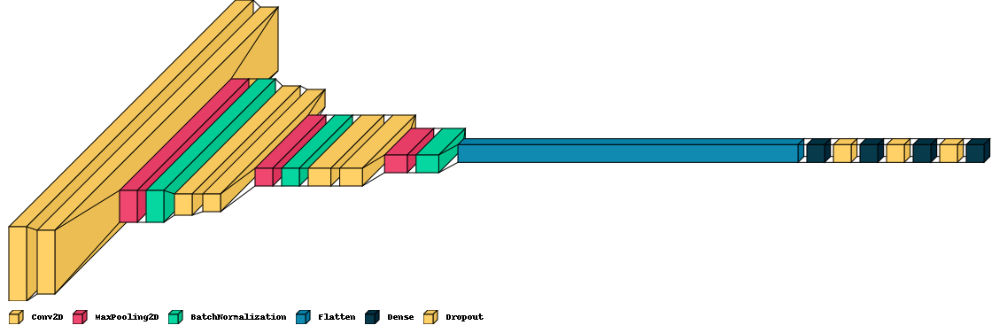

In [83]:
visualkeras.layered_view(model_cnn, legend=True,scale_xy=6)

In [87]:

X_train, y_train = load_data(training_data)

X_test, y_test = load_data(testing_data)

X_train, X_validation, y_train, y_validation = train_test_split(X_train, y_train, test_size=0.2)

# add an axis to input sets to convert it into a 4D- tensor
X_train = X_train[..., np.newaxis]
X_validation = X_validation[..., np.newaxis]
X_test = X_test[..., np.newaxis]

# (sample_size, height, width, number_of_channels)

input_shape = (X_train.shape[1], X_train.shape[2], 1)


Data succesfully loaded!
Data succesfully loaded!


62/62 - 2s - loss: 2.7011 - accuracy: 0.6482 - 2s/epoch - 35ms/step
62/62 [==============================] - 2s 35ms/step
Precision value 0.6568733695196594
Recall value: 0.6482233502538071
F1 value: 0.6473566912566207
Accuracy value: 0.6482233502538071
Validation accuracy:  0.6725888252258301
Training accuracy:  0.8842942714691162


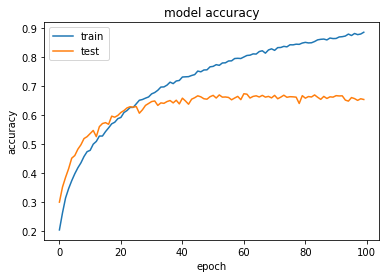

In [93]:

optimiser = keras.optimizers.Adam(learning_rate=0.0001)
# history, f1 = trainmodel(model_cnn,30,optimiser)

test_loss, test_acc = model_cnn.evaluate(X_test, y_test, verbose=2)
y_pred = model_cnn.predict(X_test)
acc = accuracy_score(y_test, np.argmax(y_pred, axis=1))
# f1 = f1_score(y_test, np.argmax(y_pred, axis=1), average='weighted')
recall = recall_score(y_test, np.argmax(y_pred, axis=1), average='weighted')
precision = precision_score(y_test, np.argmax(y_pred, axis=1), average='weighted')
print("Precision value", precision)
print("Recall value:", recall)
print("F1 value:", f1)
print("Accuracy value:", acc)

plotvalidate(history , f1)

## Discussion

Even after increasing the size of the model I got similar results, which is a bit dissapointing. What is interesting is that the training accuracy of my final model and the model implemented in the previous assignmnet is the same!!! Furthermore, the precision, recall, and F1 values of the previous model were also better than all the models I ran today: they were close to 72%. So it might be that the data augmentation step might be throwing off the model and causing it to capture irrelevent features, or rather the data augmentation might be changing the data so much that it doesnt reflect real-world differences.
I tried my previous theory as well, by randomizing the data augmentation process completely, meaning that random values would be used from a large range as the parameters for the augmentation fucntions. Doing that actually made the model worse because of the large variance that the data had.

## Confusion Matrix

In [97]:
y_true_labels = []
y_pred_labels = []


for i in range(1000):
    
    random_number = random.randint(1, X_test.shape[0])
    
    X_to_predict = X_test[random_number]
    X_to_predict = X_to_predict[np.newaxis, ...]
    y_to_predict = y_test[random_number]
    
    
    y_true_labels.append(y_to_predict)
    
    prediction = model_cnn.predict(X_to_predict)
    predicted_index = np.argmax(prediction)
    
    y_pred_labels.append(predicted_index)

1/1 [==============================] - 0s 20ms/step


1/1 [==============================] - 0s 19ms/step


1/1 [==============================] - 0s 20ms/step


1/1 [==============================] - 0s 19ms/step


1/1 [==============================] - 0s 22ms/step


1/1 [==============================] - 0s 20ms/step


1/1 [==============================] - 0s 19ms/step


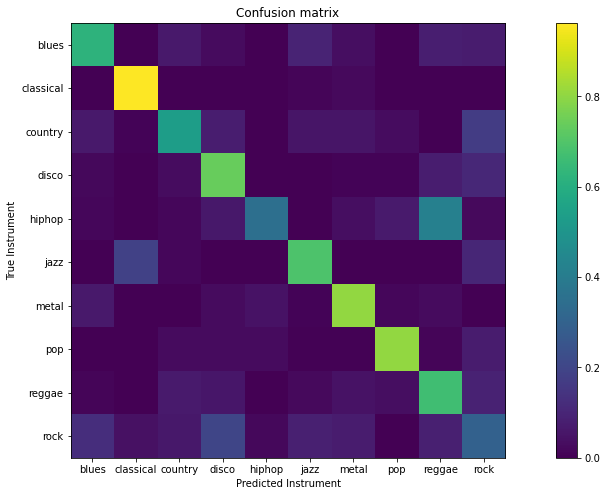

Precision: [0.66940682 0.80058453 0.64590141 0.60495474 0.78306869 0.70899364
 0.73609695 0.82920577 0.48618669 0.31517095]
Recall: [0.62318841 0.9625     0.53763441 0.73913043 0.35087719 0.69491525
 0.80555556 0.80740741 0.66666667 0.29787234]
F1 Score: [0.64547131 0.87410739 0.58681591 0.66534542 0.48461033 0.70188386
 0.76926154 0.81816142 0.56229955 0.30627758]


In [98]:
cm = confusion_matrix(y_true_labels, y_pred_labels,normalize='true')
fig, ax = plt.subplots(figsize=(18, 8))
plt.imshow(cm, interpolation='nearest')
plt.title('Confusion matrix')
plt.colorbar()
plt.xticks(np.arange(10),labels)
plt.yticks(np.arange(10),labels)
plt.xlabel('Predicted Instrument')
plt.ylabel('True Instrument')
plt.show()


precision = np.diag(cm) / np.sum(cm, axis=0)
recall = np.diag(cm) / np.sum(cm, axis=1)
f1_score = 2 * precision * recall / (precision + recall)
print("Precision:", precision)
print("Recall:", recall)
print("F1 Score:", f1_score)

## Executive Summary


For this assignment, I implemented a Convolutional Neural Network which would be used to classify music genres. The training data was the GTZAN music dataset which contained 10 music genres, each contaiing 100 samples. Each sample was 30 seconds long.

First a pie chart was created to identify the class imbalances. All the data was equally distributed thus no pre-processing was needed at this stage. Next, the audio samples were visualized and the process of data conversion was discussed. From the audio data Mel-frequency cepstrum coeffecient values were extracted from each file. 

After this the data was divided into three section: the training, test, and validation set. The CNN model was then described and constructed. The model was trained on the pre-processed data and the final model was evaluatied on the following metrics: recall, accuracy, F1 score, and precision.

After this the model was tested on personal data, the was evaluated using the same metrics. Finally improvements were discussed to make the model more accurate and robust to new daata.

## Citation

Most of my work was influenced by the following Youtube channel. It provided numerous examples and detailed lectures on how audio data can be represented for machine learning, and what steps can be taken for data pre-processing. 
- https://www.youtube.com/@ValerioVelardoTheSoundofAI


- Team, T. A. I. (2022, March 24). Deep learning simplified: Feel and talk like an expert in neural... Towards AI. Retrieved March 27, 2023, from https://towardsai.net/p/deep-learning/deep-learning-simplified-feel-and-talk-like-an-expert-in-neural-networks 
